In [1]:
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb

import os
import re # regexp
import itertools

import scprep
import scanpy as sc
import scvi
import graphtools as gt
import leidenalg as louvain
import magic
import umap
import anndata
import sklearn

#plt.rcParams['figure.figsize']=(6,6) #rescale figures
#import warnings
#warnings.simplefilter(action='ignore', category=FutureWarning)

c:\Users\chbohan\AppData\Local\anaconda3\envs\scRNAseq-3\Lib\site-packages\scvi\_settings.py:63: UserWarning: Since v1.0.0, scvi-tools no longer uses a random seed by default. Run `scvi.settings.seed = 0` to reproduce results from previous versions.
  self.seed = seed
c:\Users\chbohan\AppData\Local\anaconda3\envs\scRNAseq-3\Lib\site-packages\scvi\_settings.py:70: UserWarning: Setting `dl_pin_memory_gpu_training` is deprecated in v1.0 and will be removed in v1.1. Please pass in `pin_memory` to the data loaders instead.
  self.dl_pin_memory_gpu_training = (


In [4]:
scseqDir = r'C:\Users\chbohan\Documents\231114_backup\Documents\Bohan_Research\data\scRNA-seq\96hMP_rebuttal\forpaper'
dataDir = scseqDir #+ '240205_scRNAseq_0_48_72_96h_9704-BC/';
sc.settings.figdir = dataDir

## Load and filter d2-d4 gastruloid data

In [ ]:
# data location
dataDir = scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/per_sample_outs/'
countMatrixFiles = [#dataDir + '9704-BC-1/count/sample_raw_feature_bc_matrix.h5',
                    dataDir + '9704-BC-2/count/sample_raw_feature_bc_matrix.h5',
                    dataDir + '9704-BC-3/count/sample_raw_feature_bc_matrix.h5',
                    dataDir + '9704-BC-4/count/sample_raw_feature_bc_matrix.h5'];
    
conditions = ['48h','72h','96h']#'0h',

In [ ]:
# load data in sparse format
data = {};
for i in range(1,len(conditions)+1) :
    with tasklogger.log_task("sparse"):
        data[conditions[i-1]] = scprep.io.load_10X_HDF5(countMatrixFiles[i-1],
                                        sparse=True, gene_labels='both')

    # measure the size of the matrix with pickle
    print("Size: {:.1f}MB".format(len(pickle.dumps(data)) / 1024**2))

Calculating sparse...
Calculated sparse in 19.78 seconds.
Size: 1631.2MB
Calculating sparse...
Calculated sparse in 16.35 seconds.
Size: 3074.5MB
Calculating sparse...
Calculated sparse in 10.37 seconds.
Size: 4277.9MB


In [ ]:
for key in data :
    print(data[key].shape)

(716962, 37143)
(709554, 37143)
(703670, 37143)


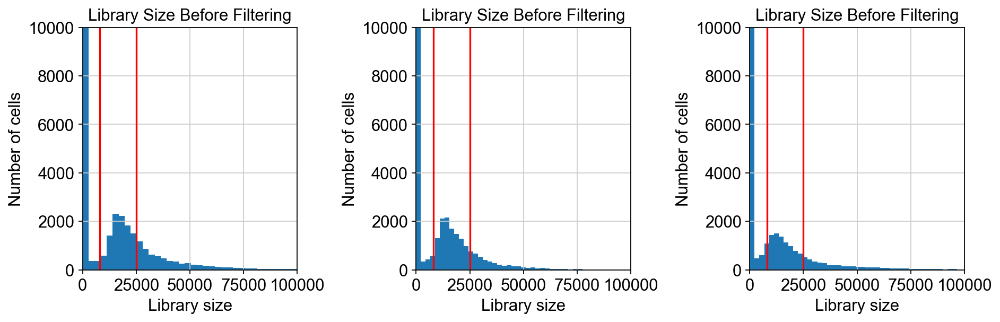

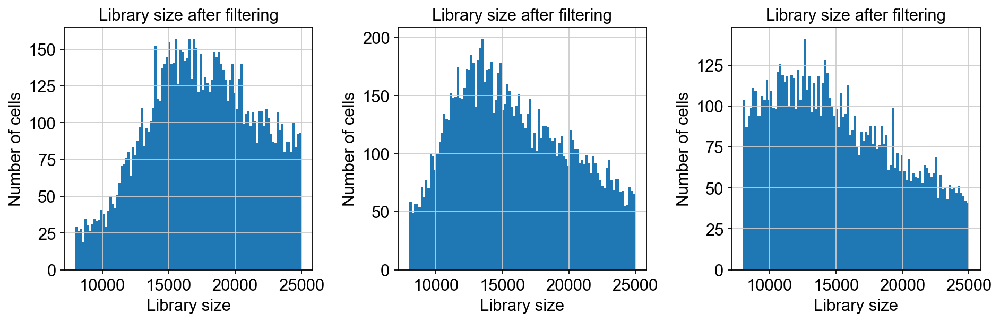

In [ ]:
minls = 8000;
maxls = 25000;
libcutoffs = [(minls,maxls),(minls,maxls),(minls,maxls)] #(minls,50000),

fig, axes = plt.subplots(1,len(conditions), figsize=(len(conditions)*4,4))
# This makes it easier to iterate through the axes
axes = axes.flatten()

for i, ax in enumerate(axes):

    scprep.plot.plot_library_size(data[conditions[i]], cutoff=libcutoffs[i], log=False, title='Library Size Before Filtering', ax=ax);
    ax.set_xlim([0, 100000])
    ax.set_ylim([0, 10000])

fig.tight_layout()

fig, axes = plt.subplots(1,len(conditions), figsize=(4*len(conditions),4))
# This makes it easier to iterate through the axes
axes = axes.flatten()
for i, ax in enumerate(axes):

    scprep.plot.plot_library_size(data[conditions[i]], log=False, range=libcutoffs[i], title='Library size after filtering',ax=ax);

fig.tight_layout()    

In [ ]:
data_filt = {};
for i in range(0,len(conditions)) :
    data_filt[conditions[i]] = scprep.filter.filter_library_size(data[conditions[i]], cutoff=libcutoffs[i], keep_cells='between');
    print(data_filt[conditions[i]].shape)

(9853, 37143)
(11505, 37143)
(8481, 37143)


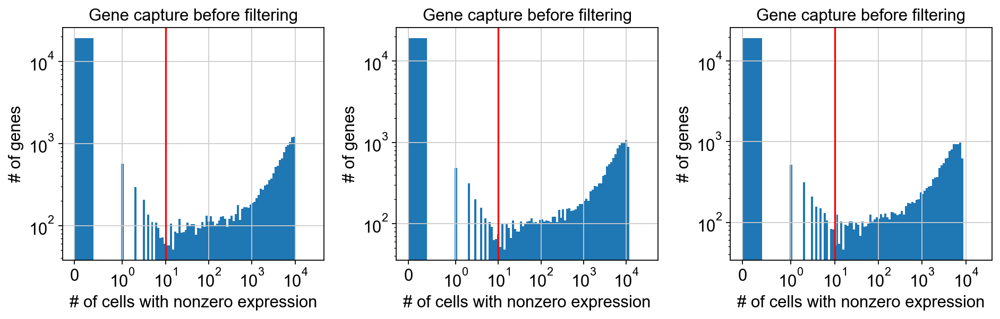

In [ ]:
fig, axes = plt.subplots(1,len(conditions), figsize=(4*len(conditions),4))
# This makes it easier to iterate through the axes
axes = axes.flatten()
for i, ax in enumerate(axes):
    scprep.plot.histogram(scprep.measure.gene_capture_count(data_filt[conditions[i]]), log=True, cutoff=10,
                      title="Gene capture before filtering",
                     xlabel='# of cells with nonzero expression',
                     ylabel='# of genes',ax=ax);
fig.tight_layout() 

In [ ]:
data_filt_tmp = {};
for i in range(0,len(conditions)) :
    data_filt_tmp[conditions[i]] = scprep.filter.filter_rare_genes(data_filt[conditions[i]], min_cells=10)
    print(data_filt_tmp[conditions[i]].shape)
    
cols = [];
for i in range(0,len(conditions)) :
    cols = np.union1d(cols, data_filt_tmp[conditions[i]].columns);
cols.shape

for i in range(0,len(conditions)) :
    data_filt[conditions[i]] = data_filt[conditions[i]][cols]
    print(data_filt[conditions[i]][cols].shape)

(9853, 16252)
(11505, 16358)
(8481, 16110)
(9853, 16624)
(11505, 16624)
(8481, 16624)


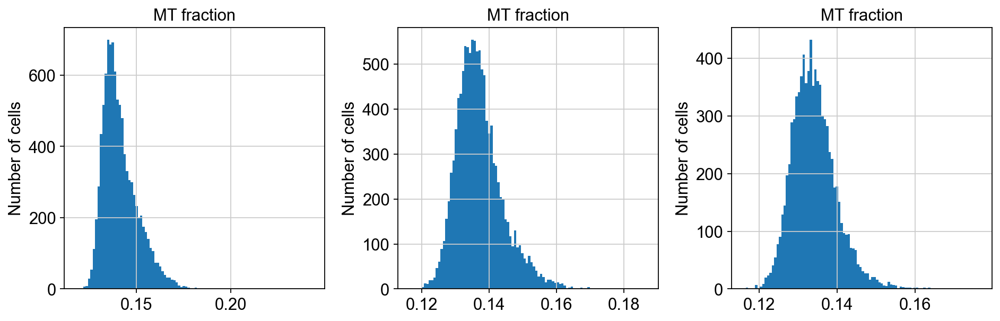

In [ ]:
# check mitochondrial fraction 
fig, axes = plt.subplots(1,len(conditions), figsize=(4*len(conditions),4))
axes = axes.flatten()
mt_frac = {};
for i, ax in enumerate(axes):
    mt_expr = get_genes_expression(data_filt[conditions[i]], 'MT-')  
    libsize = np.sum(data_filt[conditions[i]], axis=1)
    mt_frac[i] = mt_expr/libsize
    scprep.plot.histogram(mt_frac[i], title='MT fraction',ax=ax);
fig.tight_layout() 

In [ ]:
for i in range(0,len(conditions)):
    data_filt[conditions[i]] = data_filt[conditions[i]][mt_frac[i]<0.2];

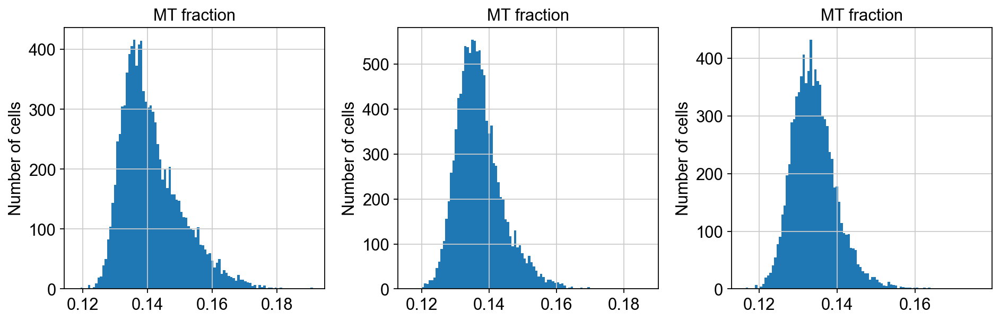

In [ ]:
# check mitochondrial fraction again
fig, axes = plt.subplots(1,len(conditions), figsize=(4*len(conditions),4))
axes = axes.flatten()
mt_frac = {};
for i, ax in enumerate(axes):
    mt_expr = get_genes_expression(data_filt[conditions[i]], 'MT-')  
    libsize = np.sum(data_filt[conditions[i]], axis=1)
    mt_frac[i] = mt_expr/libsize
    scprep.plot.histogram(mt_frac[i], title='MT fraction',ax=ax);
fig.tight_layout() 

In [ ]:
filtered_batches = []
for key in data_filt:
    filtered_batches.append(data_filt[key])

In [ ]:
data_combined, sample_labels = scprep.utils.combine_batches(filtered_batches, conditions)
del filtered_batches # removes objects from memory

In [ ]:
data_combined.shape

(30840, 16638)

In [ ]:
data_combined.shape

(29836, 16624)

In [ ]:
adata_combined = anndata.AnnData(X=data_combined)
adata_combined.obs['sample_labels'] = sample_labels;

/var/folders/dx/s5b9sw5n7hs6rpnq97z8qvp80000gn/T/ipykernel_70930/2365217404.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_combined = anndata.AnnData(X=data_combined)


In [ ]:
adata_combined.layers["counts"] = adata_combined.X.copy() # preserve counts
sc.pp.normalize_total(adata_combined, target_sum=1e4, key_added='total_counts')
sc.pp.log1p(adata_combined)
adata_combined.raw = adata_combined # freeze the state in `.raw`

In [ ]:
adata_combined.obs['total_counts']

AAACAAGCAACGACTAATCATGTG-1_48h    16288.0
AAACAAGCAGCAATTGATCATGTG-1_48h    13264.0
AAACAAGCATCAGGACATCATGTG-1_48h    14551.0
AAACAAGCATCCCTCTATCATGTG-1_48h    19118.0
AAACAAGCATTCATGCATCATGTG-1_48h    15152.0
                                   ...   
TTTGGCGGTTGCGGGAATTCGGTT-1_96h    21026.0
TTTGTGAGTGCGTACCATTCGGTT-1_96h     5916.0
TTTGTGAGTGTCCTTCATTCGGTT-1_96h    14884.0
TTTGTGAGTTCACTCCATTCGGTT-1_96h    13546.0
TTTGTGAGTTCCGTGAATTCGGTT-1_96h    19604.0
Name: total_counts, Length: 30840, dtype: float32

In [ ]:
# SAVE
adata_combined.write_h5ad(dataDir + 'adata_timeseries2024_487296_v2.h5ad')

In [ ]:
# LOAD
#adata_combined = sc.read_h5ad(dataDir + 'adata_timeseries2024_487296_v2.h5ad')

## Integrate gastruloid d2-d4 timeseries

In [ ]:
adata_combined_2024 = sc.read_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/adata_timeseries2024_487296_v2.h5ad')

In [ ]:
adata_combined_2021 = sc.read_h5ad(scseqDir + '211113_ESI_MP48_72_96h scRNA data/adata_timeseries2021_487296.h5ad');

In [ ]:
sharedvar = list(set(adata_combined_2024.var_names).intersection(set(adata_combined_2021.var_names)));
len(sharedvar)

16233

In [ ]:
adata_combined_2021.obs['sample_labels'] = [g + '-1' for g in adata_combined_2021.obs['sample_labels']]
adata_combined_2024.obs['sample_labels'] = [g + '-2' for g in adata_combined_2024.obs['sample_labels']]

In [ ]:
adata_all = anndata.concat([adata_combined_2024[:,sharedvar], adata_combined_2021[:,sharedvar]])
adata_all

AnnData object with n_obs × n_vars = 46508 × 16233
    obs: 'sample_labels'
    layers: 'counts'

In [ ]:
sc.pp.highly_variable_genes(
    adata_all,
    n_top_genes=1000,
    subset=True,
    layer="counts",
    flavor="seurat_v3",
)

In [ ]:
# load cell cycle genes
cc_genes_file = scseqDir + 'Macosko_cell_cycle_genes.txt'
cc_genes = pd.read_table(cc_genes_file, delimiter='\t')
s_genes = cc_genes['S'].dropna()
g2m_genes = cc_genes['G2.M'].dropna()
m_genes = cc_genes['M'].dropna()
mg1_genes = cc_genes['M.G1'].dropna()

nuisance_genes = [g for g in adata_all.var_names if g.split()[0] in set(list(s_genes)+list(m_genes)+list(g2m_genes))]

In [ ]:
len(nuisance_genes)

37

In [ ]:
adata_all.raw.X.shape

(46508, 16233)

In [ ]:
gene_subset = [g for g in adata_all.var_names if g not in nuisance_genes]
adata_all_cc = adata_all.copy();
adata_all_cc = adata_all_cc[:,gene_subset].copy()
adata_all_cc.obs = pd.concat([adata_all.obs, adata_all[:,nuisance_genes].to_df()],axis=1);

In [ ]:
import scvi
scvi.model.SCVI.setup_anndata(adata_all_cc, layer="counts", batch_key="sample_labels", continuous_covariate_keys=nuisance_genes)

In [ ]:
vae = scvi.model.SCVI(adata_all_cc, n_layers=2, n_latent=30, gene_likelihood="nb")
vae.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


Epoch 172/172: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 172/172 [25:54<00:00,  9.04s/it, loss=812, v_num=1]


In [ ]:
# save the reference model
# dir_path = "240306_alltimeseries_cc_scvi_model_487296_hvg1000"
# vae.save(dir_path, overwrite=True)

In [ ]:
adata_all_cc.obsm["X_scVI_cc"] = vae.get_latent_representation()

In [ ]:
adata_all_cc.layers['normalized_cc'] = vae.get_normalized_expression()

In [ ]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_all_cc, use_rep="X_scVI_cc")
sc.tl.umap(adata_all_cc, min_dist=0.1) 

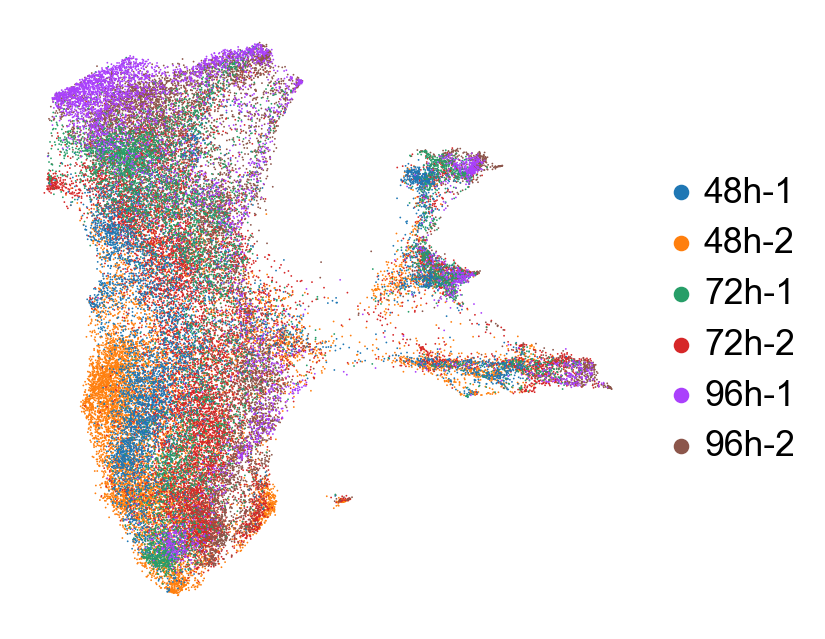

In [ ]:
sc.set_figure_params(figsize=[5,5])
sc.pl.umap(
    adata_all_cc,
    color=["sample_labels"],
    frameon=False,
    title=[""],
    ncols=5,
    legend_fontsize=16,
#    save='_gastruloid_all_sample_labels_v2.png'
)

In [ ]:
Nclusters = len(np.unique(adata_all_cc.obs['leiden']));
mypalette = sb.color_palette('tab10', Nclusters);
sc.set_figure_params(figsize=[5,5])

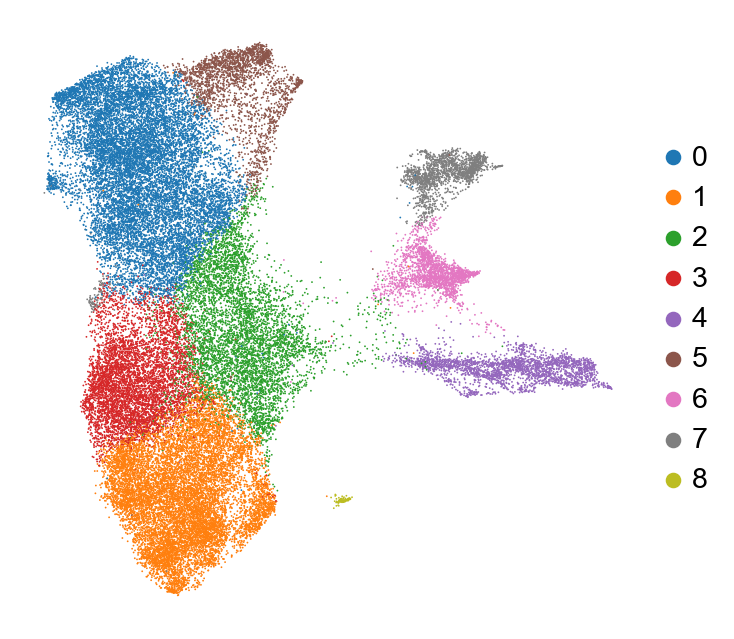

In [ ]:
sc.tl.leiden(adata_all_cc, resolution=0.5, random_state=8)
sc.pl.umap(
    adata_all_cc,
    color=["leiden"],
    title=[""],
    palette=mypalette,
    frameon=False,
    ncols=5,
    #save='_gastruloid_all_leiden_v2.png'
)

In [ ]:
#adata_all_cc.write_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/adata_timeseries_all_cc_hvg1000_leiden05_8_v2.h5ad');

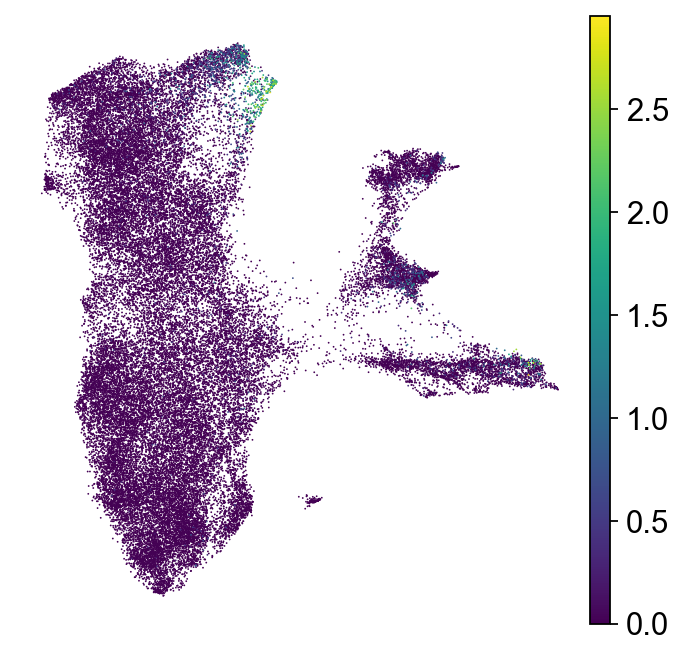

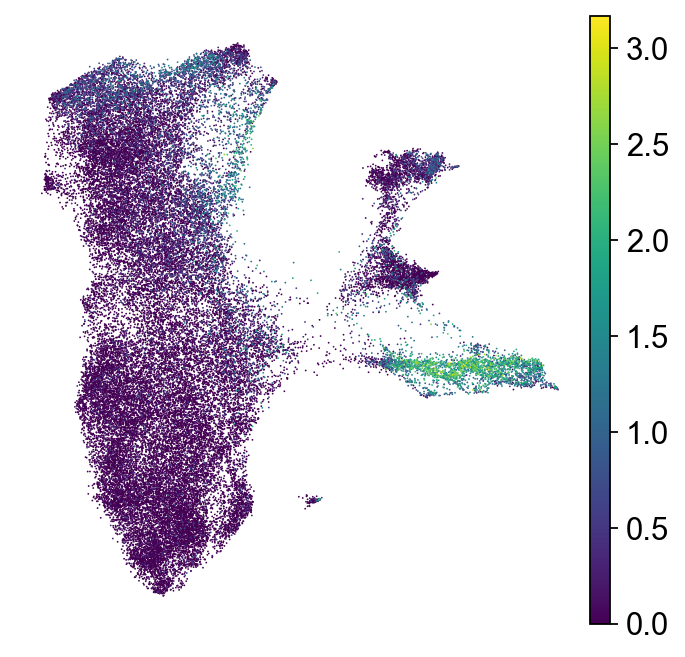

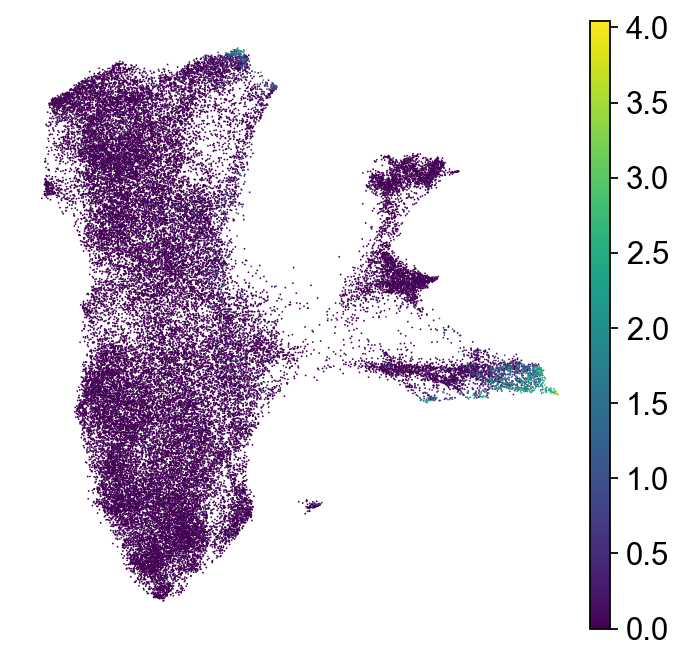

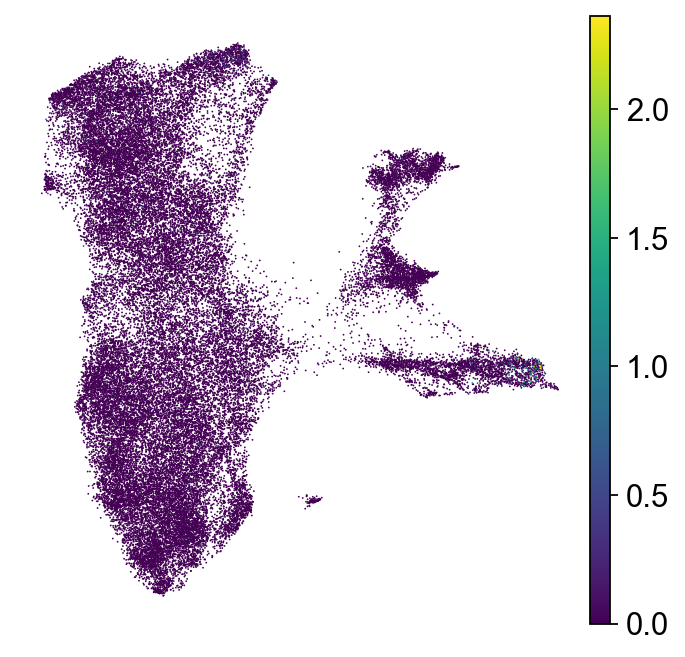

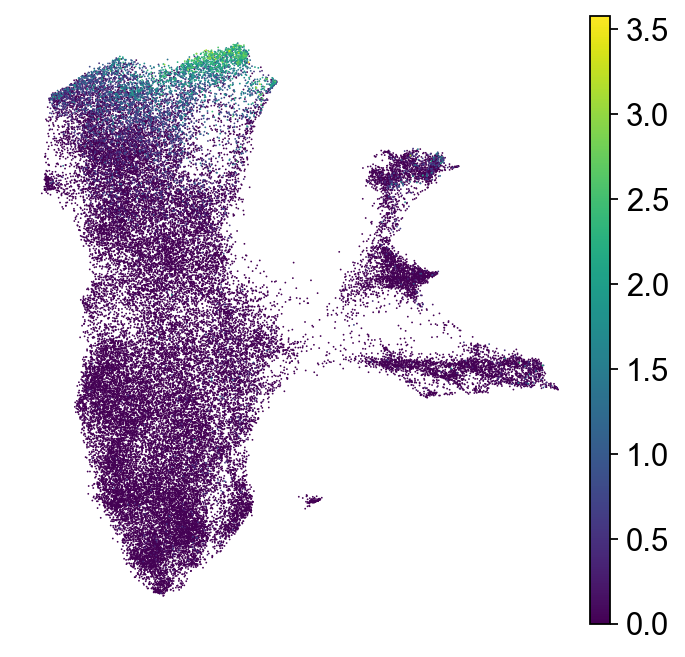

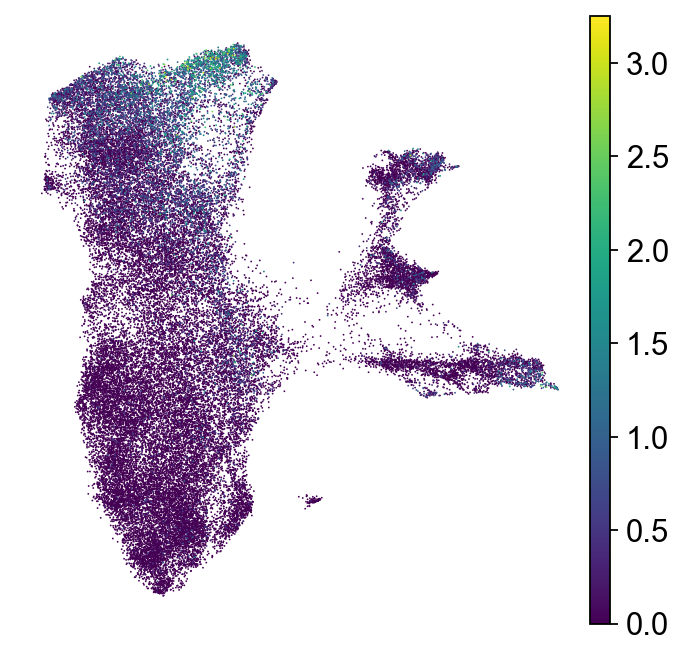

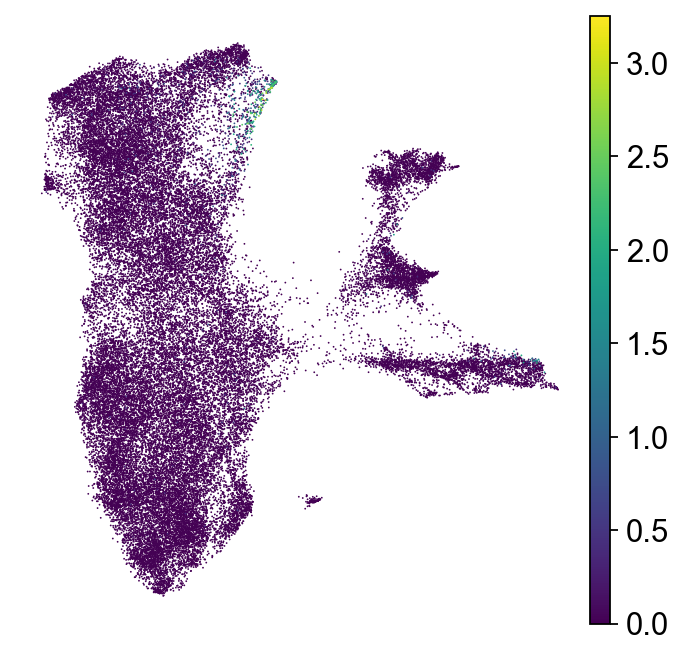

In [ ]:
mygenes = ["PITX1","ISL1","ANXA1","DCN","MYL4","MYL7","TBX4"];

sc.set_figure_params(figsize=[5,5])
for i in range(0,len(mygenes)):
    mygenes_fullname = [g for g in adata_all_cc.raw.var_names if g.split()[0] in mygenes[i]];
    sc.pl.embedding(
        adata_all_cc,
        use_raw=True,
        basis='X_umap',
        color=[mygenes_fullname[0]],
        frameon=False,
        title=[""],
        ncols=2,
        save='gastruloid_'+ mygenes[i] +'.png'
    )

### MAGIC to clean up

In [ ]:
#adata_all_cc = sc.read_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/adata_timeseries_all_cc_hvg1000_leiden05_8_v2.h5ad');

In [ ]:
data_all_cc = pd.DataFrame(adata_all_cc.raw.X.todense(), index=adata_all_cc.obs.index, columns=adata_all_cc.raw.var_names);

In [ ]:
data_all_cc_magic = magic.MAGIC(knn=5,t=1).fit_transform(data_all_cc)

Calculating MAGIC...
  Running MAGIC on 46508 cells and 16233 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 16.20 seconds.
    Calculating KNN search...
    Calculated KNN search in 255.59 seconds.
    Calculating affinities...
    Calculated affinities in 248.78 seconds.
  Calculated graph and diffusion operator in 522.15 seconds.
  Running MAGIC with `solver='exact'` on 16233-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...
  Calculated imputation in 19.92 seconds.
Calculated MAGIC in 543.58 seconds.


In [ ]:
adata_all_cc_magic = anndata.AnnData(data_all_cc_magic)
adata_all_cc_magic.obs = adata_all_cc.obs;
adata_all_cc_magic.obsm = adata_all_cc.obsm;

/var/folders/dx/s5b9sw5n7hs6rpnq97z8qvp80000gn/T/ipykernel_24330/2755517863.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_all_cc_magic = anndata.AnnData(data_all_cc_magic)


In [ ]:
adata_all_cc_magic.obs.drop(columns=nuisance_genes,inplace=True)

In [ ]:
adata_all_cc_magic.write_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/adata_timeseries_all_cc_hvg1000_magic.h5ad')

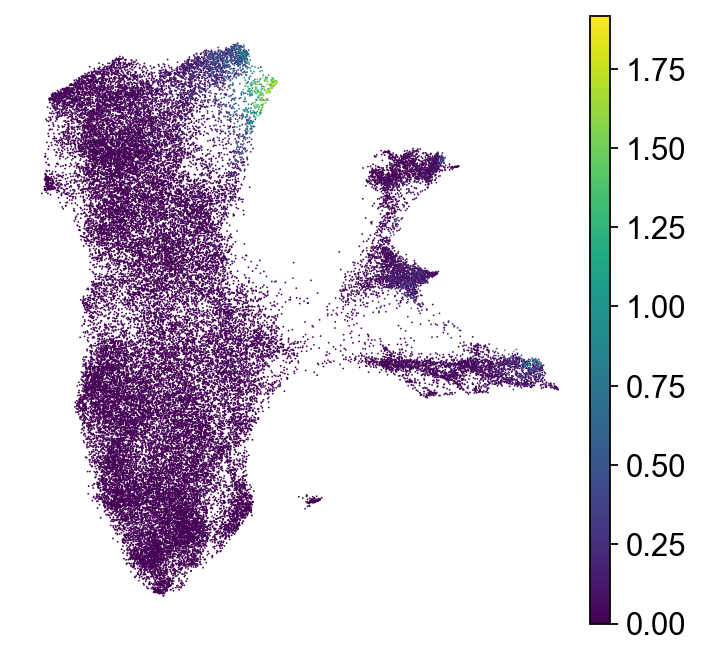

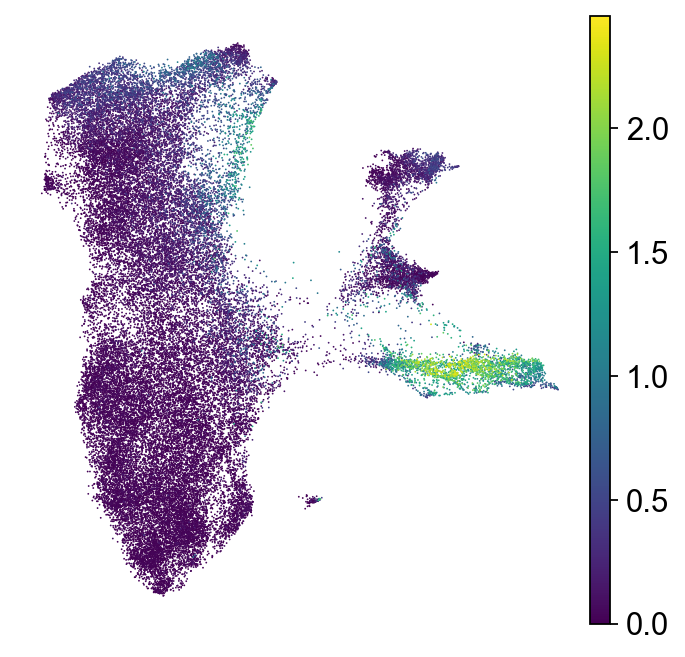

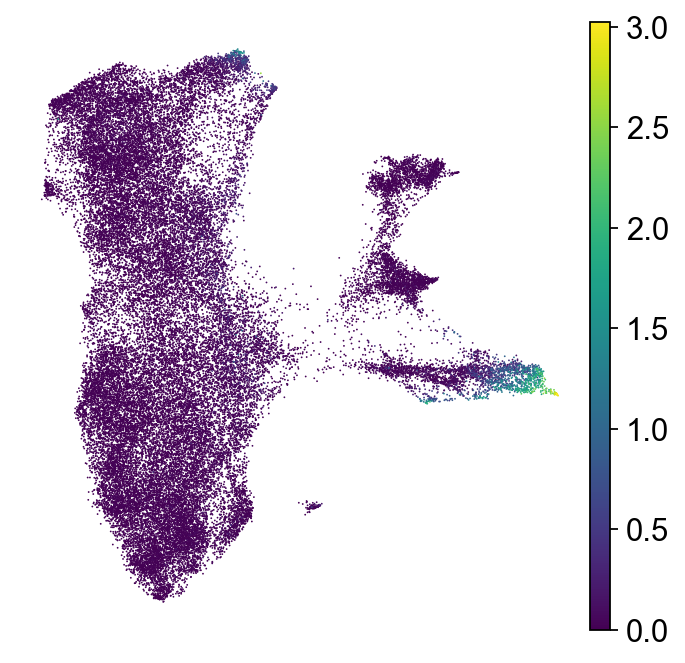

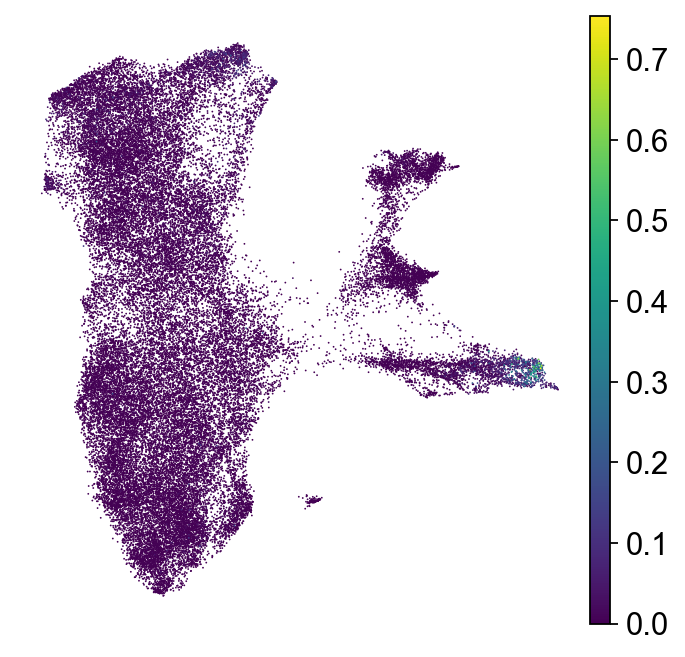

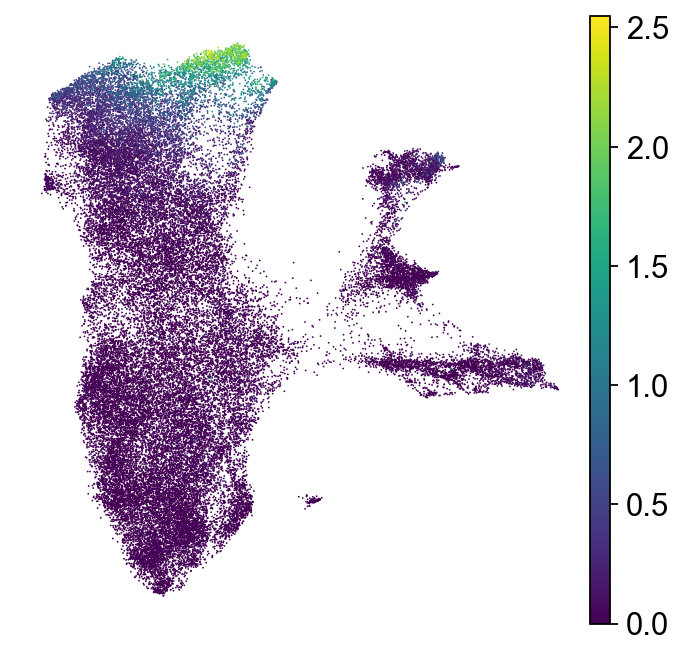

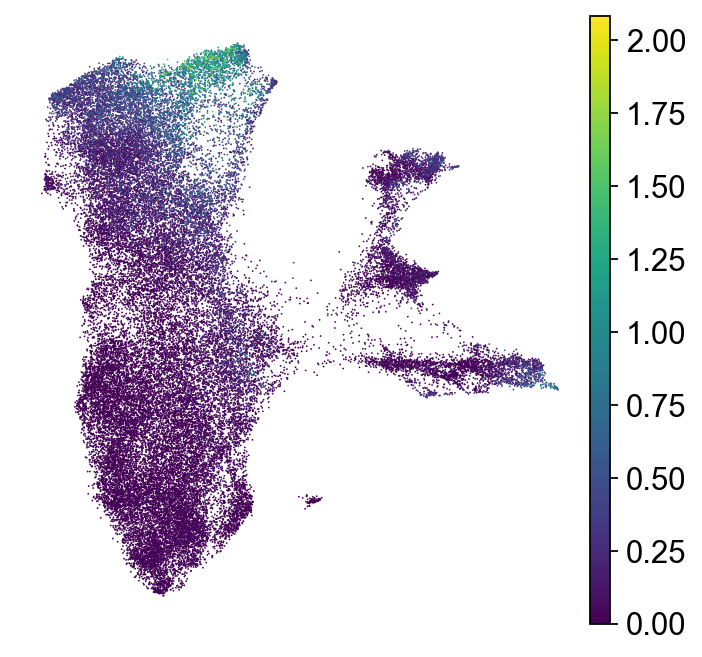

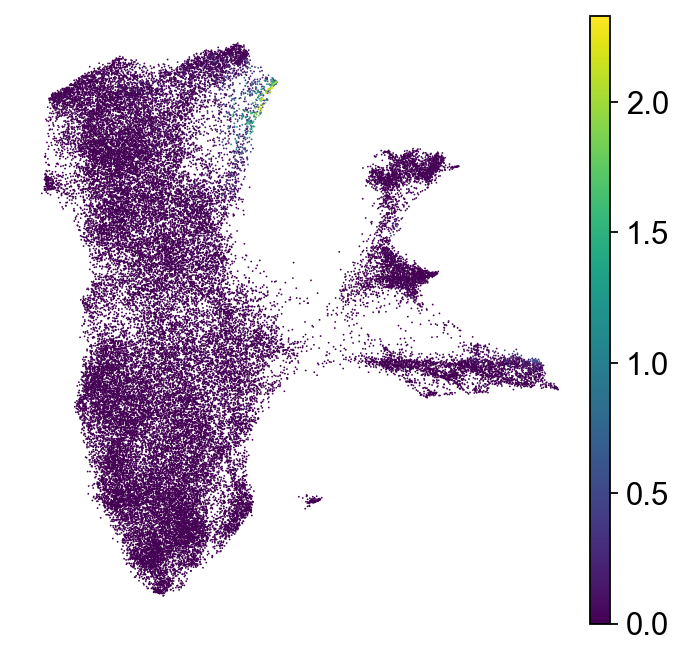

In [ ]:
mygenes = ["PITX1","ISL1","ANXA1","DCN","MYL4","MYL7","TBX4"];

sc.set_figure_params(figsize=[5,5])
for i in range(0,len(mygenes)):
    
    mygenes_fullname = [g for g in adata_all_cc.raw.var_names if g.split()[0] in mygenes[i]];
    sc.pl.embedding(
        adata_all_cc_magic,
        use_raw=False,
        basis='X_umap',
        color=[mygenes_fullname[0]],
        frameon=False,
        title=[""],
        ncols=2,
        save='gastruloid_'+ mygenes[i] +'_magic.png'
    )

## Gastruloid d2-d4 clustering and gene expression

In [51]:
adata_all_cc = sc.read_h5ad(dataDir + '/adata_timeseries_all_cc_hvg1000_leiden05_8_v2.h5ad');
#clusterlabels = ['NasMe','pluripotent','PPS-LC','APS-LC','AE-LC','AdvMe','PGC-LC','DE','stressed'];
#adata_all_cc.rename_categories('leiden', clusterlabels)

#clusterlabels = ['meso1','pluripotent','pPS-LC','aPS-LC','AE-LC','meso2','PGC-LC','DE','stressed'];
#adata_all_cc.rename_categories('leiden', clusterlabels)

In [ ]:
mypalette = sb.color_palette('tab20', 20).copy();
mypalette[3] = mypalette[18];

In [ ]:
mypalette_leiden = [mypalette[14],mypalette[10],mypalette[9],mypalette[1],mypalette[0],mypalette[16],mypalette[8],mypalette[4]]  

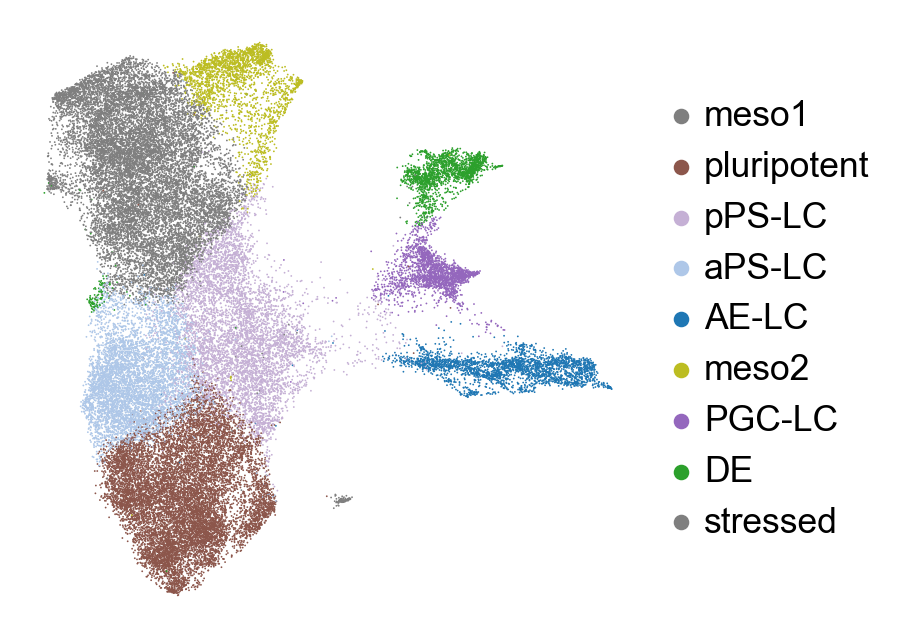

In [ ]:
sc.set_figure_params(figsize=[5,5])
sc.pl.umap(
    adata_all_cc,
    color=["leiden"],
    title=[""],
    palette=mypalette_leiden,#sb.color_palette('tab10', Nclusters),
    frameon=False,
    ncols=5,
    legend_fontsize=16,
    save='_gastruloid_all_leiden_v2.png'
)

In [ ]:
#adata_all_cc.write_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/240306_adata_timeseries_all_cc_hvg1000_leiden06_5.h5ad')

### Revision recluster

In [ ]:
#sc.pp.neighbors(adata_all_cc, use_rep="X_scVI_cc")
#sc.tl.leiden(adata_all_cc, resolution=0.4, use_weights=False, restrict_to=['leiden',['NasMe']],key_added='leiden_sub', random_state=0) # (0.7,0) 1,4
#sc.tl.leiden(adata_all_cc, resolution=0.2, restrict_to=['leiden_sub',['AdvMe']],key_added='leiden_sub', random_state=0) # (0.7,0) 1,4

In [52]:
mypalette = sb.color_palette('tab20', 20).copy();
mypalette[3] = mypalette[18];
mypalette = dict(zip(adata_all_cc.obs['leiden_sub'].cat.categories, mypalette[0:12]));

leiden_sub
AE-LC           2752
aPS-LC          5830
LPM-LC          1639
CS-LC            803
DE              1922
eNasM           6429
lNasM           5405
aPM-LC          1924
PGC-LC          2040
pPS-LC          5946
pluripotent    11727
stressed          90
Name: sample_labels, dtype: int64


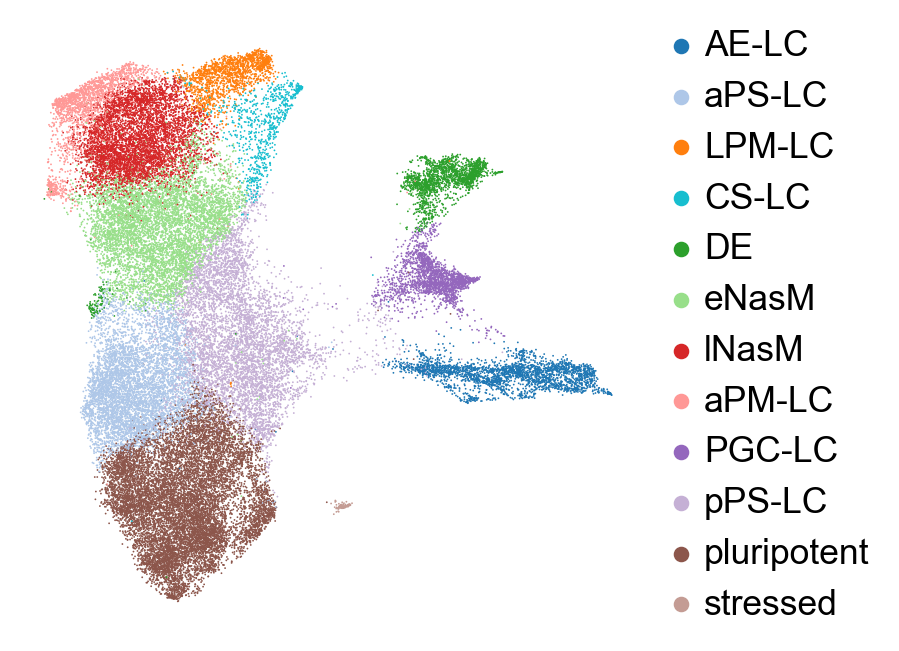

In [ ]:
#sc.tl.leiden(adata_all_cc, resolution=0.4, use_weights=False, restrict_to=['leiden',['NasMe']],key_added='leiden_sub', random_state=0) # (0.7,0) 1,4
#sc.tl.leiden(adata_all_cc, resolution=0.2, restrict_to=['leiden_sub',['AdvMe']],key_added='leiden_sub', random_state=0) # (0.7,0) 1,4
print(adata_all_cc.obs.groupby(['leiden_sub']).count()['sample_labels'])
sc.pl.umap(
    adata_all_cc,
    color=["leiden_sub"],
    frameon=False,
    ncols=5,
    title=[""],
    palette=mypalette,
    legend_fontsize=16,
    save='_gastruloid_all_leiden_sub.png',
)

In [ ]:
np.unique(adata_all_cc.obs['leiden_sub'])

array(['AE-LC', 'APS-LC', 'AdvMe,0', 'AdvMe,1', 'AdvMe,2', 'DE',
       'NasMe,0', 'NasMe,1', 'NasMe,2', 'PGC-LC', 'PPS-LC', 'pluripotent',
       'stressed'], dtype=object)

In [ ]:
# one cluster is only a single cell: remove it
# adata_all_cc = adata_all_cc[adata_all_cc.obs['leiden_sub']!='AdvMe,2'].copy();

In [ ]:
clusterlabels = ['AE-LC','aPS-LC','LPM-LC','CS-LC','DE','eNasM','lNasM','aPM-LC','PGC-LC','pPS-LC','pluripotent','stressed'];
adata_all_cc.rename_categories('leiden_sub', clusterlabels)

In [ ]:
#adata_all_cc.write_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/adata_timeseries_all_cc_hvg1000_leiden05_8_v2.h5ad');

### Marker genes full data

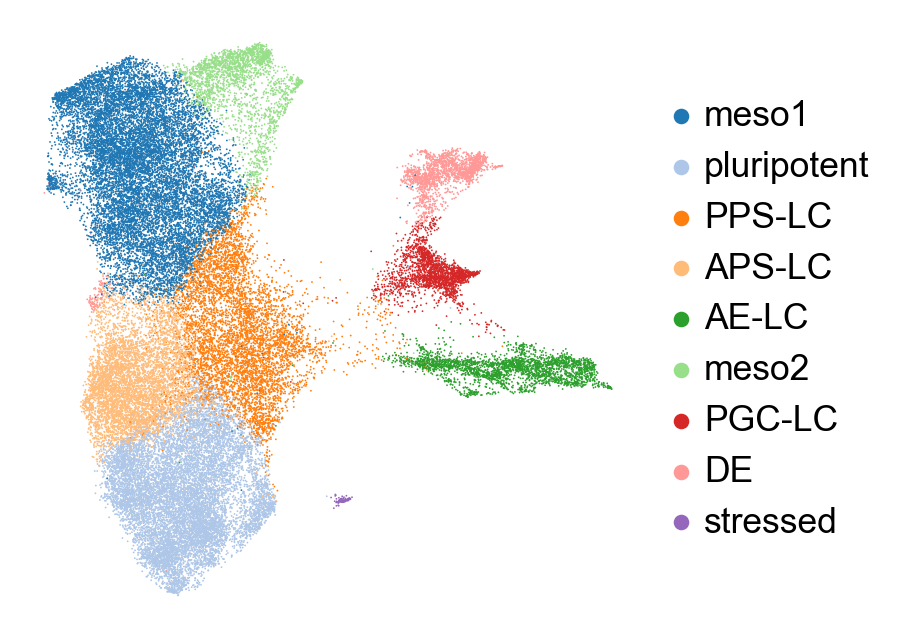

In [ ]:
sc.set_figure_params(figsize=[5,5])
sc.pl.umap(
    adata_all_cc,
    color=["leiden"],
    title=[""],
    palette=mypalette,#sb.color_palette('tab10', Nclusters),
    frameon=False,
    ncols=5,
    legend_fontsize=16,
)

67


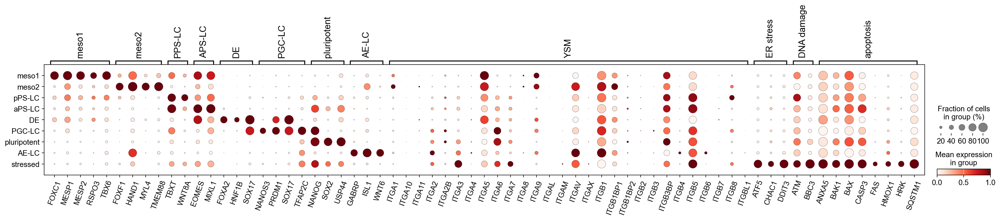

In [ ]:
# lower res clusters including stressed cells

plt.rcParams.update({'font.weight':'regular'})

PMmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['TBX6','FOXC1','MESP1','MESP2','RSPO3']]; #'FOXC1',
plurimarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['NANOG','SOX2','USP44']];
apsmarkers= [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['EOMES','MIXL1']];
ppsmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['WNT8A','TBXT']]; # CDX2
ammarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['GABRP','WNT6','ISL1']]
lpmmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['FOXF1','HAND1',"TMEM88","MYL4"]] #"NKX2-5",
DEmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['SOX17',"FOXA2","HNF1B"]]
PGCmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['NANOS3',"TFAP2C","SOX17","PRDM1"]];
stressedmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['DDIT3','HRK']]
YSMmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0].startswith('ITG')]

marker_genes_dict = {'meso1':PMmarkers,'meso2':lpmmarkers,
                     'PPS-LC':ppsmarkers,'APS-LC':apsmarkers,
                     'DE':DEmarkers,'PGC-LC':PGCmarkers,'pluripotent':plurimarkers,'AE-LC':ammarkers,
                     'YSM':YSMmarkers,
                     'ER stress':[g for g in adata_all_cc.raw.var_names if g.split()[0] in ['ATF5','CHAC1','DDIT3']],
                     'DNA damage':[g for g in adata_all_cc.raw.var_names if g.split()[0] in ['ATM','BBC3']],
                     'apoptosis':[g for g in adata_all_cc.raw.var_names if g.split()[0] in ['ANXA5','BAK1','BAX','CASP3','FAS','HMOX1','HRK','SQSTM1']]
                     } #'stressed':stressedmarkers

order=['meso1','meso2','pPS-LC','aPS-LC','DE','PGC-LC','pluripotent','AE-LC','stressed'];

allmarkers=[];
for key in marker_genes_dict:
    allmarkers = allmarkers + marker_genes_dict[key]
print(len(allmarkers))
#sc.tl.dendrogram(adata_all_cc, groupby = 'leiden', use_rep = 'X_scVI_cc')
ax_dict = sc.pl.dotplot(adata_all_cc, marker_genes_dict, categories_order=order, groupby='leiden', dendrogram=False, show=False, standard_scale='var', var_group_rotation=90);#, return_fig=True); #allmarkers -> marker_genes_dict
ax_dict['mainplot_ax'].set_xticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_xticklabels()]);
plt.setp(ax_dict['mainplot_ax'].get_xticklabels(), rotation=70);
#plt.savefig(dataDir+'dotplot_markers_horizontal_v3.png',dpi=300, bbox_inches = "tight")

42


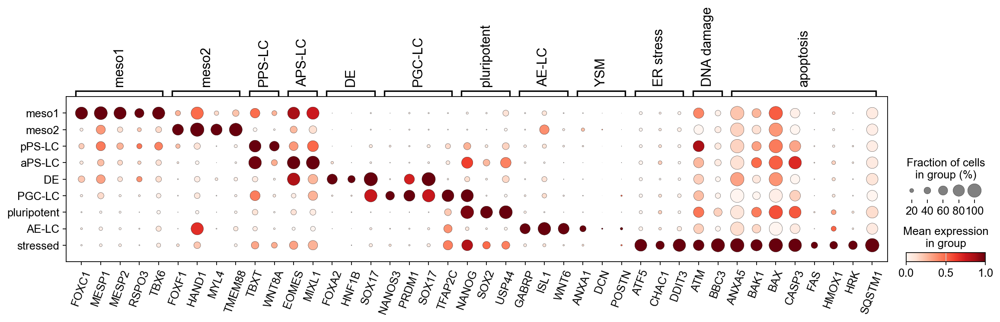

In [ ]:
# lower res clusters including stressed cells

plt.rcParams.update({'font.weight':'regular'})

PMmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['TBX6','FOXC1','MESP1','MESP2','RSPO3']]; #'FOXC1',
plurimarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['NANOG','SOX2','USP44']];
apsmarkers= [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['EOMES','MIXL1']];
ppsmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['WNT8A','TBXT']]; # CDX2
ammarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['GABRP','WNT6','ISL1']]
lpmmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['FOXF1','HAND1',"TMEM88","MYL4"]] #"NKX2-5",
DEmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['SOX17',"FOXA2","HNF1B"]]
PGCmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['NANOS3',"TFAP2C","SOX17","PRDM1"]];
stressedmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ['DDIT3','HRK']]
YSMmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in ["POSTN","DCN","ANXA1"]]

marker_genes_dict = {'meso1':PMmarkers,'meso2':lpmmarkers,
                     'PPS-LC':ppsmarkers,'APS-LC':apsmarkers,
                     'DE':DEmarkers,'PGC-LC':PGCmarkers,'pluripotent':plurimarkers,'AE-LC':ammarkers,
                     'YSM':YSMmarkers,
                     'ER stress':[g for g in adata_all_cc.raw.var_names if g.split()[0] in ['ATF5','CHAC1','DDIT3']],
                     'DNA damage':[g for g in adata_all_cc.raw.var_names if g.split()[0] in ['ATM','BBC3']],
                     'apoptosis':[g for g in adata_all_cc.raw.var_names if g.split()[0] in ['ANXA5','BAK1','BAX','CASP3','FAS','HMOX1','HRK','SQSTM1']]
                     } #'stressed':stressedmarkers

order=['meso1','meso2','pPS-LC','aPS-LC','DE','PGC-LC','pluripotent','AE-LC','stressed'];

allmarkers=[];
for key in marker_genes_dict:
    allmarkers = allmarkers + marker_genes_dict[key]
print(len(allmarkers))
#sc.tl.dendrogram(adata_all_cc, groupby = 'leiden', use_rep = 'X_scVI_cc')
ax_dict = sc.pl.dotplot(adata_all_cc, marker_genes_dict, categories_order=order, groupby='leiden', dendrogram=False, show=False, standard_scale='var', var_group_rotation=90);#, return_fig=True); #allmarkers -> marker_genes_dict
ax_dict['mainplot_ax'].set_xticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_xticklabels()]);
plt.setp(ax_dict['mainplot_ax'].get_xticklabels(), rotation=70);
plt.savefig(dataDir+'dotplot_markers_horizontal_v3.png',dpi=300, bbox_inches = "tight")

In [ ]:
# higher res clusters without stressed cells

Almarkers = ['ALCAM','MLLT3','PITX1','TBX4','HOXA1','CDX2'];
#ExMemarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in [‘LUM’,‘COL6A1’,‘CALU’,‘SPARC’]]; #‘POSTN’,
LPMmarkers= ['NKX2-5','MYL4','MYL7','FOXF1','TMEM88','HAND1'];
#pharmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in [‘ID4’,‘ID1’,‘ISL1’]]
somitomere = ['MESP1','MESP2','RIPPLY2']; # ‘HES7’,‘EVX1’
somite = ['FOXC2','MEOX1']; # ,'TCF15'
nasme = ['MSGN1','EVX1','RSPO3','TBX6','FOXC1']#'MIXL1','FOXC1','DLL3',

plurimarkers = ['NANOG','SOX2','USP44'];
apsmarkers= ['EOMES','MIXL1'];
ppsmarkers = ['WNT8A','TBXT']; # CDX2
ammarkers = ['GABRP','WNT6','ISL1']
DEmarkers = ["FOXA2","HNF1B"]
PGCmarkers = ["SOX17","PRDM1",'NANOS3',"TFAP2C"];
stressedmarkers = ['DDIT3','HRK'];

marker_genes_dict = {'nasme':nasme,
                     'somitomere':somitomere,
                    'somite':somite,
                    'LPM':LPMmarkers,
                     'Al':Almarkers,#subclusterlabels[9]:ExMemarkers,
                     'PPS':ppsmarkers,
                     'APS':apsmarkers,
                    'DE':DEmarkers,
                     'PGCLC':PGCmarkers,
                     'pluri':plurimarkers,
                     'AE-LC':ammarkers,
                    } # 'stressed':stressedmarkers

order=['eNasM','lNasM','aPM-LC','LPM-LC','CS-LC','pPS-LC','aPS-LC','DE','PGC-LC','pluripotent','AE-LC',];

allmarkers= [];
for key in marker_genes_dict:
    allmarkers = allmarkers + marker_genes_dict[key]

allmarkersp = [];
for g in allmarkers:
    allmarkersp = allmarkersp + [q for q in adata_all_cc.raw.var_names if q.split()[0]==g];

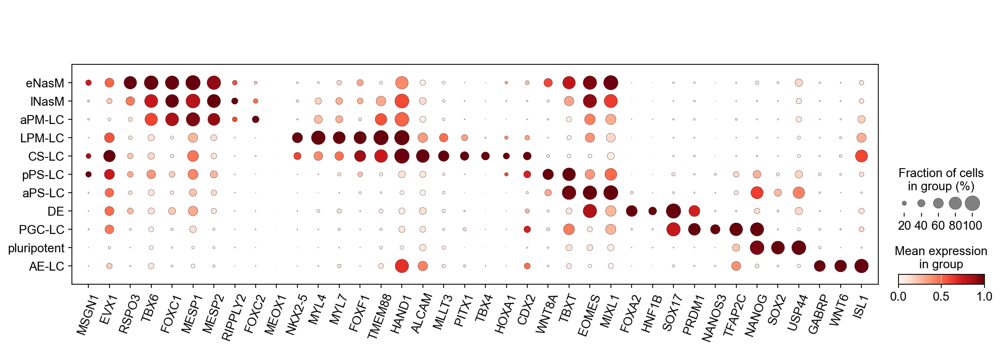

In [ ]:
adata_nostress = adata_all_cc[adata_all_cc.obs['leiden_sub']!='stressed'].copy();
#sc.tl.dendrogram(adata_nostress, groupby = 'leiden_sub', use_rep = 'X_scVI_cc')
ax_dict = sc.pl.dotplot(adata_nostress, allmarkersp, categories_order=order, groupby='leiden_sub', dendrogram=False, show=False, standard_scale='var',var_group_rotation=45);#, return_fig=True);
ax_dict['mainplot_ax'].set_xticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_xticklabels()]);
plt.setp(ax_dict['mainplot_ax'].get_xticklabels(), rotation=70);
plt.savefig(dataDir+"dotplot_markers_horizontal_subclusters_v3.png",dpi=300, bbox_inches = "tight")

In [ ]:
data_all_cc = pd.DataFrame(adata_all_cc.raw.X.toarray(), index=adata_all_cc.obs.index, columns=adata_all_cc.raw.var_names);

In [ ]:
data_all_cc_scaled = sklearn.preprocessing.StandardScaler().fit_transform(data_all_cc.to_numpy())
data_all_cc_scaled = pd.DataFrame(data_all_cc_scaled, index=data_all_cc.index, columns=data_all_cc.columns)

In [ ]:
#mean_diff_results_scaled = scprep.stats.differential_expression_by_cluster(data_all_cc_scaled, adata_all_cc.obs['leiden'], n_jobs=-1, direction='up')
emd_results_scaled = scprep.stats.differential_expression_by_cluster(data_all_cc_scaled, adata_all_cc.obs['leiden'], n_jobs=-1, direction='up', measure='emd')
#ranksum_results_scaled = scprep.stats.differential_expression_by_cluster(data_all_cc_scaled, adata_all_cc.obs['leiden'], n_jobs=-1, direction='up', measure='ranksum')
#ttest_results_scaled = scprep.stats.differential_expression_by_cluster(data_all_cc_scaled, adata_all_cc.obs['leiden'], n_jobs=-1, direction='up', measure='ttest')

In [ ]:
#adata_all_cc.rename_categories('leiden', ['0','1','2','3','4','5','6','7','8'])
#adata_all_cc.rename_categories('leiden', clusterlabels)
dataDir = scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/';
clustermarkers_dict = dict();
for cl in emd_results_scaled : 
    clustermarkers_dict[cl] = pd.DataFrame(emd_results_scaled[cl].index[0:50],columns=[cl]);#pd.DataFrame;
clustermarkers = pd.concat(clustermarkers_dict.values(),axis=1)
clustermarkers.to_csv(dataDir+'emd_clustermarkers.csv')
for col in clustermarkers.columns :
    clustermarkers[col] = clustermarkers[col].str.split(expand=True)[0]
clustermarkers.to_excel(dataDir+'emd_clustermarkers.xlsx')
pd.set_option('display.max_rows', None)
clustermarkers

,AE-LC,DE,PGC-LC,aPS-LC,meso1,meso2,pPS-LC,pluripotent,stressed
0,IGFBP7,SOX17,PDPN,FGF4,DLL3,HOXB8,TACR1,SOX2,TAC1
1,TCIM,FOXA2,NANOS3,NODAL,IRX3,CRB2,WNT8A,USP44,ATF5
2,WNT6,CCKBR,VSTM2B,FGF8,FOXC1,MYL4,DTWD2,TERF1,DDIT3
3,EPAS1,HNF1B,PRDM1,CDA,APLNR,RGS13,KCTD6,VSNL1,INHBE
4,DLX5,CST1,SOSTDC1,HEBP2,LHX1,TMEM88,CHST2,PTPRZ1,GDF15
5,SLC8A1,BHLHE22,PLBD1,GAL,MESP1,HOXB6,SPATA16,SEPHS1,TRIB3
6,GABRP,MNX1,TFAP2C,ALDH3A2,PLXNA2,HOXB5,ABCG2,DPPA4,LAMP3
7,SPNS2,GATM,FAM20A,MIXL1,MESP2,ADGRA2,ID4,AASS,NIBAN1
8,ISL1,FGF17,SOX17,GDF3,WNT5A,HOXB4,PDHB,IGFBP2,HRK
9,ANXA3,GJA4,RAB15,NPM3,BMP2,TRPV2,GAL,GPR160,AKNA


In [ ]:
#mean_diff_results_scaled = scprep.stats.differential_expression_by_cluster(data_all_cc_scaled, adata_all_cc.obs['leiden'], n_jobs=-1, direction='up')
emd_results_scaled_sub = scprep.stats.differential_expression_by_cluster(data_all_cc_scaled, adata_all_cc.obs['leiden_sub'], n_jobs=-1, direction='up', measure='emd')
#ranksum_results_scaled = scprep.stats.differential_expression_by_cluster(data_all_cc_scaled, adata_all_cc.obs['leiden'], n_jobs=-1, direction='up', measure='ranksum')
#ttest_results_scaled = scprep.stats.differential_expression_by_cluster(data_all_cc_scaled, adata_all_cc.obs['leiden'], n_jobs=-1, direction='up', measure='ttest')

In [ ]:
#adata_all_cc.rename_categories('leiden', ['0','1','2','3','4','5','6','7','8'])
#adata_all_cc.rename_categories('leiden', clusterlabels)
dataDir = scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/';
clustermarkers_dict = dict();
for cl in emd_results_scaled_sub : 
    clustermarkers_dict[cl] = pd.DataFrame(emd_results_scaled_sub[cl].index[0:50],columns=[cl]);#pd.DataFrame;
clustermarkers = pd.concat(clustermarkers_dict.values(),axis=1)
clustermarkers.to_csv(dataDir+'emd_subclustermarkers.csv')
for col in clustermarkers.columns :
    clustermarkers[col] = clustermarkers[col].str.split(expand=True)[0]
clustermarkers.to_excel(dataDir+'emd_subclustermarkers.xlsx')
pd.set_option('display.max_rows', None)
clustermarkers

,AE-LC,CS-LC,DE,LPM-LC,PGC-LC,aPM-LC,aPS-LC,eNasM,lNasM,pPS-LC,pluripotent,stressed
0,IGFBP7,HGF,SOX17,RGS13,PDPN,GYPB,FGF4,RSPO3,LHX1,TACR1,SOX2,TAC1
1,TCIM,HOXB9,FOXA2,MYL4,NANOS3,GYPE,NODAL,MESP1,IRX3,WNT8A,USP44,ATF5
2,WNT6,TBX4,CCKBR,CALB2,VSTM2B,NPY,FGF8,TBX6,FAM89A,DTWD2,TERF1,DDIT3
3,EPAS1,HOXA13,HNF1B,GLIPR2,PRDM1,CFC1,CDA,WNT5A,LIPG,KCTD6,VSNL1,INHBE
4,DLX5,PITX1,CST1,SLPI,SOSTDC1,APCDD1L,HEBP2,FOXC1,SHISA6,CHST2,PTPRZ1,GDF15
5,SLC8A1,UGT2B11,BHLHE22,HOXB4,PLBD1,KRT19,GAL,CNKSR3,HLX,SPATA16,SEPHS1,TRIB3
6,GABRP,HAND2,MNX1,CRB2,TFAP2C,KCNA1,ALDH3A2,GATA6,CDH11,ABCG2,DPPA4,LAMP3
7,SPNS2,HOXA11,GATM,TMEM88,FAM20A,TTN,MIXL1,LZTS1,LGR5,ID4,AASS,NIBAN1
8,ISL1,HOXB8,FGF17,TRPV2,SOX17,LRRTM1,GDF3,DLL3,NRG2,PDHB,IGFBP2,HRK
9,ANXA3,PMP22,GJA4,HOXB5,RAB15,DLK1,NPM3,APLNR,COLEC12,GAL,GPR160,AKNA


### Split by time point

In [ ]:
# higher res clusters without stressed cells

Almarkers = ['ALCAM','MLLT3','PITX1','TBX4','HOXA1','CDX2'];
#ExMemarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in [‘LUM’,‘COL6A1’,‘CALU’,‘SPARC’]]; #‘POSTN’,
LPMmarkers= ['NKX2-5','MYL4','MYL7','FOXF1','TMEM88','HAND1'];
#pharmarkers = [g for g in adata_all_cc.raw.var_names if g.split()[0] in [‘ID4’,‘ID1’,‘ISL1’]]
somitomere = ['MESP1','MESP2','RIPPLY2']; # ‘HES7’,‘EVX1’
somite = ['FOXC2','MEOX1']; # ,'TCF15'
PMmarkers = ['MSGN1','EVX1','RSPO3','TBX6','FOXC1']#'MIXL1','FOXC1','DLL3',

plurimarkers = ['NANOG','SOX2','USP44'];
apsmarkers= ['EOMES','MIXL1'];
ppsmarkers = ['WNT8A','TBXT']; # CDX2
ammarkers = ['GABRP','WNT6','ISL1']
DEmarkers = ["FOXA2","HNF1B"]
PGCmarkers = ["SOX17","PRDM1",'NANOS3',"TFAP2C"];
stressedmarkers = ['DDIT3','HRK'];

marker_genes_dict = {'PM':PMmarkers,
                     'somitomere':somitomere,
                    'somite':somite,
                    'LPM':LPMmarkers,
                     'Al':Almarkers,#subclusterlabels[9]:ExMemarkers,
                     'PPS':ppsmarkers,
                     'APS':apsmarkers,
                    'DE':DEmarkers,
                     'PGCLC':PGCmarkers,
                     'pluri':plurimarkers,
                     'AE-LC':ammarkers,
                    } # 'stressed':stressedmarkers

order=['eNasM','lNasM','aPM-LC','LPM-LC','CS-LC','pPS-LC','aPS-LC','DE','PGC-LC','pluripotent','AE-LC',];

allmarkers= [];
for key in marker_genes_dict:
    allmarkers = allmarkers + marker_genes_dict[key]

allmarkersp = [];
for g in allmarkers:
    allmarkersp = allmarkersp + [q for q in adata_all_cc.raw.var_names if q.split()[0]==g];

/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:471: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


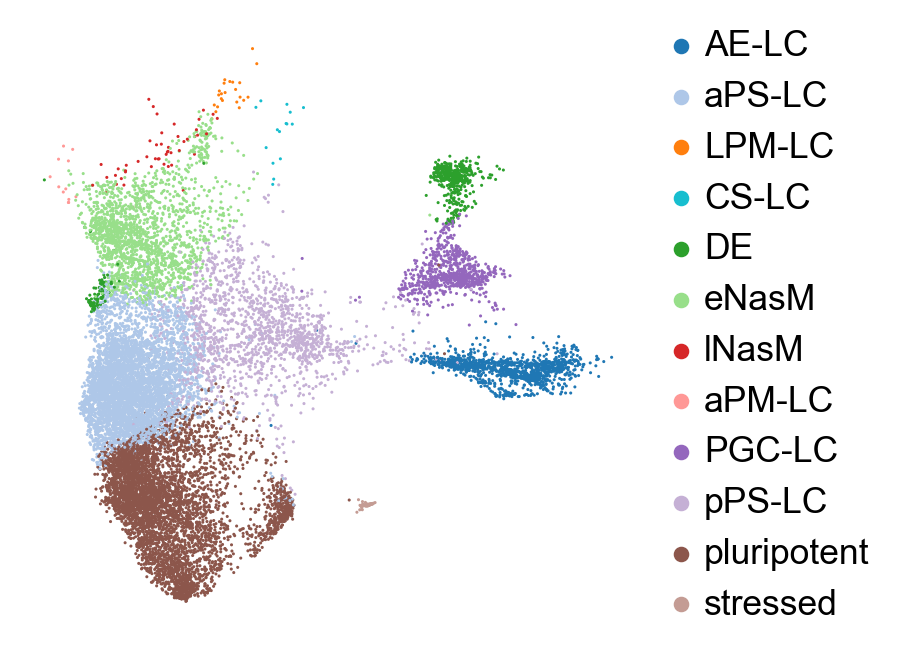

/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:471: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


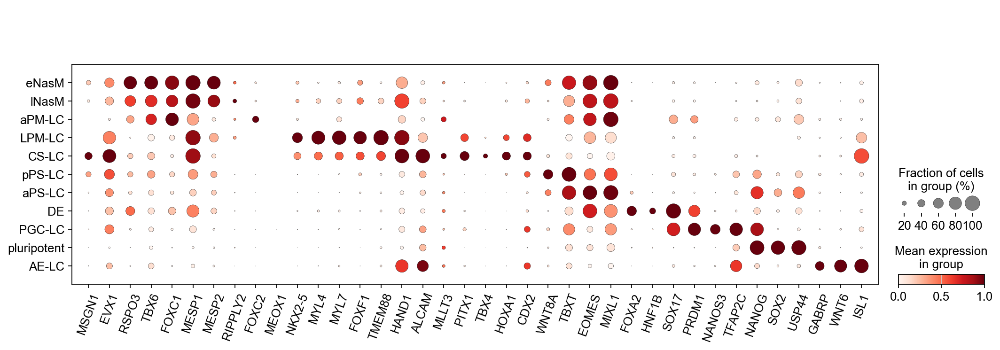

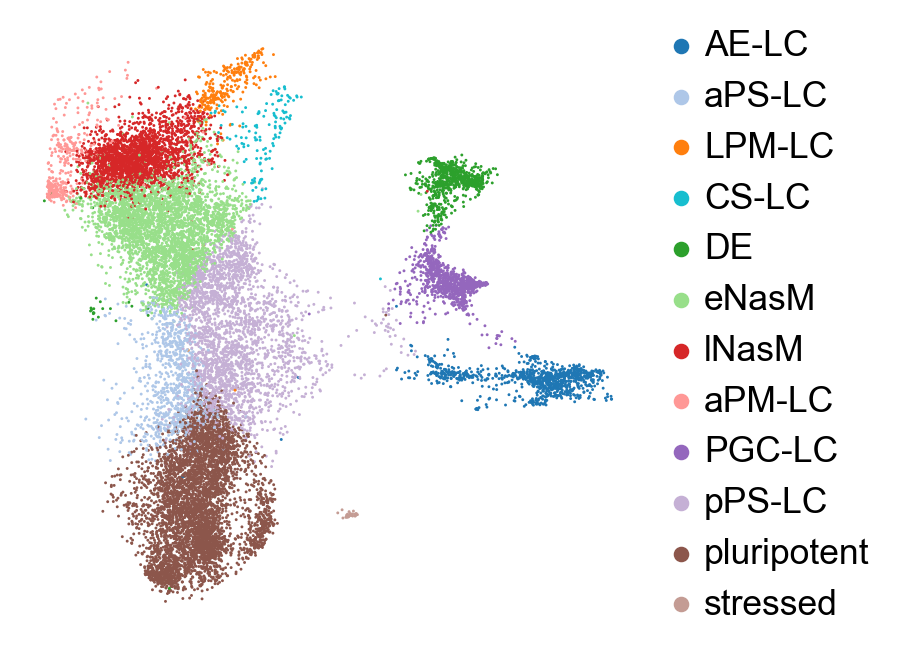

/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:471: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


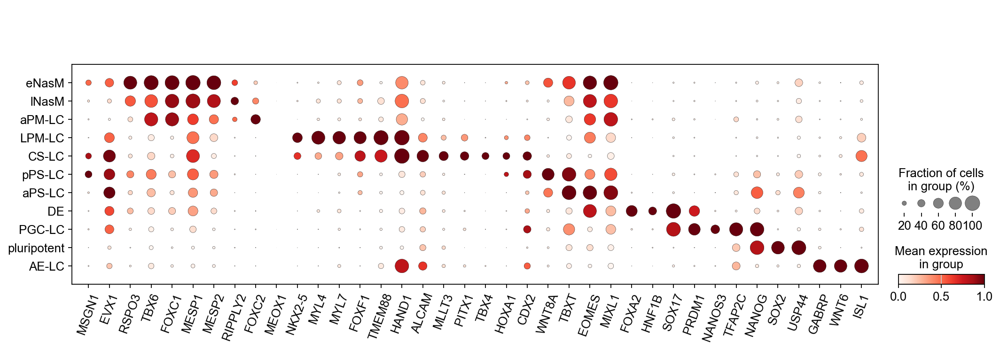

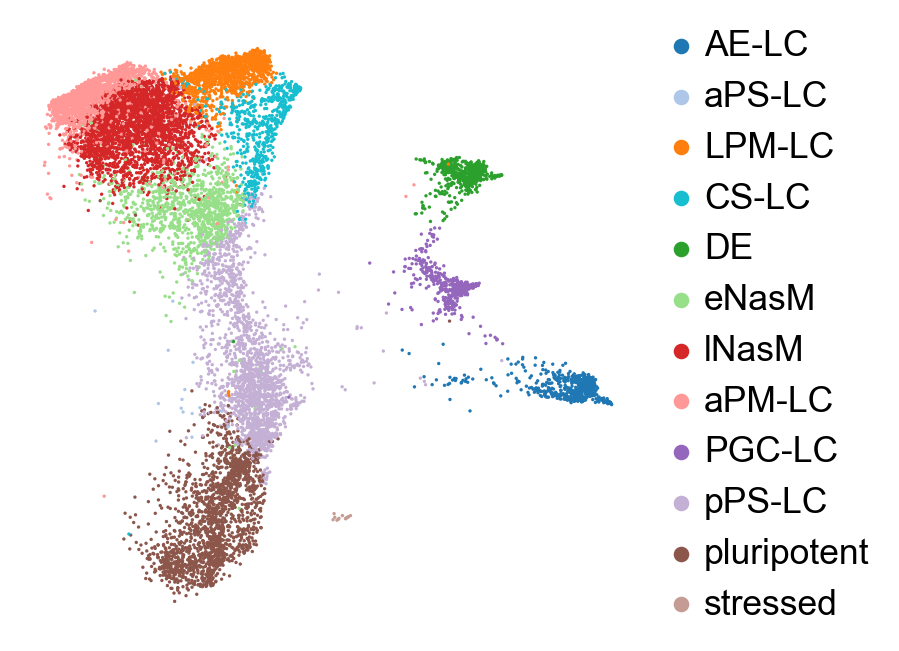

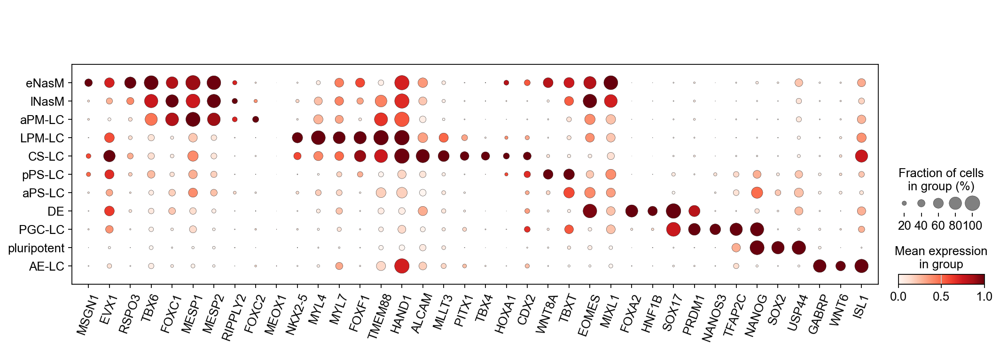

In [ ]:
for time in ['48h','72h','96h']:
    
    adata_tmp = adata_all_cc[np.logical_or(adata_all_cc.obs['sample_labels']==time+'-1',adata_all_cc.obs['sample_labels']==time+'-2')];
    
    sc.pl.umap(
        adata_tmp,
        color=["leiden_sub"],
        frameon=False,
        ncols=5,
        title=[""],
        palette=mypalette,
        legend_fontsize=16,
        save='_gastruloid_all_leiden_sub_' + time + '.png',
    )

    adata_tmp = adata_tmp[adata_tmp.obs['leiden_sub']!='stressed'];
    ax_dict = sc.pl.dotplot(adata_tmp, allmarkersp, categories_order=order, groupby='leiden_sub', dendrogram=False, show=False, standard_scale='var',var_group_rotation=45);#, return_fig=True);
    ax_dict['mainplot_ax'].set_xticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_xticklabels()]);
    plt.setp(ax_dict['mainplot_ax'].get_xticklabels(), rotation=70);
    plt.savefig(dataDir+"dotplot_markers_horizontal_subclusters_v3_"+time+".png",dpi=300, bbox_inches = "tight")
    

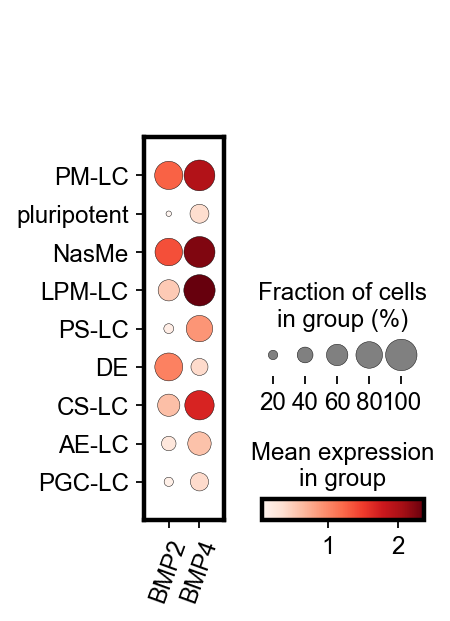

In [ ]:
#genes_shortnames = [g.split()[0] for g in adata_96.raw.var_names if g.startswith("WNT")]
genes_shortnames = ['BMP2','BMP4']
genes_fullnames = [g for g in adata_96.raw.var_names if g.split()[0] in genes_shortnames];

ax_dict = sc.pl.dotplot(adata_96, genes_fullnames, groupby='leiden_sub', dendrogram=False,
                        show=False, #standard_scale='var',
                        var_group_rotation=45);#, return_fig=True);
ax_dict['mainplot_ax'].set_xticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_xticklabels()]);
plt.setp(ax_dict['mainplot_ax'].get_xticklabels(), rotation=70);
plt.savefig(dataDir+'dotplot_signaling_96h.png',dpi=300, bbox_inches = "tight")
    
# ax_dict = sc.pl.dotplot(adata_all_ cc, marker_genes_dict, groupby='leiden', dendrogram=True, show=False, swap_axes=True);#, return_fig=True);
# ax_dict['mainplot_ax'].get_yticklabels();
# ax_dict['mainplot_ax'].set_yticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_yticklabels()]);
# plt.savefig(dataDir+'dotplot_markers_vertical.png',dpi=300, bbox_inches = "tight")

#dp = sc.pl.dotplot(adata, markers, 'bulk_labels', return_fig=True) 

In [ ]:
#adata_96.write_h5ad(dataDir + 'adata_96h_v2.h5ad')

In [ ]:
time = adata_all_cc.obs['sample_labels'].astype('str')
idx96h = np.logical_or(adata_all_cc.obs['sample_labels'] == '96h-1', adata_all_cc.obs['sample_labels'] == '96h-2')
time[idx96h] = '96h'
idx72h = np.logical_or(adata_all_cc.obs['sample_labels'] == '72h-1', adata_all_cc.obs['sample_labels'] == '72h-2')
time[idx72h] = '72h'
idx48h = np.logical_or(adata_all_cc.obs['sample_labels'] == '48h-1', adata_all_cc.obs['sample_labels'] == '48h-2')
time[idx48h] = '48h'
time = pd.Categorical(time);
adata_all_cc.obs['time'] = time;

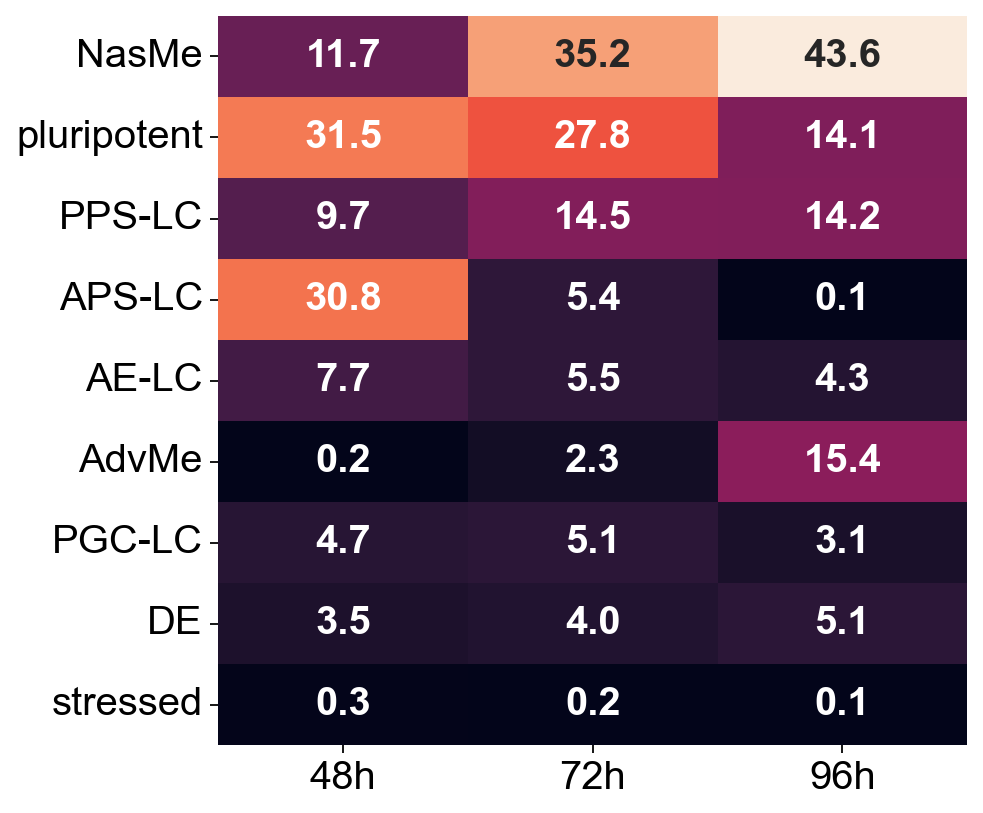

In [ ]:
for group in ['time']:#, 'sample_labels'
    obs_tab = adata_all_cc.obs.copy()
    obs_summary = obs_tab.groupby(['leiden', group])[['_scvi_batch']].count()
    leiden_cell_count = obs_summary.groupby(group).transform(lambda x: x.sum())
    percentmap = obs_summary / leiden_cell_count * 100
    percentmap = percentmap.pivot_table(index='leiden', columns=group);
    percentmap.columns = [j for (i,j) in percentmap.columns];

    import seaborn as sns
    fs = 18;
    plt.figure(figsize=(6, 6))
    h = sns.heatmap(percentmap, annot=True, cbar=False, annot_kws={"size": fs},fmt='.1f')
    #h.set_xticklabels(colnames, rotation=45) #column index has format ("cell_type", sample name), get sample name only
    h.set_xlabel('')
    h.set_ylabel('')
    for text in h.texts:
        text.set_fontweight('bold')
    for label in h.xaxis.get_ticklabels():
    #    label.set_fontweight('bold')
        label.set_fontsize(fs)
    for label in h.yaxis.get_ticklabels():
    #    label.set_fontweight('bold')
        label.set_fontsize(fs)
    plt.savefig(dataDir + 'heatmap_fatepercentageby'+group+'.png', bbox_inches='tight')

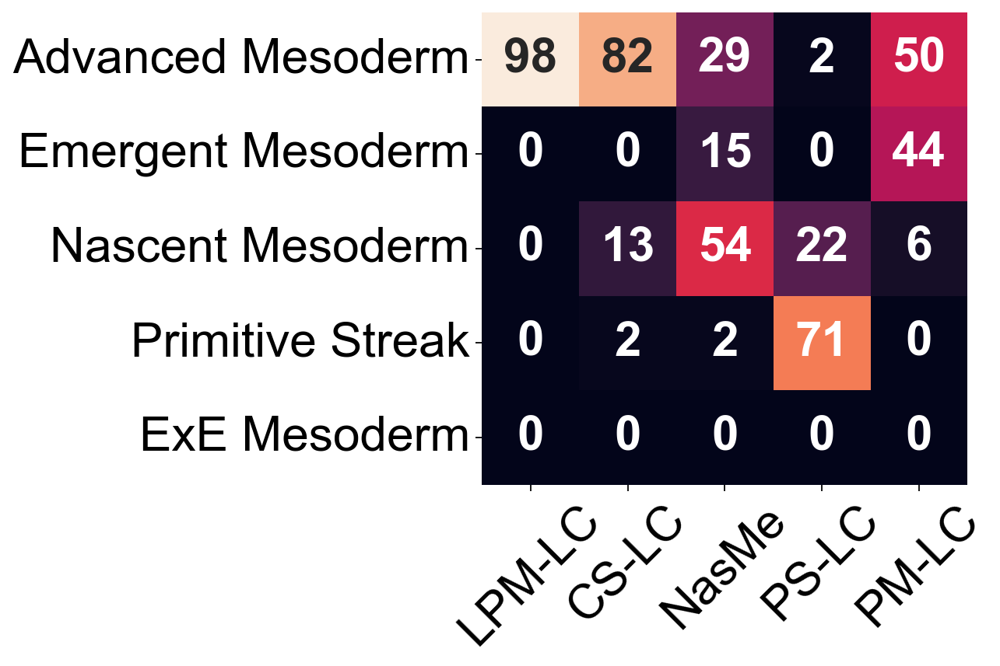

In [ ]:
clustertype = 'leiden_sub';
predicttype = 'knnpred';#'knnpred_sub';
obs_tab = adata_full[adata_full.obs['batch'] == 'Query'].obs.copy()
obs_summary = obs_tab.groupby([clustertype,predicttype])[['time']].count() # time is just a random column without nan
leiden_cell_count = obs_summary.groupby(clustertype).transform(lambda x: x.sum())
percentmap = obs_summary / leiden_cell_count * 100
percentmap = percentmap.pivot_table(index=predicttype, columns=clustertype);
percentmap.columns = [j for (i,j) in percentmap.columns];

if clustertype == 'leiden':
    percentmap = percentmap[['AdvMe','NasMe','APS-LC','PPS-LC']].loc[['Advanced Mesoderm','Emergent Mesoderm','Nascent Mesoderm','Primitive Streak','ExE Mesoderm']]
    colnames = ['AdvMe','NasMe','APS-LC','PPS-LC'];
else:
    percentmap = percentmap[['LPM-LC','CS-LC', 'NasMe','PS-LC','PM-LC']].loc[['Advanced Mesoderm','Emergent Mesoderm','Nascent Mesoderm','Primitive Streak','ExE Mesoderm']]
    colnames = ['LPM-LC','CS-LC', 'NasMe','PS-LC','PM-LC'];
    
import seaborn as sns
fs = 28;
plt.figure(figsize=(5, 5))
h = sns.heatmap(percentmap, annot=True, cbar=False, annot_kws={"size": fs},fmt='.0f')
h.set_xticklabels(colnames, rotation=45) #column index has format ("cell_type", sample name), get sample name only
h.set_xlabel('')
h.set_ylabel('')
for text in h.texts:
    text.set_fontweight('bold')
for label in h.xaxis.get_ticklabels():
#    label.set_fontweight('bold')
    label.set_fontsize(fs)
for label in h.yaxis.get_ticklabels():
#    label.set_fontweight('bold')
    label.set_fontsize(fs)
plt.savefig(dataDir + 'heatmap_'+clustertype + '_' + predicttype+'_v2.png', bbox_inches='tight')

## Analyze d6-d10

In [ ]:
#adata_int = sc.read_h5ad(scseqDir + 'adata_micropattern_time_series_48-96h_D6_D8_D10_integrated.h5ad');
adata_int = sc.read_h5ad(scseqDir + '241019_adata_int_wraw.h5ad');

In [ ]:
adata_int.obs['time'] = [g.split('-')[0] for g in adata_int.obs['sample_labels']];
adata_int.obs['time'][adata_int.obs['time']=='48h']='D2';
adata_int.obs['time'][adata_int.obs['time']=='72h']='D3';
adata_int.obs['time'][adata_int.obs['time']=='96h']='D4';
adata_int.obs['time'][adata_int.obs['time']=='bc_2']='D6';
adata_int.obs['time'][adata_int.obs['time']=='bc_3']='D8';
adata_int.obs['time'][adata_int.obs['time']=='bc_4']='D10';

/var/folders/6r/85dgkgjs1dn_nm3zdxyy611w0000gn/T/ipykernel_73890/2093831167.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_int.obs['time'][adata_int.obs['time']=='48h']='D2';
/var/folders/6r/85dgkgjs1dn_nm3zdxyy611w0000gn/T/ipykernel_73890/2093831167.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_int.obs['time'][adata_int.obs['time']=='72h']='D3';
/var/folders/6r/85dgkgjs1dn_nm3zdxyy611w0000gn/T/ipykernel_73890/2093831167.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stab

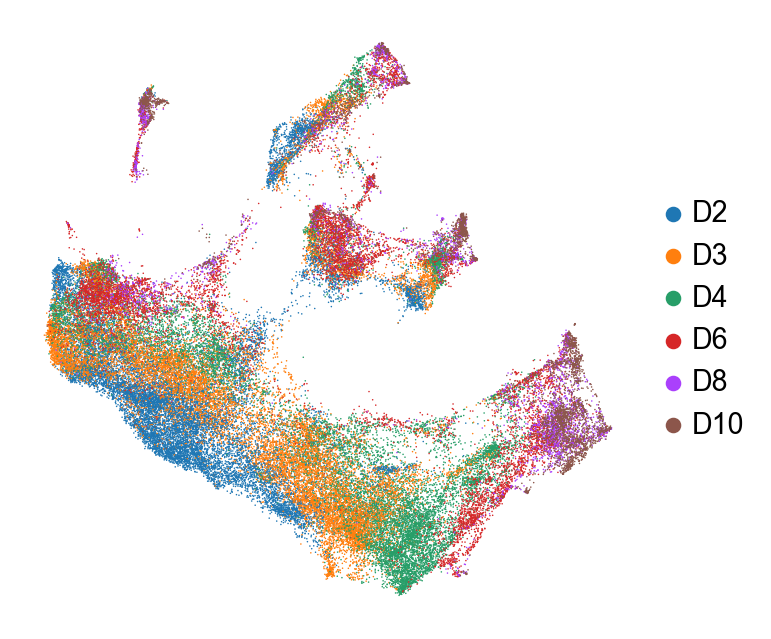

In [ ]:
sc.pl.umap(adata_int,
           color=['time'],
           na_in_legend=False,
            frameon=False,
           title="",
          save='integrated_time.pdf'
          )

### Cluster assignment

In [ ]:
import scarches as sca

#adata_int.obs['leiden_sub'] = adata_int.obs['leiden_sub'].cat.add_categories('unknown');
ridx = ~adata_int.obs['sample_labels'].str.startswith('bc');
adata_int.obs['knn_uncert'] = 0;

adata_ref = adata_int[ridx].copy();
adata_ref.obs['leiden_sub'] = adata_ref.obs['leiden_sub'].astype(str);
knn_transformer = sca.utils.knn.weighted_knn_trainer(
    train_adata=adata_ref,
    train_adata_emb="X_scvi",  # location of our joint embedding
    n_neighbors=15,
)

for i in [2,3,4]:

    qidx = adata_int.obs['sample_labels'].str.startswith('bc_'+str(i));
    labels, uncert = sca.utils.knn.weighted_knn_transfer(
        query_adata=adata_int[qidx],
        query_adata_emb="X_scvi",  # location of our embedding, query_adata.X in this case
        label_keys="leiden_sub",  # (start of) obs column name(s) for which to transfer labels
        knn_model=knn_transformer,
        ref_adata_obs=adata_ref.obs,
    )
    
    adata_int.obs['leiden_sub'][qidx]=labels['leiden_sub'];
    adata_int.obs['knn_uncert'][qidx]=np.squeeze(uncert['leiden_sub']);

    ridx = np.logical_or(ridx, qidx);

adata_int.obs['knn_uncert'] = adata_int.obs['knn_uncert'].astype(float);

 captum (see https://github.com/pytorch/captum).


Weighted KNN with n_neighbors = 15 ... 

/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/threadpoolctl.py:1214: RuntimeWarning: 
Found Intel OpenMP ('libiomp') and LLVM OpenMP ('libomp') loaded at
the same time. Both libraries are known to be incompatible and this
can cause random crashes or deadlocks on Linux when loaded in the
same Python program.
Using threadpoolctl may cause crashes or deadlocks. For more
information and possible workarounds, please see
    https://github.com/joblib/threadpoolctl/blob/master/multiple_openmp.md

  warnings.warn(msg, RuntimeWarning)


finished!


/var/folders/6r/85dgkgjs1dn_nm3zdxyy611w0000gn/T/ipykernel_49521/3245915598.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_int.obs['knn_uncert'][qidx]=np.squeeze(uncert['leiden_sub']);


finished!
finished!


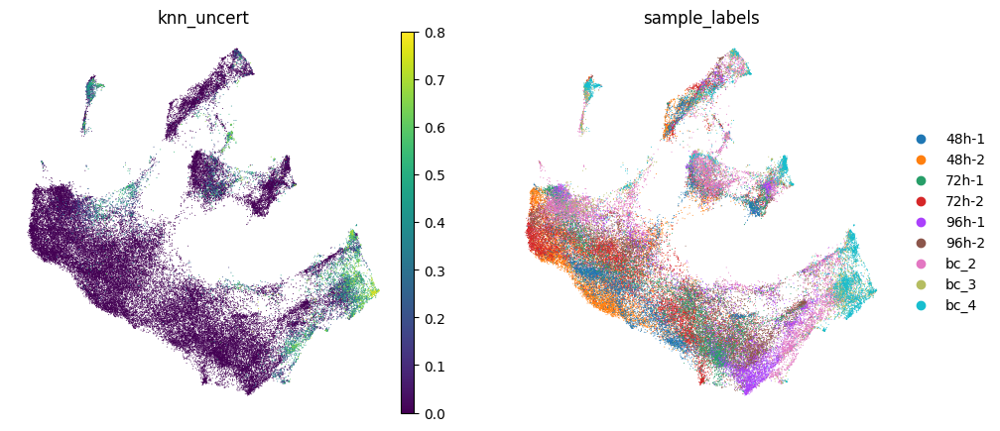

In [ ]:
plt.rcParams["figure.figsize"] = (5,5)
sc.pl.umap(adata_int,
           color=['knn_uncert','sample_labels'],
            frameon=False,)

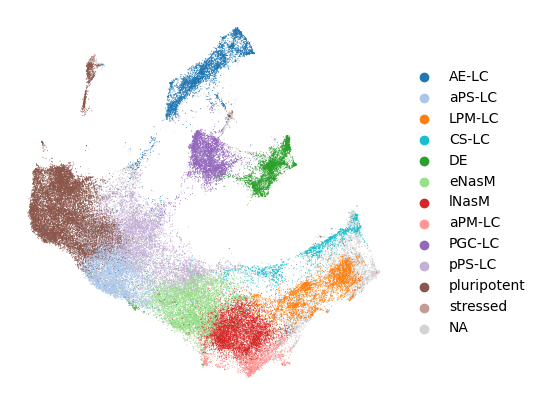

In [ ]:
# mypalette = sb.color_palette('tab20', 20).copy();
# mypalette[3] = mypalette[18];
# mypalette[13] = mypalette[16];
# mypalette = dict(zip(adata_int.obs['leiden_sub_sub2'].cat.categories, mypalette[0:15]));

adata_int.obs['leiden_sub'][adata_int.obs['knn_uncert'] > 0.2] = np.nan; #0.2

sc.pl.umap(adata_int,
           color=['leiden_sub'],
           title="",
           palette = mypalette,
            frameon=False,
            #save="integrated_cluster.png",
          )

In [ ]:
# first determine which of the unknown cells cluster with pluripotent by reclustering them together

adata_int_sub = adata_int[(adata_int.obs['leiden_sub'] == 'pluripotent') | (adata_int.obs['leiden_sub'].astype(str) == 'nan')].copy();
sc.pp.neighbors(adata_int_sub, n_neighbors=15, use_rep="X_scvi")
sc.tl.umap(adata_int_sub, min_dist=0.1)

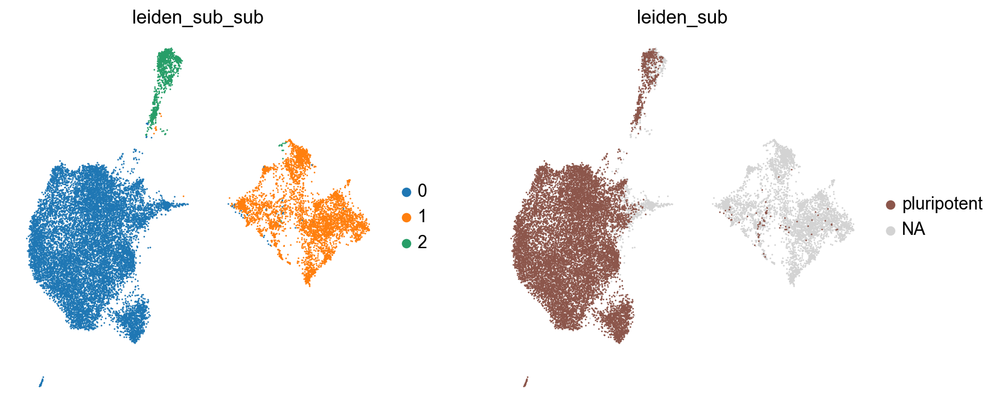

In [ ]:
# this separates the cells that were assigned the label pluripotent into pluripotent and ectoderm and leaves a remaining unknown group

sc.tl.leiden(adata_int_sub, resolution=0.1, key_added='leiden_sub_sub', random_state=0) #0.2,1
sc.pl.umap(adata_int_sub,
       color=['leiden_sub_sub','leiden_sub'],
        frameon=False,)

In [ ]:
adata_int.obs['leiden_sub_sub'] = adata_int.obs['leiden_sub'];
adata_int.obs['leiden_sub_sub'] = adata_int.obs['leiden_sub_sub'].cat.add_categories('ectoderm');

adata_int.obs['leiden_sub_sub'][ adata_int_sub.obs['leiden_sub_sub'][adata_int_sub.obs['leiden_sub_sub']==str(0)].index ]='pluripotent';
adata_int.obs['leiden_sub_sub'][ adata_int_sub.obs['leiden_sub_sub'][adata_int_sub.obs['leiden_sub_sub']==str(2)].index ]='ectoderm';

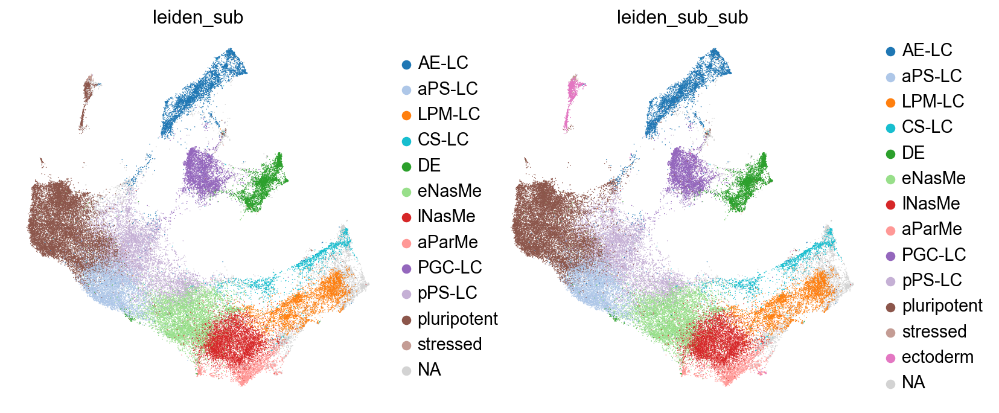

In [ ]:
sc.pl.umap(adata_int,
           color=['leiden_sub','leiden_sub_sub'],
           palette = mypalette,
            frameon=False,)

In [ ]:
# now apply the same strategy to determine which unknown cells belong to CS-LC or LPM-LC

adata_int_sub = adata_int[(adata_int.obs['leiden_sub_sub'] == 'CS-LC') | (adata_int.obs['leiden_sub_sub'] == 'LPM-LC') | (adata_int.obs['leiden_sub_sub'].astype(str) == 'nan')].copy();
sc.pp.neighbors(adata_int_sub, n_neighbors=15, use_rep="X_scvi")
sc.tl.umap(adata_int_sub, min_dist=0.1)

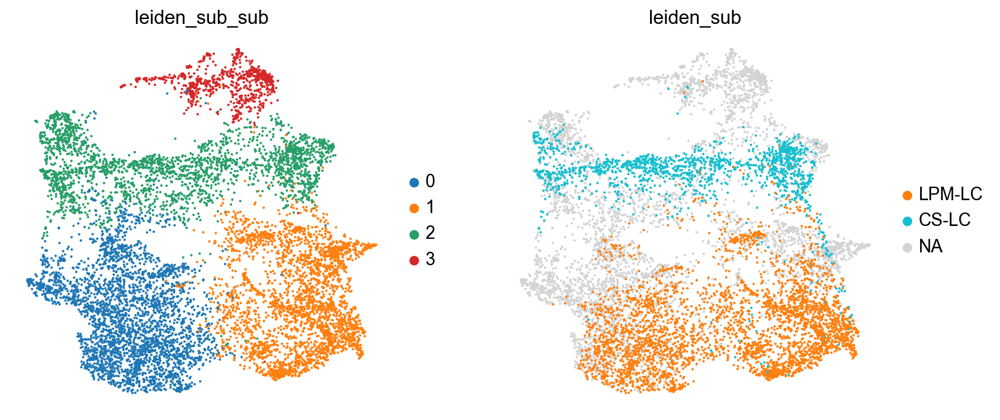

In [ ]:
# this produces two clusters that should be part of LPM-LC, one for CS-LC and another unknown

sc.tl.leiden(adata_int_sub, resolution=0.2, key_added='leiden_sub_sub', random_state=1) # 
sc.pl.umap(adata_int_sub,
       color=['leiden_sub_sub','leiden_sub'],
        frameon=False,)

In [ ]:
adata_int.obs['leiden_sub_sub'][ adata_int_sub.obs['leiden_sub_sub'][adata_int_sub.obs['leiden_sub_sub']==str(2)].index ]='CS-LC';
adata_int.obs['leiden_sub_sub'][ adata_int_sub.obs['leiden_sub_sub'][adata_int_sub.obs['leiden_sub_sub']==str(1)].index ]='LPM-LC';
adata_int.obs['leiden_sub_sub'][ adata_int_sub.obs['leiden_sub_sub'][adata_int_sub.obs['leiden_sub_sub']==str(0)].index ]='LPM-LC';

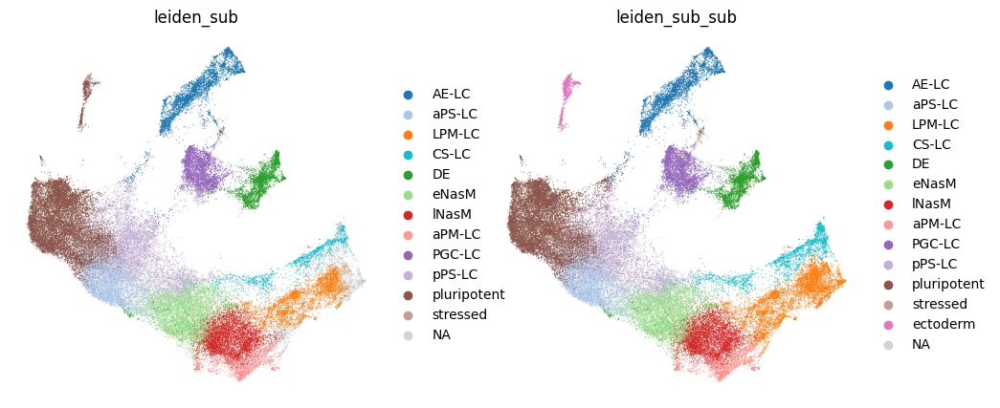

In [ ]:
sc.pl.umap(adata_int,
           color=['leiden_sub','leiden_sub_sub'],
           palette = mypalette,
            frameon=False,)

In [ ]:
# now take the highest uncertainty LPM cells and see if they represent new LPM-derived cell types

adata_int_sub = adata_int[(adata_int.obs['knn_uncert'] > 0.2) & (adata_int.obs['leiden_sub_sub'] == 'LPM-LC')].copy();
sc.pp.neighbors(adata_int_sub, n_neighbors=30, use_rep="X_scvi")
sc.tl.umap(adata_int_sub, min_dist=0.1)

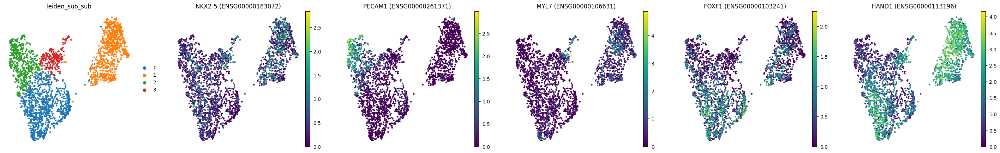

In [ ]:
#for rs in range(0,5):
rs = 1;
sc.tl.leiden(adata_int_sub, resolution=0.35, use_weights=True, key_added='leiden_sub_sub', random_state=rs) 
sc.pl.umap(adata_int_sub,
           color=['leiden_sub_sub'] + [g for g in adata_int_sub.var_names if g.split()[0] in ['PECAM1','FOXF1','NKX2-5','HAND1','MYL7','TBX5','SOX6']],
            frameon=False,
          ncols=6)

In [ ]:
adata_int.obs['leiden_sub_sub2'] = adata_int.obs['leiden_sub_sub'];
adata_int.obs['leiden_sub_sub2'] = adata_int.obs['leiden_sub_sub2'].cat.add_categories('EC');
adata_int.obs['leiden_sub_sub2'] = adata_int.obs['leiden_sub_sub2'].cat.add_categories('CM-LC');
adata_int.obs['leiden_sub_sub2'][ adata_int_sub.obs['leiden_sub_sub'][adata_int_sub.obs['leiden_sub_sub']==str(2)].index ]='EC';
adata_int.obs['leiden_sub_sub2'][ adata_int_sub.obs['leiden_sub_sub'][adata_int_sub.obs['leiden_sub_sub']==str(3)].index ]='CM-LC';

In [ ]:
# rename from earlier clusternames to final clusternames
clusterlabels = ['AE-LC','aPS-LC','LPM-LC','CS-LC','DE','eNasM','lNasM','aPM-LC','PGC-LC','pPS-LC','pluripotent','stressed','ectoderm','EC','CMes-LC'];
adata_int.rename_categories('leiden_sub_sub2', clusterlabels)
clusterlabels = ['AE-LC','aPS-LC','LPM-LC','CS-LC','DE','eNasM','lNasM','aPM-LC','PGC-LC','pPS-LC','pluripotent','stressed'];
adata_int.rename_categories('leiden_sub', clusterlabels)

In [ ]:
# order clusters 
order=['CMes-LC','EC','CS-LC','LPM-LC','aPM-LC','lNasM','eNasM','pPS-LC','aPS-LC','pluripotent','DE','PGC-LC','ectoderm','AE-LC','stressed'];
adata_int.obs['leiden_sub_sub2_ordered'] = adata_int.obs['leiden_sub_sub2'].cat.reorder_categories(order);

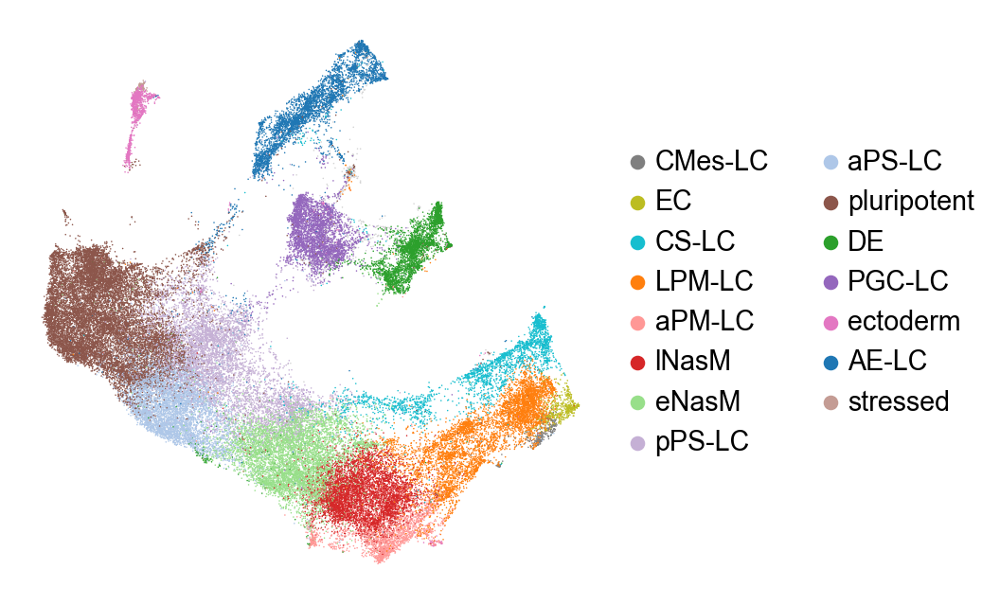

In [ ]:
# mypalette = sb.color_palette('tab20', 20).copy();
# mypalette[3] = mypalette[18];
# mypalette[13] = mypalette[16];
# mypalette = dict(zip(adata_int.obs['leiden_sub_sub2'].cat.categories, mypalette[0:15]));

sc.pl.umap(adata_int,
           color=['leiden_sub_sub2_ordered'],
           palette = mypalette,
           na_in_legend=False,
            frameon=False,
           title="",
          save='integrated_subcluster_sorted.pdf')

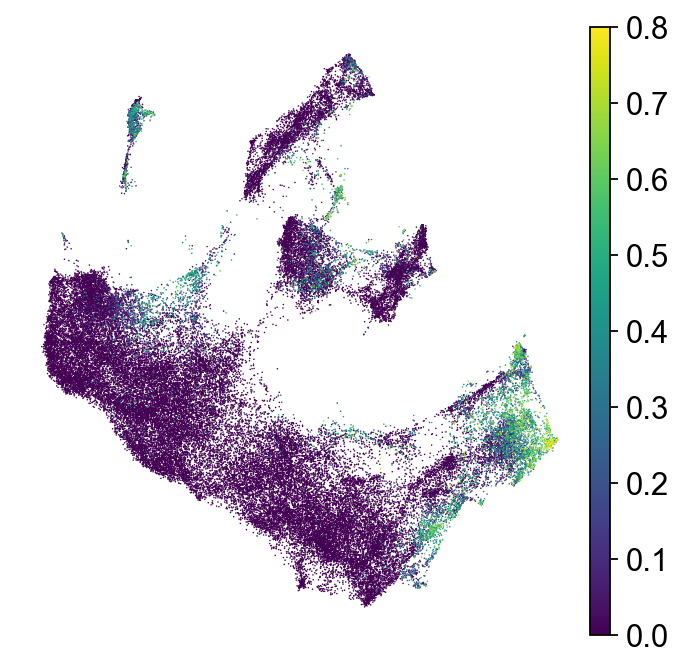

In [ ]:
# for figure

rcParams["figure.figsize"] = (5,5)
sc.pl.umap(adata_int,
           color=['knn_uncert'],
           na_in_legend=False,
            frameon=False,
           title="",
           #colorbar_loc=None,
          save='integrated_subcluster_uncert.png')#'integrated_subcluster_uncert_nobar.png')

### Gene expression

In [ ]:
# adata_int_raw = sc.read_h5ad(scseqDir + 'adata_time_series_D2-D10_raw.h5ad');
# del adata_int_raw.obs['leiden']
# adata_int.raw = adata_int_raw;
# adata_int.write_h5ad(scseqDir + '241019_adata_int_wraw.h5ad')

In [ ]:
# to preserve order
def getfullgenenames(adata, mygenes): 
    fullnames = [];
    for g in mygenes:
        for y in adata.raw.var_names:
            if y.split()[0] == g:
                fullnames = fullnames + [y]
    return fullnames

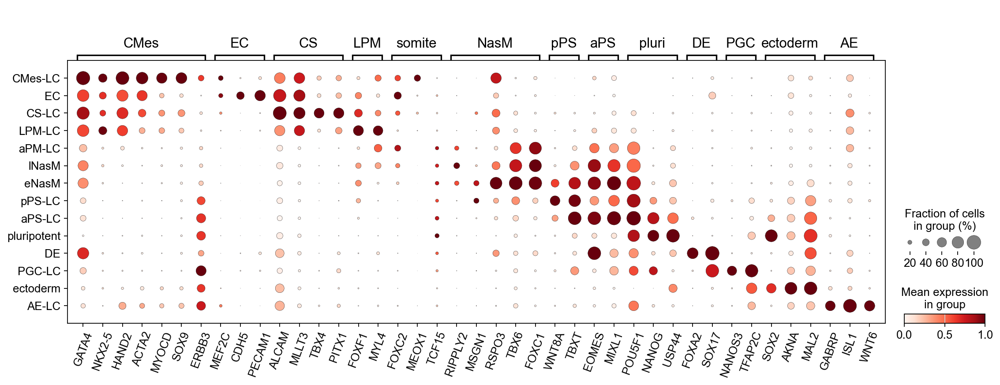

In [ ]:
# gene expression for D2-D10 combined

adata_nostress = adata_int[adata_int.obs['leiden_sub']!='stressed'].copy();

markers = {'CMes':getfullgenenames(adata_int, ['GATA4','NKX2-5','HAND2','ACTA2','MYOCD','SOX9','ERBB3']), #,'HAND2' - 'TBX5', only a small fraction expressed TBX5 while
           'EC': getfullgenenames(adata_int, ['MEF2C','CDH5','PECAM1']),
           'CS': getfullgenenames(adata_int, ['ALCAM','MLLT3','TBX4','PITX1']),
           'LPM': getfullgenenames(adata_int, ['FOXF1','MYL4']), # HAND1
           'somite': getfullgenenames(adata_int, ['FOXC2','MEOX1','TCF15']),
           'NasM': getfullgenenames(adata_int, ['RIPPLY2','MSGN1','RSPO3','TBX6','FOXC1']),
           'pPS': getfullgenenames(adata_int, ['WNT8A','TBXT']),
           'aPS': getfullgenenames(adata_int, ['EOMES','MIXL1']),
           'pluri': getfullgenenames(adata_int, ['POU5F1','NANOG','USP44']),
           'DE': getfullgenenames(adata_int, ['FOXA2','SOX17']),
           'PGC': getfullgenenames(adata_int, ['NANOS3','TFAP2C']),
           'ectoderm': getfullgenenames(adata_int, ['SOX2','AKNA','MAL2']),
           'AE': getfullgenenames(adata_int, ['GABRP','ISL1','WNT6']),}

order=['CMes-LC','EC','CS-LC','LPM-LC','aPM-LC','lNasM','eNasM','pPS-LC','aPS-LC','pluripotent','DE','PGC-LC','ectoderm','AE-LC',];

sc.set_figure_params(figsize=(5,5))
sc.tl.dendrogram(adata_nostress, groupby = 'leiden_sub_sub2', use_rep = 'X_scvi')
ax_dict = sc.pl.dotplot(adata_nostress, markers, categories_order=order, groupby='leiden_sub_sub2', dendrogram=False, show=False, standard_scale='var',var_group_rotation=0);#, return_fig=True);
ax_dict['mainplot_ax'].set_xticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_xticklabels()]);
plt.setp(ax_dict['mainplot_ax'].get_xticklabels(), rotation=70);
#plt.savefig(dataDir+"dotplot_integrated_d2-d10.png",dpi=300, bbox_inches = "tight")
plt.savefig(dataDir+"dotplot_integrated_d2-d10.pdf",dpi=300, bbox_inches = "tight")

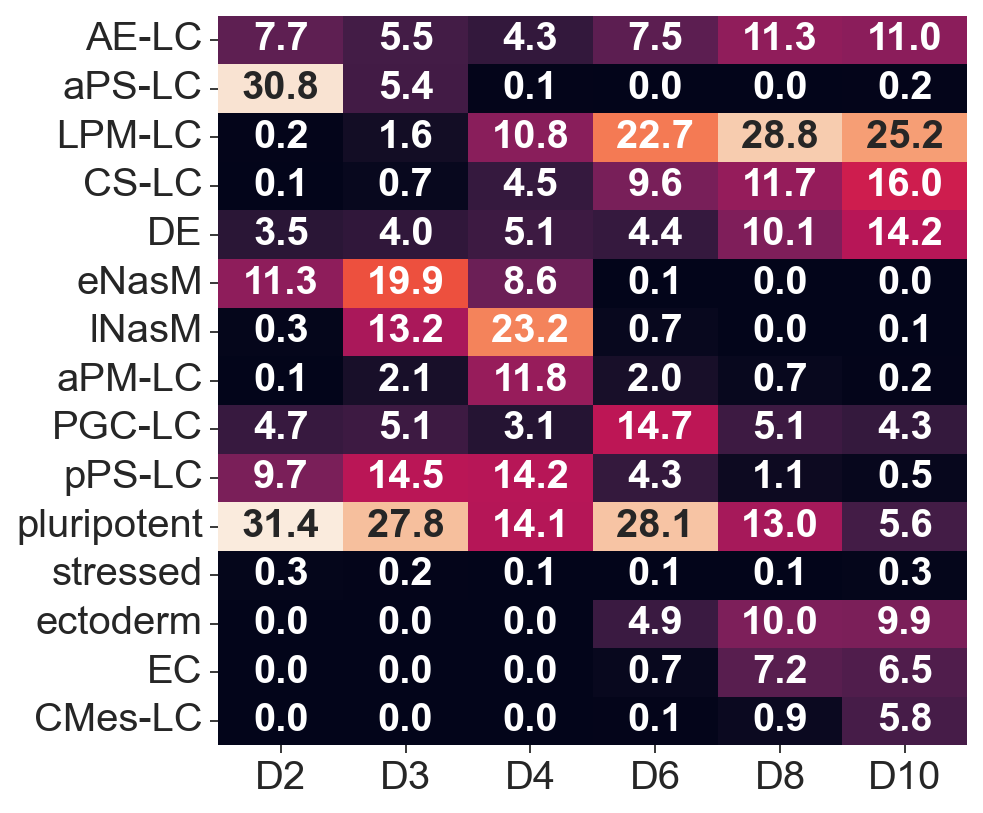

In [ ]:
# percentage of cells in each cluster for each time point

for group in ['time']:#, 'sample_labels'
    obs_tab = adata_int.obs.copy()
    obs_summary = obs_tab.groupby(['leiden_sub_sub2', group])[['_scvi_batch']].count()
    leiden_cell_count = obs_summary.groupby(group).transform(lambda x: x.sum())
    percentmap = obs_summary / leiden_cell_count * 100
    percentmap = percentmap.pivot_table(index='leiden_sub_sub2', columns=group);
    percentmap.columns = [j for (i,j) in percentmap.columns];

    import seaborn as sns
    fs = 18;
    plt.figure(figsize=(6, 6))
    sns.set_style('ticks');
    h = sns.heatmap(percentmap, annot=True, cbar=False, annot_kws={"size": fs},fmt='.1f')
    #h.set_xticklabels(colnames, rotation=45) #column index has format ("cell_type", sample name), get sample name only
    h.set_xlabel('')
    h.set_ylabel('')
    for text in h.texts:
        text.set_fontweight('bold')
    for label in h.xaxis.get_ticklabels():
    #    label.set_fontweight('bold')
        label.set_fontsize(fs)
    for label in h.yaxis.get_ticklabels():
    #    label.set_fontweight('bold')
        label.set_fontsize(fs)
    plt.savefig(dataDir + 'heatmap_fatepercentageby'+group+'_d2-d10.png', bbox_inches='tight')

### D10 alone

In [ ]:
adata_d10 = adata_int[adata_int.obs['time']=='D10'].copy();

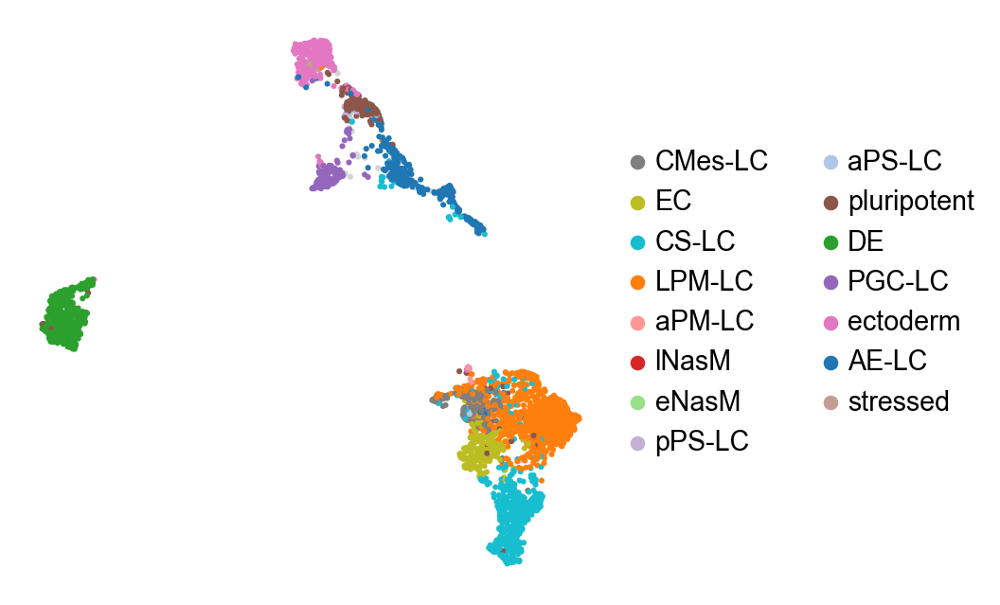

In [ ]:
sc.pp.neighbors(adata_d10, n_neighbors=30, use_rep="X_scvi")
sc.tl.umap(adata_d10, min_dist=0.1)

# mypalette = sb.color_palette('tab20', 20).copy();
# mypalette[3] = mypalette[18];
# mypalette[13] = mypalette[16];
# mypalette = dict(zip(adata_int.obs['leiden_sub_sub2'].cat.categories, mypalette[0:15]));

sc.pl.umap(adata_d10,
           color=['leiden_sub_sub2_ordered'],
           palette = mypalette,
           na_in_legend=False,
            frameon=False,
           title="",
          save='d10_subcluster_sorted.pdf')

In [ ]:
# remove clusters representing < 0.5% of cells

for group in ['time']:
    obs_tab = adata_int.obs.copy()
    obs_summary = obs_tab.groupby(['leiden_sub_sub2', group])[['_scvi_batch']].count()
    leiden_cell_count = obs_summary.groupby(group).transform(lambda x: x.sum())
    percentmap = obs_summary / leiden_cell_count * 100
    percentmap = percentmap.pivot_table(index='leiden_sub_sub2', columns=group);
    percentmap.columns = [j for (i,j) in percentmap.columns];

index = np.ones(adata_d10.obs['leiden_sub_sub2'].shape, dtype=bool)
for c in percentmap['D10'][percentmap['D10'] < 0.5].index:
    index = np.logical_and(index, adata_d10.obs['leiden_sub_sub2']!=c);

adata_d10 = adata_d10[index]

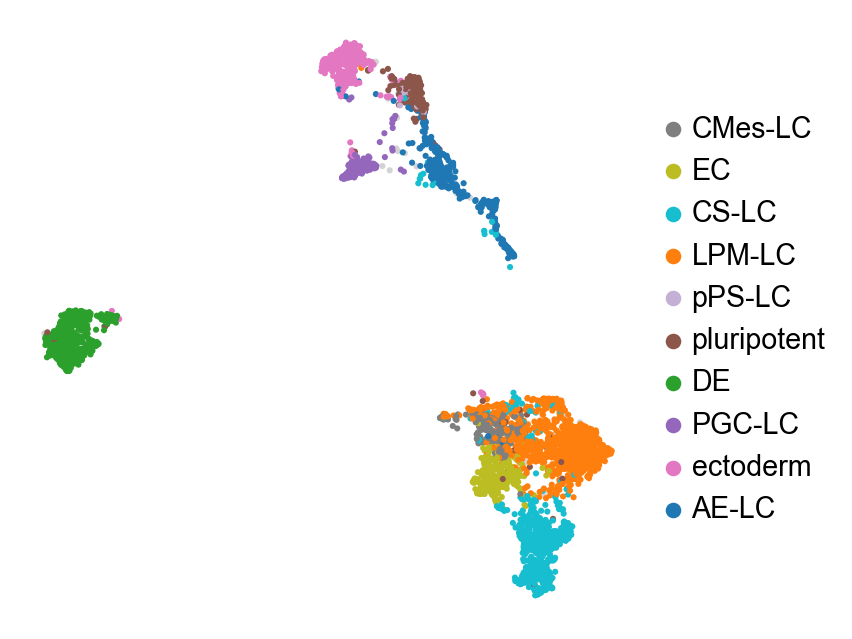

In [ ]:
sc.pp.neighbors(adata_d10, n_neighbors=30, use_rep="X_scvi")
sc.tl.umap(adata_d10, min_dist=0.1)

# mypalette = sb.color_palette('tab20', 20).copy();
# mypalette[3] = mypalette[18];
# mypalette[13] = mypalette[16];
# mypalette = dict(zip(adata_int.obs['leiden_sub_sub2'].cat.categories, mypalette[0:15]));

sc.pl.umap(adata_d10,
           color=['leiden_sub_sub2_ordered'],
           palette = mypalette,
           na_in_legend=False,
            frameon=False,
           title="",
          save='d10_subcluster_sorted.pdf')

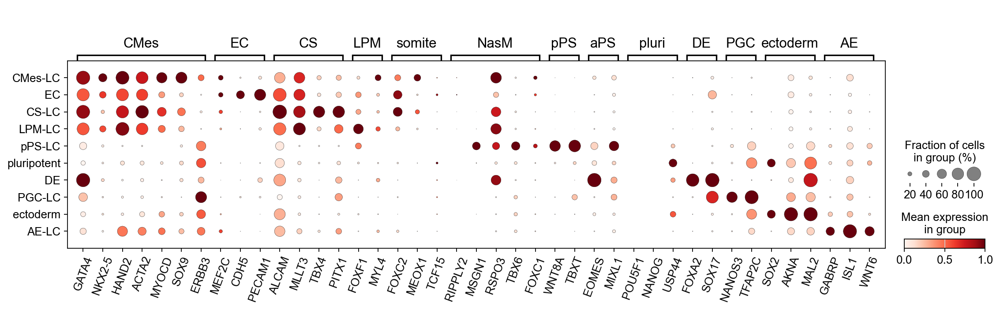

In [ ]:
markers = {'CMes':getfullgenenames(adata_int, ['GATA4','NKX2-5','HAND2','ACTA2','MYOCD','SOX9','ERBB3']), #,'HAND2' - 'TBX5', only a small fraction expressed TBX5 while
           'EC': getfullgenenames(adata_int, ['MEF2C','CDH5','PECAM1']),
           'CS': getfullgenenames(adata_int, ['ALCAM','MLLT3','TBX4','PITX1']),
           'LPM': getfullgenenames(adata_int, ['FOXF1','MYL4']), # HAND1
           'somite': getfullgenenames(adata_int, ['FOXC2','MEOX1','TCF15']),
           'NasM': getfullgenenames(adata_int, ['RIPPLY2','MSGN1','RSPO3','TBX6','FOXC1']),
           'pPS': getfullgenenames(adata_int, ['WNT8A','TBXT']),
           'aPS': getfullgenenames(adata_int, ['EOMES','MIXL1']),
           'pluri': getfullgenenames(adata_int, ['POU5F1','NANOG','USP44']),
           'DE': getfullgenenames(adata_int, ['FOXA2','SOX17']),
           'PGC': getfullgenenames(adata_int, ['NANOS3','TFAP2C']),
           'ectoderm': getfullgenenames(adata_int, ['SOX2','AKNA','MAL2']),
           'AE': getfullgenenames(adata_int, ['GABRP','ISL1','WNT6']),}

order=['CMes-LC','EC','CS-LC','LPM-LC','pPS-LC','pluripotent','DE','PGC-LC','ectoderm','AE-LC',];

sc.set_figure_params(figsize=(5,5))
sc.tl.dendrogram(adata_d10, groupby = 'leiden_sub_sub2', use_rep = 'X_scvi')
ax_dict = sc.pl.dotplot(adata_d10, markers, categories_order=order, groupby='leiden_sub_sub2', dendrogram=False, show=False, standard_scale='var',var_group_rotation=0);#, return_fig=True);
ax_dict['mainplot_ax'].set_xticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_xticklabels()]);
plt.setp(ax_dict['mainplot_ax'].get_xticklabels(), rotation=70);
#plt.savefig(dataDir+"dotplot_integrated_d2-d10.png",dpi=300, bbox_inches = "tight")
plt.savefig(dataDir+"dotplot_d10.pdf",dpi=300, bbox_inches = "tight")

#### Endothelial subtype analysis

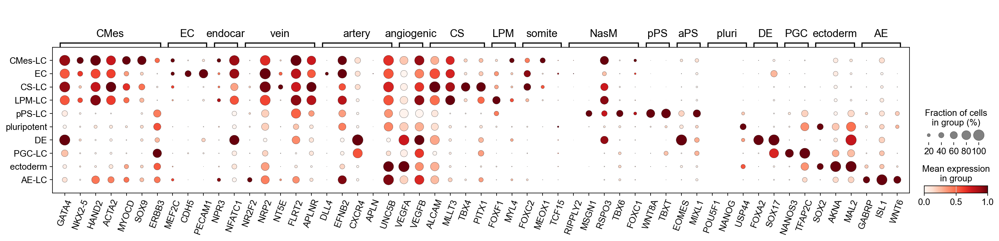

In [ ]:
# d10 gene expression with extended panel of endothelial and angiogenic genes for supp figure

markers = {'CMes':getfullgenenames(adata_int, ['GATA4','NKX2-5','HAND2','ACTA2','MYOCD','SOX9','ERBB3']), #,'HAND2' - 'TBX5', only a small fraction expressed TBX5 while
           'EC': getfullgenenames(adata_int, ['MEF2C','CDH5','PECAM1']),
           'endocar': getfullgenenames(adata_int,  ["NPR3","NFATC1"]), # NPR3, NFATC1 - endocardium
           'vein': getfullgenenames(adata_int, ['NR2F2','NRP2','NT5E','FLRT2','APLNR']), # venous marker (Loh) , 
           'artery': getfullgenenames(adata_int, ["DLL4","EFNB2","CXCR4",'APLN',"UNC5B"]), # arterial (Loh)
           'angiogenic': getfullgenenames(adata_int,  ["VEGFA","VEGFB"]), # "PGF"
           'CS': getfullgenenames(adata_int, ['ALCAM','MLLT3','TBX4','PITX1']),
           'LPM': getfullgenenames(adata_int, ['FOXF1','MYL4']), # HAND1
           'somite': getfullgenenames(adata_int, ['FOXC2','MEOX1','TCF15']),
           'NasM': getfullgenenames(adata_int, ['RIPPLY2','MSGN1','RSPO3','TBX6','FOXC1']),
           'pPS': getfullgenenames(adata_int, ['WNT8A','TBXT']),
           'aPS': getfullgenenames(adata_int, ['EOMES','MIXL1']),
           'pluri': getfullgenenames(adata_int, ['POU5F1','NANOG','USP44']),
           'DE': getfullgenenames(adata_int, ['FOXA2','SOX17']),
           'PGC': getfullgenenames(adata_int, ['NANOS3','TFAP2C']),
           'ectoderm': getfullgenenames(adata_int, ['SOX2','AKNA','MAL2']),
           'AE': getfullgenenames(adata_int, ['GABRP','ISL1','WNT6']),
           }

order=['CMes-LC','EC','CS-LC','LPM-LC','pPS-LC','pluripotent','DE','PGC-LC','ectoderm','AE-LC',];

sc.set_figure_params(figsize=(5,5))
sc.tl.dendrogram(adata_d10, groupby = 'leiden_sub_sub2', use_rep = 'X_scvi')
ax_dict = sc.pl.dotplot(adata_d10, markers, categories_order=order, groupby='leiden_sub_sub2', dendrogram=False, show=False, standard_scale='var',var_group_rotation=0);#, return_fig=True);
ax_dict['mainplot_ax'].set_xticklabels([g.get_text().split()[0] for g in ax_dict['mainplot_ax'].get_xticklabels()]);
plt.setp(ax_dict['mainplot_ax'].get_xticklabels(), rotation=70);
#plt.savefig(dataDir+"dotplot_integrated_d2-d10.png",dpi=300, bbox_inches = "tight")
plt.savefig(dataDir+"dotplot_d10_all.pdf",dpi=300, bbox_inches = "tight")

##### human CS12 endothelial subtype comparison

In [ ]:
adata_human_organ = sc.read_h5ad('BC/human_CS12_16/adata_human_organogenesis_xu.h5ad')

In [ ]:
#marker selection
CMes= [g for g in adata_human_organ.raw.var_names if g.split()[0] in ['GATA4','NKX2-5','HAND2','ACTA2','MYOCD','SOX9','ERBB3']];#'ATF4''NR2F2''MSX2',MEIS2','PBX1'
EC = [g for g in adata_human_organ.raw.var_names if g.split()[0] in ['MEF2C','CDH5','PECAM1']]; # CDX2'HOXA1','ALX3',,'TBX5'
endocar = [g for g in adata_human_organ.raw.var_names if g.split()[0] in ["NPR3","NFATC1"]]#"MSGN1",
vein = [g for g in adata_human_organ.raw.var_names if g.split()[0] in ['NR2F2','NRP2','NT5E','FLRT2','APLNR']]#"MSGN1"
artery = [g for g in adata_human_organ.raw.var_names if g.split()[0] in ["DLL4","EFNB2","CXCR4",'APLN',"UNC5B"]]
angiogenic = [g for g in adata_human_organ.raw.var_names if g.split()[0] in ["VEGFA","VEGFB"]]#"PGF"

marker_genes_dict = {'CMes':CMes,'EC':EC,'endocar':endocar, 'vein':vein, 'artery':artery, 'angiogenic':angiogenic}
marker_genes_dict['CMes'] = ['GATA4','NKX2-5','HAND2','ACTA2','MYOCD','SOX9','ERBB3']
marker_genes_dict['vein'] = ['NR2F2','NRP2','NT5E','FLRT2','APLNR']
marker_genes_dict['artery'] = ["DLL4","EFNB2","CXCR4",'APLN',"UNC5B"]
marker_genes_dict['angiogenic'] = ["VEGFA","VEGFB"]#,"PGF"

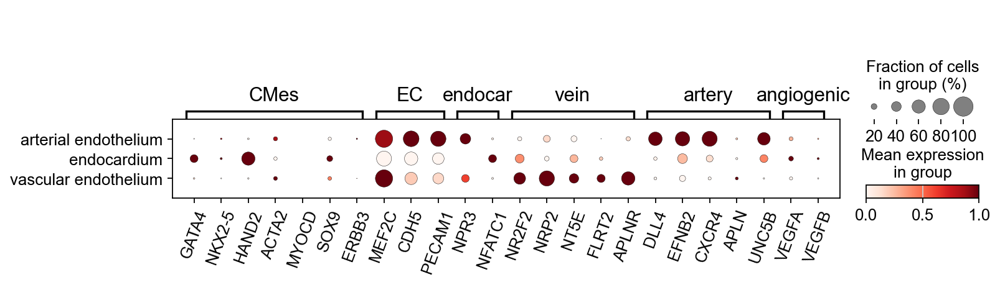

In [ ]:
#endothelial and angiogenic genes in human CS12 to compare with our D10 2D gastruloids for supp figure
sc.set_figure_params(figsize = (10, 10))#, fontsize = 12
dot_ax = sc.pl.dotplot(
    adata_human_organ[adata_human_organ.obs['stage'].str.contains('12')&adata_human_organ.obs['annotation'].str.contains('arterial endothelium|endocardium|vascular endothelium')],
    marker_genes_dict,
    groupby = 'annotation',
    #var_names = [
    #    'FOXC2', 'MEOX1', 'TCF15','HAND2','MSX2','TBX5','PITX1','MEIS2','PBX1','NR2F2','PITX2','ALX3','GATA6','PAX3','DMRT2','PAX1'
    #],
    #swap_axes = True,
    show = False,
    use_raw = True,
    standard_scale='var',
    dot_max = 1,
    #title = 'CS12',
    var_group_rotation=0,
    #fontsize = 12
)
dot_ax['mainplot_ax'].set_xticklabels([g.get_text().split()[0] for g in dot_ax['mainplot_ax'].get_xticklabels()]);#, fontsize = 10
plt.setp(dot_ax['mainplot_ax'].get_xticklabels(), rotation=70)#ha='right'
#plt.savefig('humanCS12_16/dotplot_humanCS12_endothe.pdf',dpi=300, bbox_inches = "tight")
plt.savefig('humanCS12_16/dotplot_humanCS12_endothelial_cells.pdf', format='pdf', bbox_inches="tight")

## Tyser data with our new read mapping

In [ ]:
dataDir = scseqDir + 'human_gastrula/';
annotationFile = dataDir + 'annot_umap.csv';

In [ ]:
enstoname = pd.read_csv(scseqDir + 'human_gastrula/geneInfo.tab',sep='\t',header=None,skiprows=1)
enstoname = pd.DataFrame(enstoname[1].to_numpy(), index=enstoname[0].to_numpy(),columns=['GeneSymbol'])

In [ ]:
enstoname

,GeneSymbol
ENSG00000223972.5,DDX11L1
ENSG00000227232.5,WASH7P
ENSG00000278267.1,MIR6859-1
ENSG00000243485.5,MIR1302-2HG
ENSG00000284332.1,MIR1302-2
...,...
ENSG00000276017.1,ENSG00000276017
ENSG00000278817.1,ENSG00000278817
ENSG00000277196.4,ENSG00000277196
ENSG00000278625.1,U6


In [ ]:
dataraw = pd.read_csv(scseqDir + 'human_gastrula/CraigCounts.csv',sep='\t',index_col='GeneID');
dataraw.drop(columns=['Chr','Start','End','Strand','Length'],inplace=True)
dataraw.columns = [int(g[5:12]) for g in list(dataraw.columns)]

In [ ]:
dataraw = dataraw.transpose()

In [ ]:
dataraw

GeneID,ENSG00000223972.5,ENSG00000227232.5,ENSG00000278267.1,ENSG00000243485.5,ENSG00000284332.1,ENSG00000237613.2,ENSG00000268020.3,ENSG00000240361.2,ENSG00000186092.7,ENSG00000238009.6,...,ENSG00000273739.1,ENSG00000276700.1,ENSG00000276312.1,ENSG00000275757.1,ENSG00000278573.1,ENSG00000276017.1,ENSG00000278817.1,ENSG00000277196.4,ENSG00000278625.1,ENSG00000277374.1
7785279,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
7785280,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7785281,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7785282,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7785283,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,7,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7788385,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7788387,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7788388,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7788390,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# not all names are unique
#len(np.unique(enstoname.loc[dataraw['GeneID']].to_numpy()))
len(np.unique(enstoname.loc[dataraw.columns].to_numpy()))

60347

In [ ]:
# range of cell numbers
max(dataraw.index)- min(dataraw.index)

3112

In [ ]:
# number of genes with actual reads
np.sum(np.sum(dataraw,axis=0)>0)

36362

/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/scprep/plot/utils.py:104: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


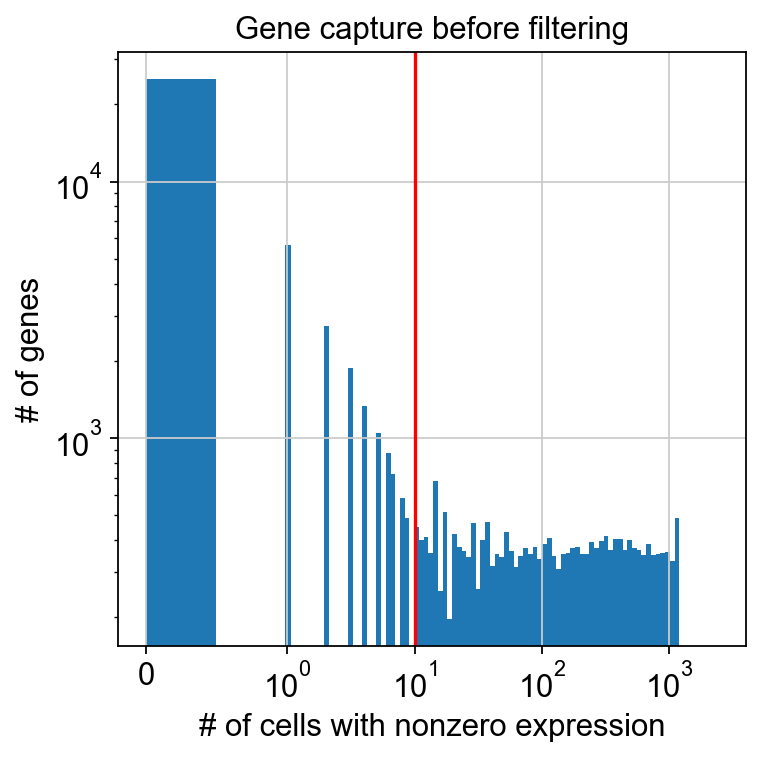

In [ ]:
# filter genes
scprep.plot.histogram(scprep.measure.gene_capture_count(dataraw), log=True, cutoff=10,
                      title="Gene capture before filtering",
                     xlabel='# of cells with nonzero expression',
                     ylabel='# of genes');

In [ ]:
dataraw_filt = scprep.filter.filter_rare_genes(dataraw, min_cells=10)

In [ ]:
len(np.unique(enstoname.loc[dataraw_filt.columns].to_numpy()))

21069

In [ ]:
dataraw_filt.columns

Index(['ENSG00000227232.5', 'ENSG00000243485.5', 'ENSG00000241860.7',
       'ENSG00000279457.4', 'ENSG00000228463.10', 'ENSG00000237094.12',
       'ENSG00000230021.10', 'ENSG00000225972.1', 'ENSG00000225630.1',
       'ENSG00000237973.1',
       ...
       'ENSG00000210195.2', 'ENSG00000210196.2', 'ENSG00000276256.1',
       'ENSG00000273748.1', 'ENSG00000271254.7', 'ENSG00000276345.1',
       'ENSG00000278673.1', 'ENSG00000273554.4', 'ENSG00000278817.1',
       'ENSG00000277196.4'],
      dtype='object', name='GeneID', length=21080)

In [ ]:
dataraw_filt.columns=list(enstoname.loc[dataraw_filt.columns]['GeneSymbol'])

In [ ]:
data_norm, library_size = scprep.normalize.library_size_normalize(dataraw_filt, return_library_size=True)

In [ ]:
data_log = scprep.transform.log(data_norm)

In [ ]:
annotation = pd.read_csv(annotationFile,index_col='Unnamed: 0');
cellname2num = pd.DataFrame(annotation.index, index=[int(g[5:12]) for g in annotation['cell_name']])

In [ ]:
cellname2num.loc[dataraw.index][0]

7785279     545
7785280    1116
7785281     637
7785282     947
7785283     602
           ... 
7788385     699
7788387     370
7788388     441
7788390     392
7788391     180
Name: 0, Length: 1184, dtype: int64

In [ ]:
annotation_raw = annotation.loc[cellname2num.loc[dataraw.index][0]].copy()
annotation_raw.index = cellname2num[0][dataraw.index];
annotation_raw.index.name = 'Cell';
annotation_raw.index = annotation_raw.index.format();

/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/scprep/plot/utils.py:104: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


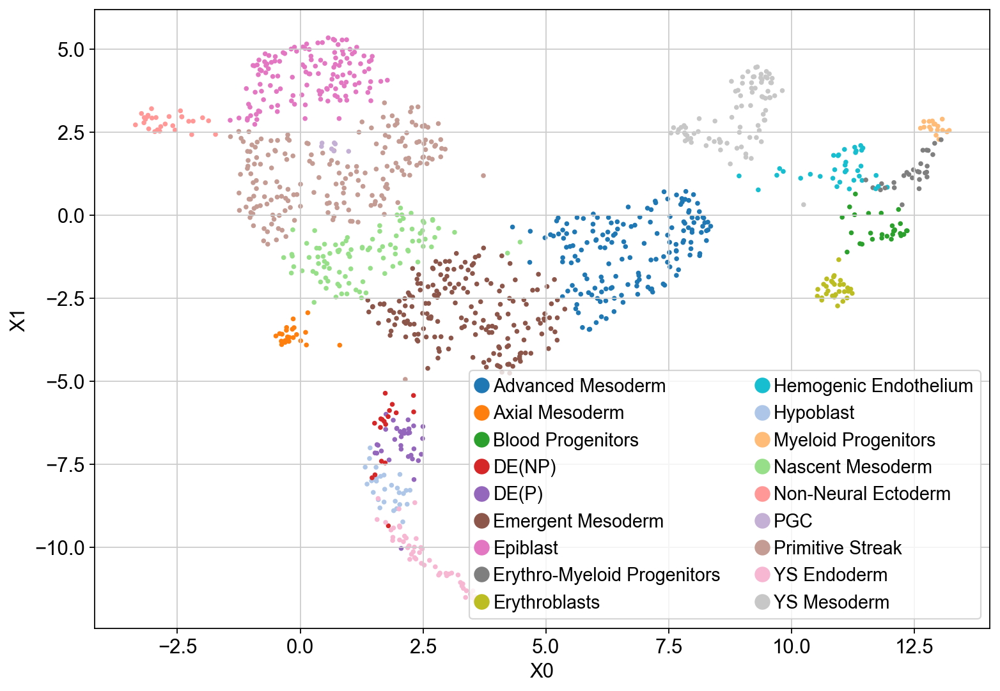

In [ ]:
UMAP = annotation_raw[['X0','X1']];
#scprep.plot.scatter2d(UMAP,c=annotation_raw['cluster_id'],figsize=(10,7),legend=True);
scprep.plot.scatter2d(UMAP,c=annotation_raw['sub_cluster'],figsize=(10,7),legend=True);

/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/scprep/plot/utils.py:104: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


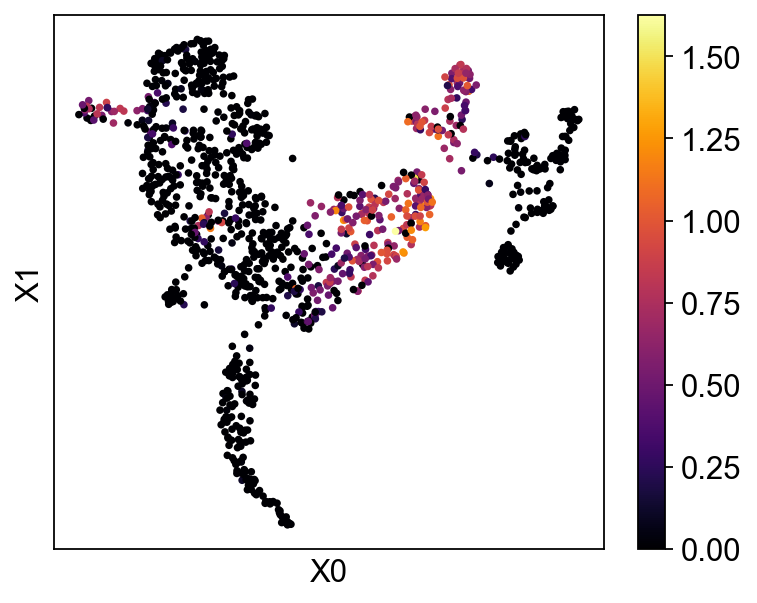

In [ ]:
# check that gene expression looks sensible from Craig's data
scprep.plot.scatter2d(UMAP,c=data_log['HAND1'],figsize=(5,4),legend=True,ticks=False);

### Pre-process for SCVI

In [ ]:
dataraw_filt.index = annotation_raw.index;

In [ ]:
adata_tyser = anndata.AnnData(dataraw_filt, dtype=dataraw_filt.dtypes[1])
adata_tyser.var_names_make_unique()
adata_tyser.layers["counts"] = adata_tyser.X.copy()  # preserve counts
sc.pp.normalize_total(adata_tyser, target_sum=1e4)
sc.pp.log1p(adata_tyser)
adata_tyser.raw = adata_tyser.copy();
adata_tyser.obsm['X_umap']=annotation_raw[['X0','X1']].to_numpy();
adata_tyser.obsm['X_umap_original']=annotation_raw[['X0','X1']].to_numpy();
adata_tyser.obs = annotation_raw[['sub_cluster','cluster_id']].copy();
adata_tyser

/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AnnData object with n_obs × n_vars = 1184 × 21080
    obs: 'sub_cluster', 'cluster_id'
    uns: 'log1p'
    obsm: 'X_umap', 'X_umap_original'
    layers: 'counts'

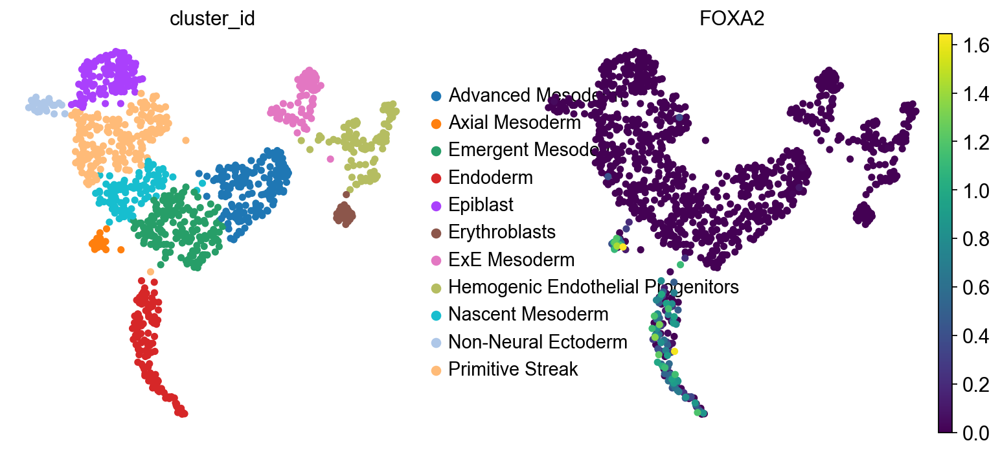

In [ ]:
sc.pl.umap(
    adata_tyser,
    color=['cluster_id','FOXA2'],
    frameon=False,
    ncols=2,
)

In [ ]:
#adata_tyser.write_h5ad(dataDir + 'tyser_craigmapped.h5ad')

## SCVI integration of gastrula and gastruloid

### Establish shared feature lists between datasets

In [369]:
adata_tyser = sc.read_h5ad(scseqDir + 'human_gastrula/tyser_craigmapped.h5ad')
adata2021 = sc.read_h5ad(dataDir + 'adata_timeseries2021_487296.h5ad')
#adata2024 = anndata.read_h5ad(scseqDir + '240205_scRNAseq_0_48_72_96h_9704-BC/adata_timeseries2024_487296.h5ad')
adata2024 = sc.read_h5ad(dataDir + 'adata_timeseries2024_487296_v2.h5ad')

In [370]:
adata2021.obs['sample_labels'] = [g+'-1' for g in adata2021.obs['sample_labels']];
adata2024.obs['sample_labels'] = [g+'-2' for g in adata2024.obs['sample_labels']];

In [371]:
sharedfeat = list(set(adata2024.var_names).intersection(set(adata2021.var_names)));
adata_combined = adata2024[:,sharedfeat].concatenate(adata2021[:,sharedfeat]);

/var/folders/6r/85dgkgjs1dn_nm3zdxyy611w0000gn/T/ipykernel_73268/1873946917.py:2: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_combined = adata2024[:,sharedfeat].concatenate(adata2021[:,sharedfeat]);


In [232]:
adata_all_cc.obs['leiden_sub'].cat.categories

Index(['AE-LC', 'aPS-LC', 'LPM-LC', 'CS-LC', 'DE', 'eNasMe', 'lNasMe',
       'aPM-LC', 'PGC-LC', 'pPS-LC', 'pluripotent', 'stressed'],
      dtype='object')

In [372]:
# strip suffix -0 or -1 
adata_combined.obs_names = [g[:-2] for g in adata_combined.obs_names];

adata_combined.obs['leiden'] = float('nan');
adata_combined.obs['leiden'][adata_all_cc.obs_names] = adata_all_cc.obs['leiden'].copy();

adata_combined.obs['leiden_sub'] = float('nan'); 
adata_combined.obs['leiden_sub'][adata_all_cc.obs_names] = adata_all_cc.obs['leiden_sub'].copy();

/var/folders/6r/85dgkgjs1dn_nm3zdxyy611w0000gn/T/ipykernel_73268/3267343481.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_combined.obs['leiden'][adata_all_cc.obs_names] = adata_all_cc.obs['leiden'].copy();
/var/folders/6r/85dgkgjs1dn_nm3zdxyy611w0000gn/T/ipykernel_73268/3267343481.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_combined.obs['leiden_sub'][adata_all_cc.obs_names] = adata_all_cc.obs['leiden_sub'].copy();


In [373]:
trimmedfeaturenames = [g.split()[0] for g in adata_combined.var_names];

In [374]:
sharedfeat = list(set(adata_tyser.var_names) & set(trimmedfeaturenames));
print(len(sharedfeat))

# define shared features as those that are not duplicated (to avoid ambiguity)
from collections import Counter
#counts = Counter(data_filt[conditions[0]].columns);
counts = Counter(adata_combined.var_names);
duplicatefeats = [key for key in counts.keys() if counts[key]>1]
sharedfeat = list(set(sharedfeat) - set(duplicatefeats));
print(len(sharedfeat))

13537
13537


In [375]:
adata_tyser_hvg = adata_tyser.copy();
sc.pp.highly_variable_genes(
    adata_tyser_hvg,
    n_top_genes=2000,
    subset=True,
    layer="counts",
    flavor="seurat_v3",
)
adata_tyser_hvg

AnnData object with n_obs × n_vars = 1184 × 2000
    obs: 'sub_cluster', 'cluster_id'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'cluster_id_colors', 'log1p', 'hvg'
    obsm: 'X_umap', 'X_umap_original'
    layers: 'counts'

In [376]:
sharedhvg = list(set(adata_tyser_hvg.var_names) & set(trimmedfeaturenames));

In [377]:
sharedhvg = list(set(adata_tyser_hvg.var_names) & set(trimmedfeaturenames));
adata_tyser_hvg = adata_tyser_hvg[:, sharedhvg].copy();

In [378]:
fullsharedfeaturenames = [g for g in adata_combined.var_names if g.split()[0] in sharedhvg];
len(fullsharedfeaturenames)

1338

In [379]:
gene_names = [g.split()[0] for g in fullsharedfeaturenames]
ensembol_ids = [g.split()[1] for g in fullsharedfeaturenames]
gene2ensembol = dict(zip(gene_names, ensembol_ids))
full_var_names = [g + ' ' + gene2ensembol[g] for g in adata_tyser_hvg.var_names]
adata_tyser_hvg.var_names = full_var_names;

In [380]:
adata_combined = adata_combined[:,fullsharedfeaturenames].copy();

In [419]:
adata_combined.write_h5ad(dataDir + '240925_adata_combined.h5ad')

In [381]:
adata_tyser_hvg.write_h5ad(dataDir + '240925_adata_tyser_hvg.h5ad')

In [287]:
# to prove that all genes are still there in .raw

print('TBXT' in sharedhvg)
print('SOX17' in sharedhvg)

mygenes = ['TBXT', 'SOX17'];

sc.pp.neighbors(adata_combined)
sc.tl.umap(adata_combined)

True
False
         Falling back to preprocessing with `sc.pp.pca` and default params.


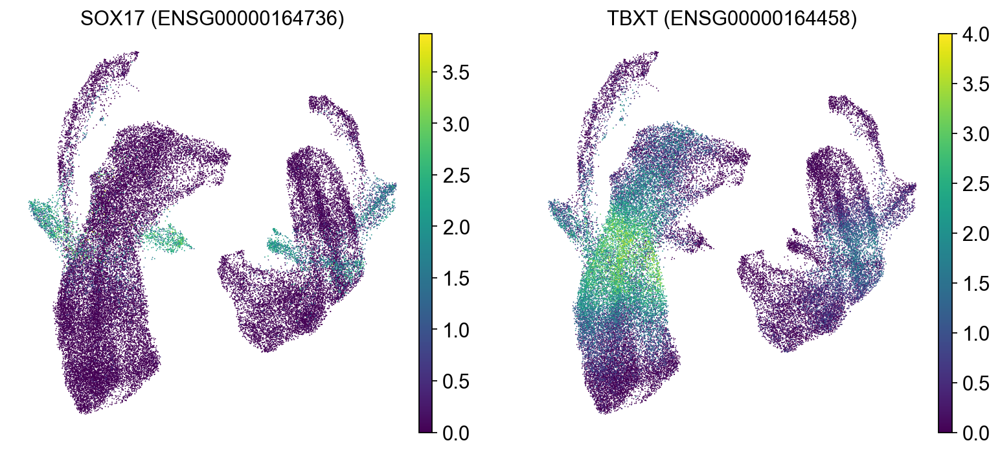

In [293]:
sc.pl.umap(
    adata_combined,
    use_raw=True,
    color=[g for g in adata_combined.raw.var_names if g.split()[0] in mygenes],
    frameon=False,
    ncols=2,
)

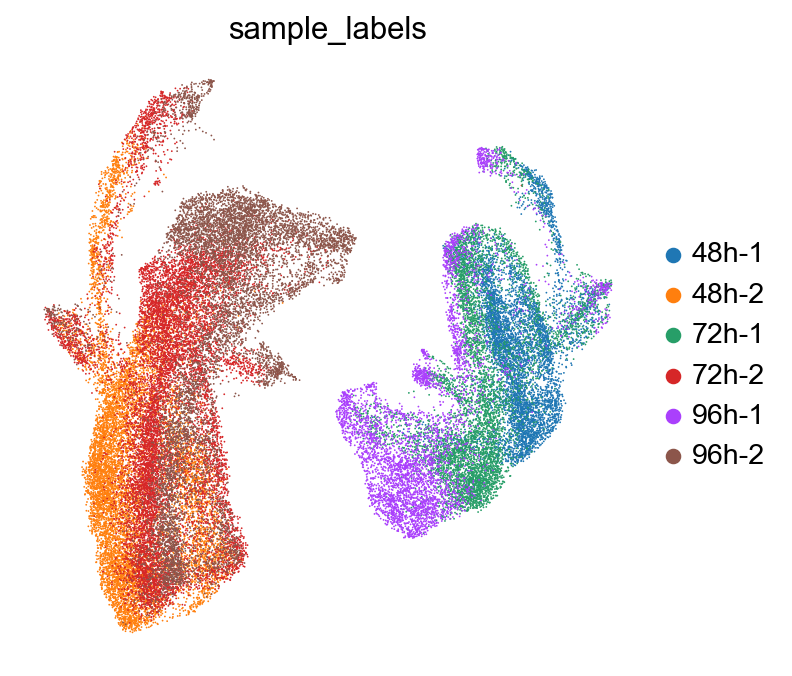

In [289]:
sc.pl.umap(
    adata_combined,
    use_raw=True,
    color=['sample_labels'],
    frameon=False,
    ncols=2,
)

### SCVI integration

In [8]:
adata_combined = sc.read_h5ad(dataDir + '/240925_adata_combined.h5ad')
adata_tyser_hvg = sc.read_h5ad(dataDir + '/240925_adata_tyser_hvg.h5ad')

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=15` in the `DataLoader` to improve performance.
/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Epoch 400/400: 100%|███████████████████| 400/400 [01:22<00:00,  4.83it/s, v_num=1, train_loss_step=988, train_loss_epoch=977]

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|███████████████████| 400/400 [01:22<00:00,  4.83it/s, v_num=1, train_loss_step=988, train_loss_epoch=977]


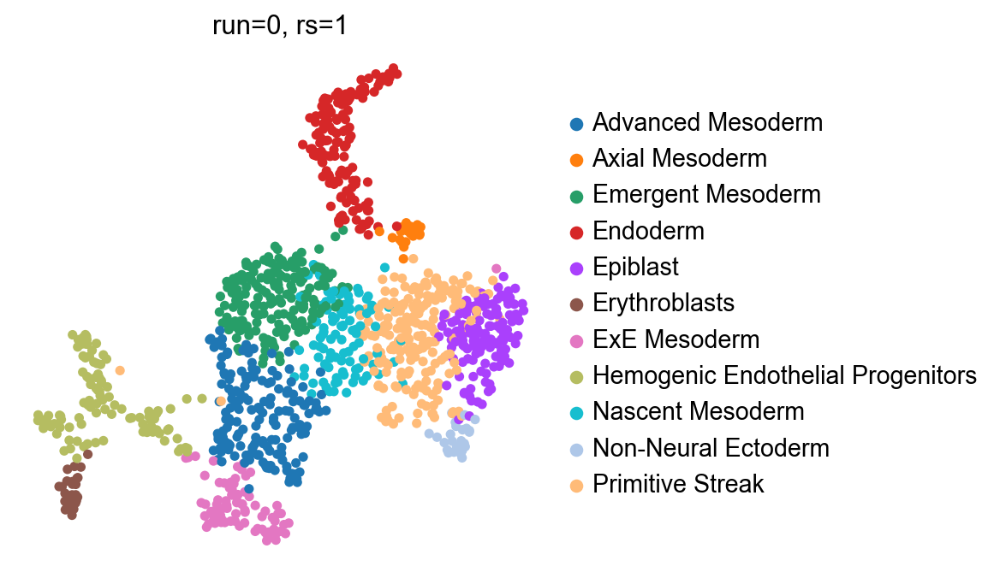

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=15` in the `DataLoader` to improve performance.
/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Epoch 400/400: 100%|██████████████████| 400/400 [01:16<00:00,  5.68it/s, v_num=1, train_loss_step=1e+3, train_loss_epoch=985]

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|██████████████████| 400/400 [01:16<00:00,  5.25it/s, v_num=1, train_loss_step=1e+3, train_loss_epoch=985]


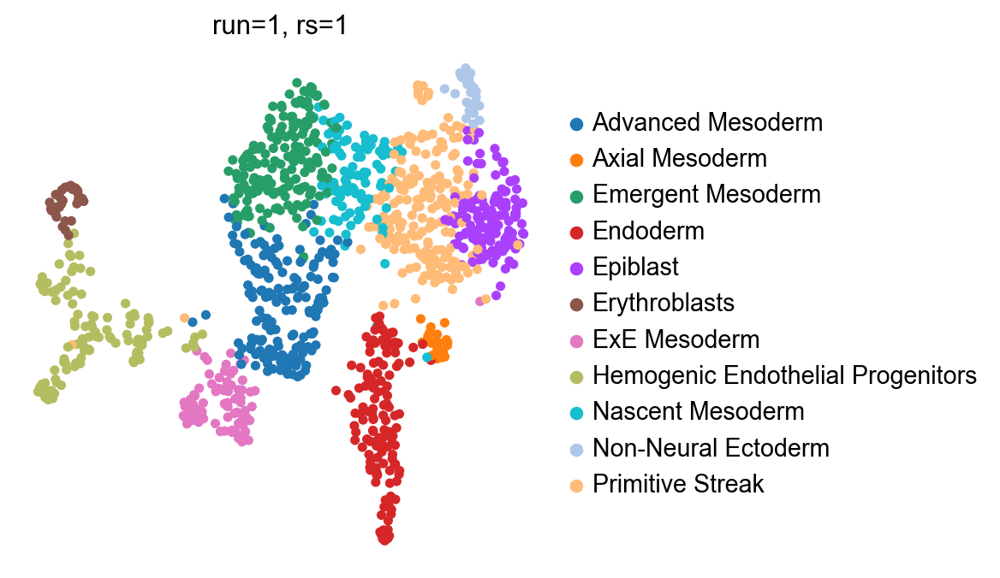

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=15` in the `DataLoader` to improve performance.
/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Epoch 400/400: 100%|███████████████████| 400/400 [01:09<00:00,  5.71it/s, v_num=1, train_loss_step=975, train_loss_epoch=970]

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|███████████████████| 400/400 [01:09<00:00,  5.74it/s, v_num=1, train_loss_step=975, train_loss_epoch=970]


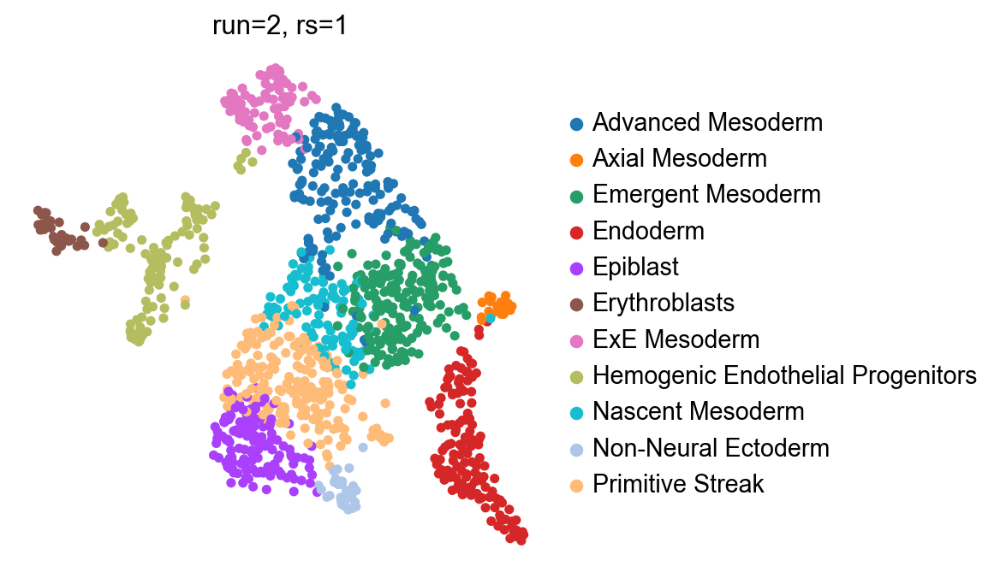

In [ ]:
# train SCVI reference

for i in range(0,3):

    # SAVE OR LOAD the reference model

    # non-fine tuned model
    # dir_path = dataDir + "gastrula_model_240925_" + str(i) + "/"
    
    dir_path = dataDir + "gastrula_model_240925_fine3-" + str(i) + "/"
    if os.path.isdir(dir_path):
        vae_ref = scvi.model.SCVI.load(dir_path, adata_tyser_hvg);
        
    else:
        scvi.model.SCVI.setup_anndata(adata_tyser_hvg, layer = "counts") # batch_key = "sample_labels"

        arches_params = dict(
            use_layer_norm="both",
            use_batch_norm="none",
            encode_covariates=True,
            dropout_rate = 0.1,
            n_layers = 2,
        )

        # non-fine tuned parameters
        # arches_params = dict(
        #     use_layer_norm="both",
        #     use_batch_norm="none",
        #     encode_covariates=True,
        #     dropout_rate=0.2,
        #     n_latent=20,
        #     n_layers=2,
        # )
        
        vae_ref = scvi.model.SCVI(adata_tyser_hvg, n_latent = 50, n_hidden = 256, gene_likelihood="zinb", **arches_params)
        vae_ref.train()
        vae_ref.save(dir_path, overwrite=True)

    adata_tyser_hvg.obsm["X_scVI"] = vae_ref.get_latent_representation()
    sc.pp.neighbors(adata_tyser_hvg, use_rep="X_scVI")

    for rs in [1]: #range(0,3):
        sc.tl.umap(adata_tyser_hvg, random_state=rs) 
        #print("run="+str(i)+", rs="+str(rs))
        sc.pl.umap(
            adata_tyser_hvg,
            color=['cluster_id'],#,'sub_cluster'],
            frameon=False,
            title="run="+str(i)+", rs="+str(rs),
            ncols=2,
            #save = "_scvi"+"run="+str(i)+", rs="+str(rs)+".png", # non-fine tuned
            save = "_scvi_fine3-"+"run="+str(i)+", rs="+str(rs)+".png",
        )

INFO     File                                                                                                      
         /Users/idse/data_tmp/scRNAseq/240205_scRNAseq_0_48_72_96h_9704-BC/gastrula_model_240925_fine3-0/model.pt  
         already downloaded                                                                                        
INFO     Found 100.0% reference vars in query data.                                                                


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=15` in the `DataLoader` to improve performance.


Epoch 200/200: 100%|███████████| 200/200 [19:28<00:00,  5.48s/it, v_num=1, train_loss_step=1.16e+3, train_loss_epoch=1.21e+3]

`Trainer.fit` stopped: `max_epochs=200` reached.


Epoch 200/200: 100%|███████████| 200/200 [19:28<00:00,  5.84s/it, v_num=1, train_loss_step=1.16e+3, train_loss_epoch=1.21e+3]


/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/var/folders/6r/85dgkgjs1dn_nm3zdxyy611w0000gn/T/ipykernel_73268/463132981.py:51: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_full = ref.concatenate(query, batch_categories=['Reference','Query'], batch_key='dataset');
/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/opt/anaconda3/envs/scvi/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: Implicit

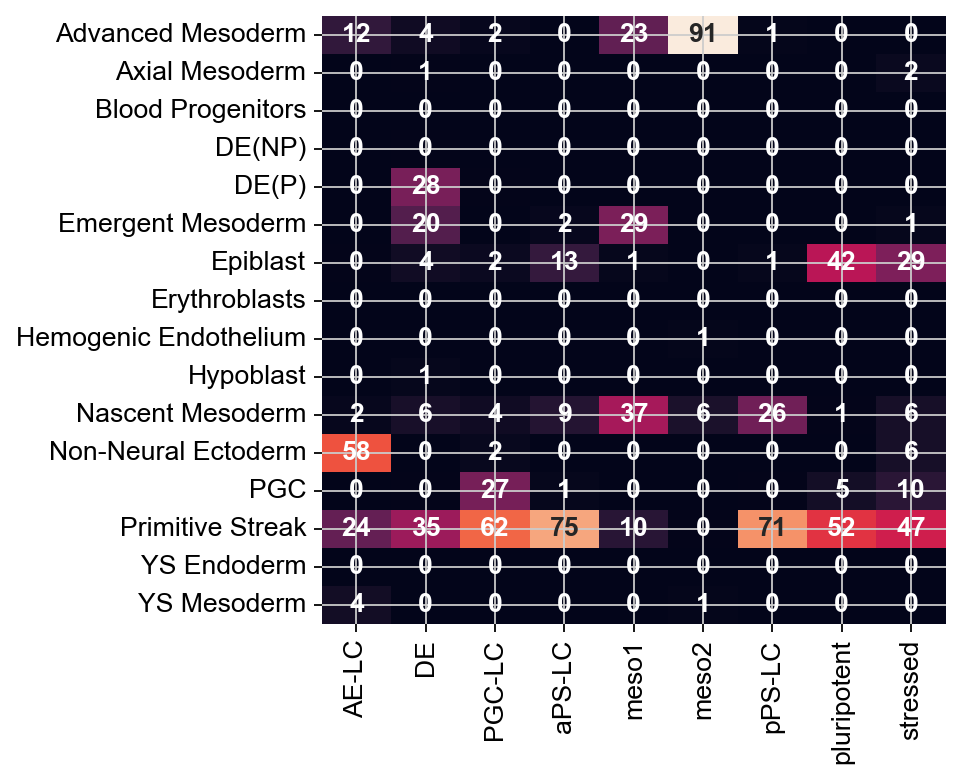

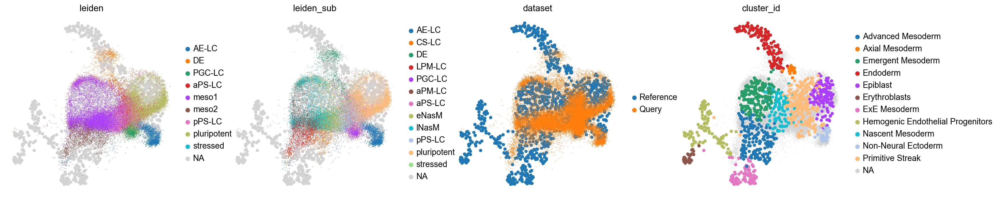

In [ ]:
# train SCVI query

for i in [0]:
    
    dir_path = dataDir + "gastrula_model_240925_fine3-" + str(i) + "/"
    vae_ref = scvi.model.SCVI.load(dir_path, adata_tyser_hvg);
    adata_tyser_hvg.obsm["X_scVI"] = vae_ref.get_latent_representation()

    for rs in [0]:#range(0,5):
        sc.pp.neighbors(adata_tyser_hvg, use_rep="X_scVI")
        sc.tl.umap(adata_tyser_hvg, random_state=rs)
    
        dir_path = dataDir + "gastruloid_all_query_model_240925_fine3-" + str(i) + "/"
        if os.path.isdir(dir_path):
            vae_q = scvi.model.SCVI.load(dir_path, adata_combined);
            
        else:
            scvi.model.SCVI.prepare_query_anndata(adata_combined, vae_ref)
            #scvi.model.SCVI.prepare_query_anndata(adata_query, dir_path)  # both are valid
        
            # MAP GASTRULOIDS TO THE SAME SPACE AS GASTRULA
            # create query model instance
            vae_q = scvi.model.SCVI.load_query_data(
                adata_combined,
                vae_ref,
            )
            vae_q.train(max_epochs=200, plan_kwargs=dict(weight_decay=0.0))
        
            # save/load the reference model 
            vae_q.save(dir_path, overwrite=True)
        
        # reorder variables if necessary
        adata_combined = adata_combined[:,adata_tyser_hvg.var_names].copy();
        adata_combined.obsm["X_scVI"] = vae_q.get_latent_representation()
    
        ref = adata_tyser_hvg.copy();
        query = adata_combined.copy();
    
        for method in ['ingest']:
        
            if method=='ingest':
                query.X = query.X.toarray();
                sc.tl.ingest(query, ref, embedding_method = 'umap', obs='sub_cluster')
                mybasis = 'X_umap'; #_ingest
        
            elif method=='umap':
                trans = umap.UMAP(n_neighbors=20, min_dist=0.5, spread=1.0, n_components=2, n_epochs=500, learning_rate=1.0, negative_sample_rate=5, init='spectral', random_state=0, a=None, b=None).fit(ref.obsm['X_scVI'])
                ref.obsm['X_umap_UMAP'] = trans.embedding_;
                umap_query = trans.transform(query.obsm['X_scVI']);
                query.obsm['X_umap_UMAP'] = umap_query;
                mybasis = 'X_umap_UMAP'; #_ingest
            
            adata_full = ref.concatenate(query, batch_categories=['Reference','Query'], batch_key='dataset');

            if method=='ingest':
                clustertype = 'leiden';
                predicttype = 'sub_cluster';#'knnpred_sub';
                obs_tab = adata_full[adata_full.obs['dataset'] == 'Query'].obs.copy()
                obs_summary = obs_tab.groupby([clustertype,predicttype])[['batch']].count() # batch is just a random column without nan
                
                leiden_cell_count = obs_summary.groupby(clustertype).transform(lambda x: x.sum())
                percentmap = obs_summary / leiden_cell_count * 100
                percentmap = percentmap.pivot_table(index=predicttype, columns=clustertype);
                percentmap.columns = [j for (i,j) in percentmap.columns];
                
                # if clustertype == 'leiden':
                #     percentmap = percentmap[['AdvMe','NasM','APS-LC','PPS-LC']].loc[['Advanced Mesoderm','Emergent Mesoderm','Nascent Mesoderm','Primitive Streak','ExE Mesoderm']]
                #     colnames = ['AdvMe','NasMe','APS-LC','PPS-LC'];
                # else:
                #     percentmap = percentmap[['LPM-LC','CS-LC', 'NasMe','PS-LC','PM-LC']].loc[['Advanced Mesoderm','Emergent Mesoderm','Nascent Mesoderm','Primitive Streak','ExE Mesoderm']]
                #     colnames = ['LPM-LC','CS-LC', 'NasMe','PS-LC','PM-LC'];
                    
                import seaborn as sns
                fs = 12;
                plt.figure(figsize=(5, 5))
                h = sns.heatmap(percentmap, annot=True, cbar=False, annot_kws={"size": fs},fmt='.0f')
                #h.set_xticklabels(colnames, rotation=45) #column index has format ("cell_type", sample name), get sample name only
                h.set_xlabel('')
                h.set_ylabel('')
                for text in h.texts:
                    text.set_fontweight('bold')
                for label in h.xaxis.get_ticklabels():
                #    label.set_fontweight('bold')
                    label.set_fontsize(fs)
                for label in h.yaxis.get_ticklabels():
                #    label.set_fontweight('bold')
                    label.set_fontsize(fs)
                plt.savefig(dataDir + 'heatmap_'+clustertype + '_' + predicttype+'_fine2-'+str(i)+'.png', bbox_inches='tight')

            Nq = np.sum(adata_full.obs.dataset == 'Query');
            Nr = np.sum(adata_full.obs.dataset == 'Reference');
            
            querysize = 120000 / Nq;
            refsize = 120000 / Nr;
            size = (adata_full.obs.dataset == 'Query')*querysize + (adata_full.obs.dataset == 'Reference')*refsize;
    
            sc.set_figure_params(figsize=[5,5])
            sc.pl.embedding(
                adata_full,
                basis=mybasis,
                color=["leiden","leiden_sub","dataset","cluster_id"],
                size=size,
                frameon=False,
                save="_"+method+"_240925_fine3-"+str(i)+"_rs"+str(rs)+".png",
            )

### SCANVI label transfer and figures

In [19]:
model_id = "240925_"

dir_path = dataDir + "/gastrula_model_" + model_id + str(9) + "/"
vae_ref = scvi.model.SCVI.load(dir_path, adata_tyser_hvg);
adata_tyser_hvg.obsm["X_scVI"] = vae_ref.get_latent_representation()

INFO     File                                                                                                      
         C:\Users\chbohan\Documents\231114_backup\Documents\Bohan_Research\data\scRNA-seq\96hMP_rebuttal\forpaper/g
         astrula_model_240925_9/model.pt already downloaded                                                        


<frozen abc>:119: FutureWarning: SparseDataset is deprecated and will be removed in late 2024. It has been replaced by the public classes CSRDataset and CSCDataset.

For instance checks, use `isinstance(X, (anndata.experimental.CSRDataset, anndata.experimental.CSCDataset))` instead.

For creation, use `anndata.experimental.sparse_dataset(X)` instead.



In [ ]:
#using model 1.1.6.post2
# SCVI REFERENCE
model_id = "240925_"

dir_path = dataDir + "gastrula_model_" + model_id + str(9) + "/"
vae_ref = scvi.model.SCVI.load(dir_path, adata_tyser_hvg);
adata_tyser_hvg.obsm["X_scVI"] = vae_ref.get_latent_representation()

# SCVI QUERY
dir_path = dataDir + "gastruloid_all_query_model_" + model_id + str(9) + "/"
vae_q = scvi.model.SCVI.load(dir_path, adata_combined);
adata_combined.obsm["X_scVI"] = vae_q.get_latent_representation()

# SCANVI REFERENCE
dir_path = dataDir + "gastrula_model_" + model_id + str(9) + "_scan/"
# load or create scanvi reference model
if os.path.isdir(dir_path):
    vae_ref_scan = scvi.model.SCANVI.load(dir_path, adata_tyser_hvg);
else:
    vae_ref_scan = scvi.model.SCANVI.from_scvi_model(
    vae_ref,
    unlabeled_category="Unknown",
    labels_key="labels_scanvi",
    )

vae_ref_scan.train(max_epochs=20, n_samples_per_label=100)
#vae_ref_scan.save(dir_path, overwrite=True)

adata_tyser_hvg.obsm["X_scANVI"] = vae_ref_scan.get_latent_representation()

# SCANVI QUERY
dir_path_scan = dataDir + "gastrula_model_" + model_id + str(9) + "_scan_q/"
scvi.model.SCANVI.prepare_query_anndata(adata_combined, vae_ref_scan)

# load or create scanvi query model
if os.path.isdir(dir_path_scan):
    vae_q_scan = scvi.model.SCANVI.load(dir_path_scan, adata_combined);
else:
    vae_q_scan = scvi.model.SCANVI.load_query_data(
    adata_combined,
    vae_ref_scan,
    )
vae_q_scan.train(
max_epochs=100,
plan_kwargs=dict(weight_decay=0.0),
check_val_every_n_epoch=10,
)
#vae_q_scan.save(dir_path_scan, overwrite=True)

adata_combined.obsm["X_scANVI"] = vae_q_scan.get_latent_representation()
adata_combined.obs["predictions"] = vae_q_scan.predict()


In [20]:
# VISUALIZE RESULTS
ref = adata_tyser_hvg.copy();
query = adata_combined.copy();
query.X = query.X.toarray();

for rs in [4]:#range(0,5):

    for method in ['umap']: #'ingest',

        if method=='ingest':

            sc.pp.neighbors(ref, use_rep="X_scVI")
            sc.tl.umap(ref, min_dist=0.5, random_state=rs) 
            sc.tl.ingest(query, ref, embedding_method = 'umap', obs='cluster_id')
            mybasis = 'X_umap'; #_ingest
            predicttype = 'cluster_id';

        elif method=='umap':

        # UMAP looks better with scVI
            trans = umap.UMAP(n_neighbors=20, min_dist=0.5, spread=1.0, n_components=2, n_epochs=500, learning_rate=1.0, negative_sample_rate=5, init='spectral', random_state=rs, a=None, b=None).fit(ref.obsm['X_scVI'])
            ref.obsm['X_scVI_UMAP'] = trans.embedding_;
            umap_query = trans.transform(query.obsm['X_scVI']);
            query.obsm['X_scVI_UMAP'] = umap_query;
            mybasis = 'X_scVI_UMAP';
            predicttype = 'predictions';

        # FLIP UMAP TO LOOK LIKE OLD RESULT
        ref.obsm[mybasis][:,1] = -ref.obsm[mybasis][:,1];
        query.obsm[mybasis][:,1] = -query.obsm[mybasis][:,1];

        # for combined visualization gastrula & gastruloid
        #adata_full = ref.concatenate(query, batch_categories=['Reference','Query'], batch_key='dataset');

c:\Users\chbohan\AppData\Local\anaconda3\envs\scRNAseq-3\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [ ]:

adata_full = sc.read_h5ad(datadir + '/adata_full_241003.h5ad');

In [26]:
#subsetting cs7 human gastrula for later visulization
adata_tyser_hvg_magic = adata_full[adata_full.obs['dataset'] == 'Reference'].copy()

In [11]:
# VISUALIZE
# label times
time = adata_full.obs['sample_labels'].astype('str')
time[adata_full.obs['dataset']=='Reference']='CS7'
idx96h = np.logical_or(adata_full.obs['sample_labels'] == '96h-1', adata_full.obs['sample_labels'] == '96h-2')
time[idx96h] = '96h'
idx72h = np.logical_or(adata_full.obs['sample_labels'] == '72h-1', adata_full.obs['sample_labels'] == '72h-2')
time[idx72h] = '72h'
idx48h = np.logical_or(adata_full.obs['sample_labels'] == '48h-1', adata_full.obs['sample_labels'] == '48h-2')
time[idx48h] = '48h'
time = pd.Categorical(time);
adata_full.obs['time'] = time;


Nq = np.sum(adata_full.obs.dataset == 'Query');
Nr = np.sum(adata_full.obs.dataset == 'Reference');
index = list(range(Nq, Nr + Nq)) + list(range(0, Nq));

querysize = 120000 / Nq;
refsize = 120000 / Nr;
size = (adata_full.obs.dataset == 'Query')*querysize + (adata_full.obs.dataset == 'Reference')*refsize;

C:\Users\chbohan\AppData\Local\Temp\ipykernel_39264\3886295330.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  size=size[index],
c:\Users\chbohan\AppData\Local\anaconda3\envs\scRNAseq-3\Lib\site-packages\scanpy\plotting\_utils.py:471: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


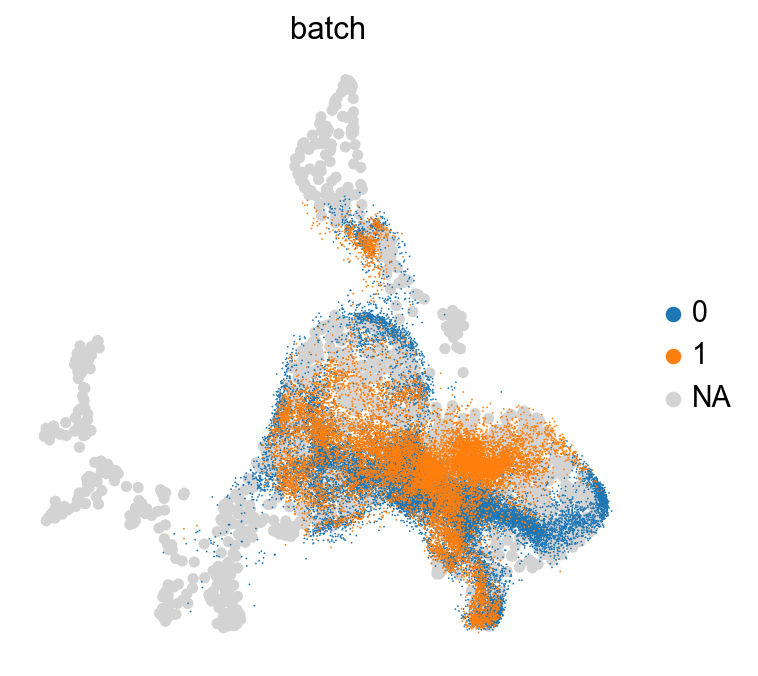

C:\Users\chbohan\AppData\Local\Temp\ipykernel_39264\3886295330.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  size=size[index],
c:\Users\chbohan\AppData\Local\anaconda3\envs\scRNAseq-3\Lib\site-packages\scanpy\plotting\_utils.py:471: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


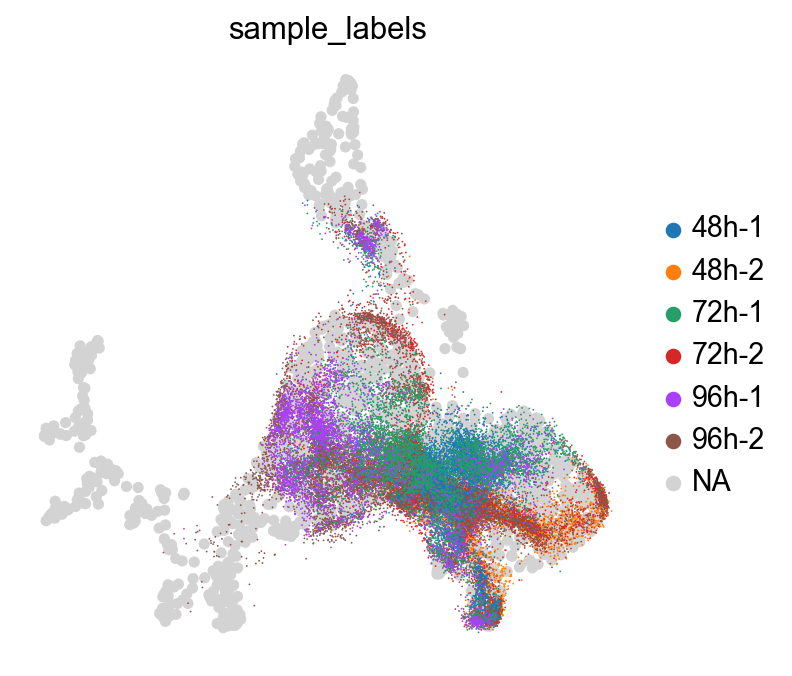

C:\Users\chbohan\AppData\Local\Temp\ipykernel_39264\3886295330.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  size=size[index],
c:\Users\chbohan\AppData\Local\anaconda3\envs\scRNAseq-3\Lib\site-packages\scanpy\plotting\_utils.py:471: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


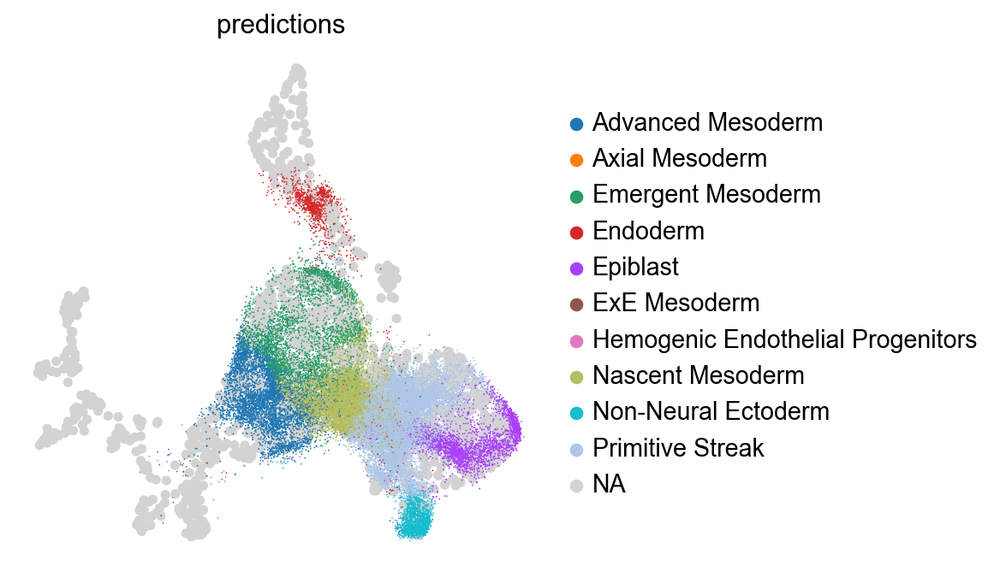

In [49]:
#sc.set_figure_params(figsize=[5,5])
for col in ["batch","sample_labels","predictions"]:
    sc.pl.embedding(
        adata_full[index],
        basis=mybasis,
        color=col, 
        size=size[index],
        frameon=False,
        ncols=5,
        #save= method + "_" + model_id + str(i) + "_rs" + str(rs) + "_" + col + ".png",
    )

C:\Users\chbohan\AppData\Local\Temp\ipykernel_39264\3387301800.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  size=size[index],
c:\Users\chbohan\AppData\Local\anaconda3\envs\scRNAseq-3\Lib\site-packages\scanpy\plotting\_utils.py:471: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


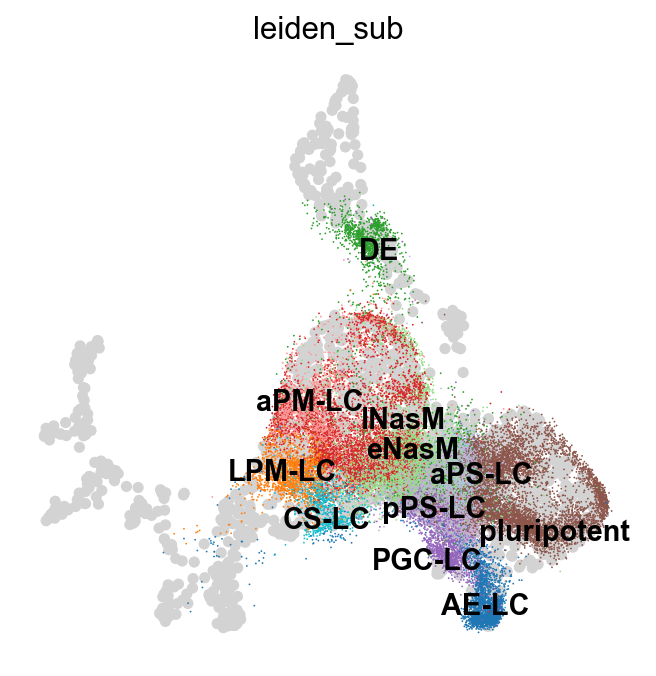

In [54]:
#sc.set_figure_params(figsize=[5,5])
ax = sc.pl.embedding(
                adata_full[index],
                basis='X_scVI_UMAP',
                color='leiden_sub', 
                legend_loc = 'on data',
                palette=mypalette,
                size=size[index],
                frameon=False,
                na_in_legend=False,
                legend_fontsize=13,
                ncols=5,
                show=False,
                )
for text in ax.texts:
                pos = text.get_position();
                txt = text.get_text()
                if txt == 'PGC-LC':
                    text.set_position(pos + np.array([-0.75, -0.75]))
                if txt == 'eNasM':
                    text.set_position(pos + np.array([0, 0.6]))
                if txt == 'lNasM':
                    text.set_position(pos + np.array([1.5, 0.75]))
                if txt == 'DE':
                    text.set_position(pos + np.array([0, 1.5]))
                if txt == 'aPS-LC':
                    text.set_position(pos + np.array([0.75, 0.75]))
                if txt == 'pPS-LC':
                    text.set_position(pos + np.array([-0.5, -0.25]))
                if txt == 'CS-LC':
                    text.set_position(pos + np.array([0, -0.5]))
                if txt == 'LPM-LC':
                    text.set_position(pos + np.array([-0.5,0]))
                if txt == 'aPM-LC':
                    text.set_position(pos + np.array([-0.5,0.5]))
                if txt == 'pluripotent':
                    text.set_position(pos + np.array([2.5, -1]))
                elif txt == 'stressed':
                    text.set_text('')
#plt.savefig("X_umap_leiden_sub.pdf", format = 'pdf', bbox_inches = "tight")

c:\Users\chbohan\AppData\Local\anaconda3\envs\scRNAseq-3\Lib\site-packages\scanpy\plotting\_utils.py:471: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


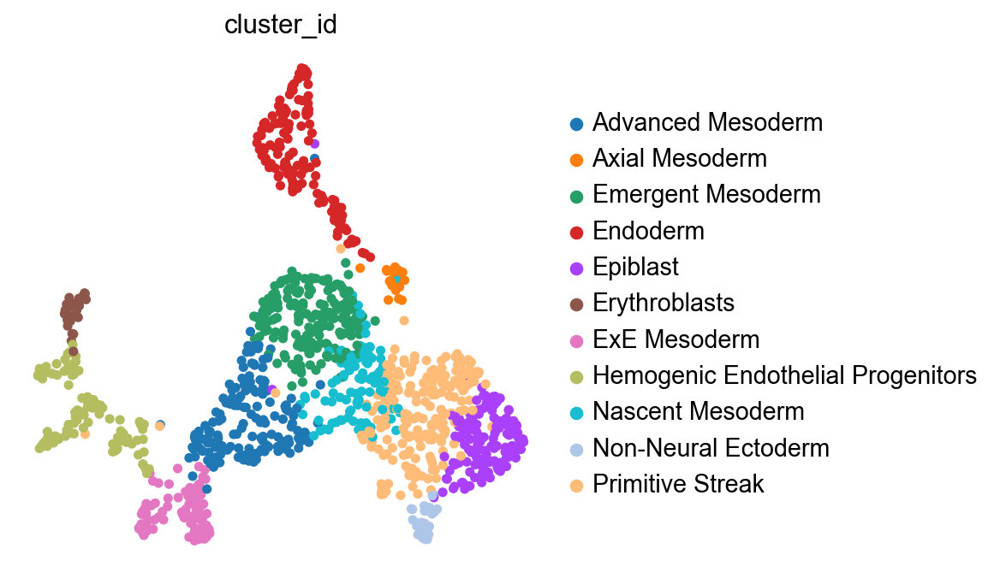

In [56]:
sc.pl.embedding(
                adata_full[adata_full.obs['dataset'] == 'Reference'],
                basis='X_scVI_UMAP',
                color="cluster_id",
                size=refsize,
                frameon=False,
                ncols=5,
                #save= "X_umap_tyser_clusters.pdf",
                    )

C:\Users\chbohan\AppData\Local\Temp\ipykernel_39264\1087022781.py:18: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  size=size[index],
c:\Users\chbohan\AppData\Local\anaconda3\envs\scRNAseq-3\Lib\site-packages\scanpy\plotting\_utils.py:471: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


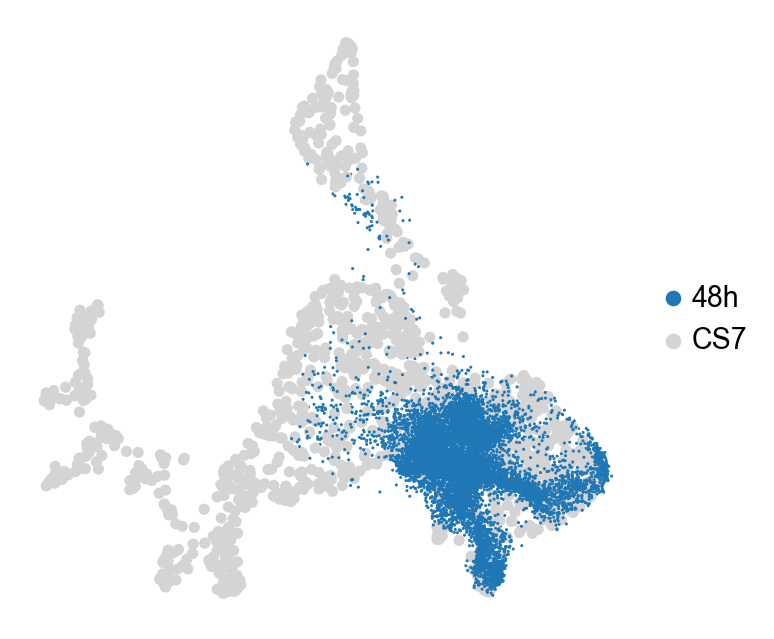

C:\Users\chbohan\AppData\Local\Temp\ipykernel_39264\1087022781.py:18: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  size=size[index],
c:\Users\chbohan\AppData\Local\anaconda3\envs\scRNAseq-3\Lib\site-packages\scanpy\plotting\_utils.py:471: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


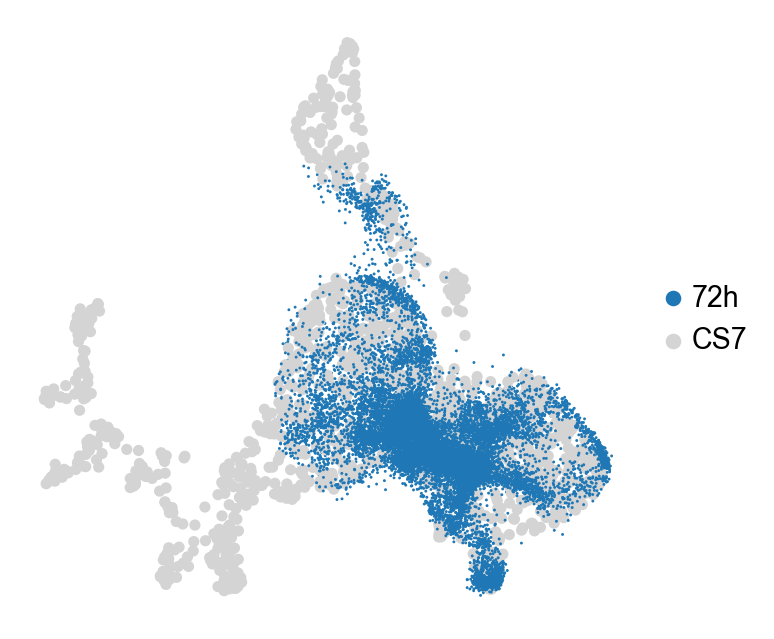

C:\Users\chbohan\AppData\Local\Temp\ipykernel_39264\1087022781.py:18: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  size=size[index],
c:\Users\chbohan\AppData\Local\anaconda3\envs\scRNAseq-3\Lib\site-packages\scanpy\plotting\_utils.py:471: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


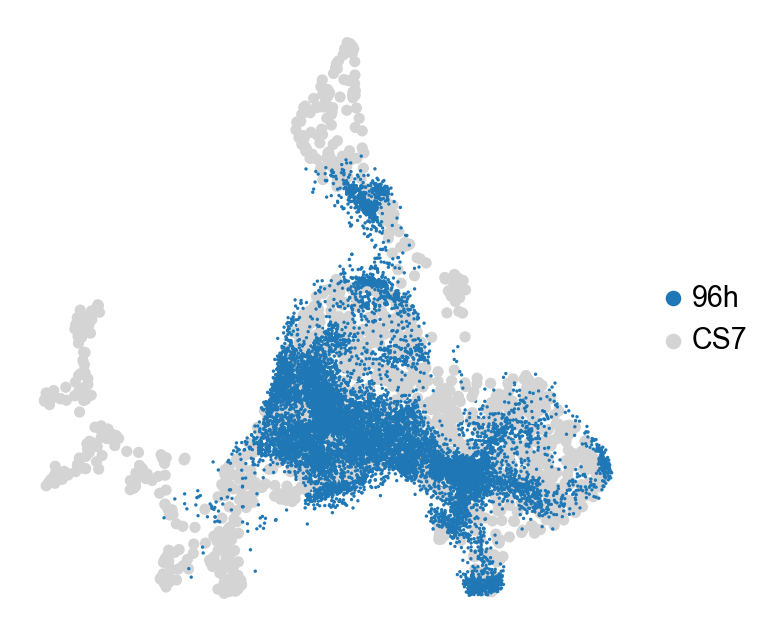

In [55]:
for time in ['48h','72h','96h']:
            
    subidx = np.logical_or(adata_full.obs['time'] == time, adata_full.obs['time'] == 'CS7');

    Nq = np.sum(adata_full[subidx].obs.dataset == 'Query');
    Nr = np.sum(adata_full[subidx].obs.dataset == 'Reference');
    index = list(range(Nq, Nr + Nq)) + list(range(0, Nq));

    querysize = 120000 / Nq;
    refsize = 120000 / Nr;
    size = (adata_full[subidx].obs.dataset == 'Query')*querysize + (adata_full[subidx].obs.dataset == 'Reference')*refsize;

    sc.set_figure_params(figsize=[5,5])
    fig = sc.pl.embedding(
        adata_full[subidx][index,:],
        basis='X_scVI_UMAP',
        color=["time"],
        size=size[index],
        frameon=False,
        palette=[(0.12,0.47,0.71),(0.83,0.83,0.83)],
        ncols=2,
        title=[""],
        #return_fig=True,
        #save = 'gastrula_gastruloid_all_sample_overlay_'+ time +'.pdf',
    )

In [37]:
# run magic for later gene visualization
data_tyser_hvg = pd.DataFrame(adata_tyser_hvg.raw.X, index=adata_tyser_hvg.obs.index, columns=adata_tyser_hvg.raw.var_names);
data_tyser_hvg_magic_1 = magic.MAGIC(knn=5,t=1).fit_transform(data_tyser_hvg)
adata_tyser_hvg_magic_1 = anndata.AnnData(data_tyser_hvg_magic)

Calculating MAGIC...
  Running MAGIC on 1184 cells and 21080 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.52 seconds.
    Calculating KNN search...
    Calculated KNN search in 0.06 seconds.
    Calculating affinities...
    Calculated affinities in 0.06 seconds.
  Calculated graph and diffusion operator in 0.67 seconds.
  Running MAGIC with `solver='exact'` on 21080-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...
  Calculated imputation in 0.25 seconds.
Calculated MAGIC in 0.96 seconds.


In [38]:
# for gastruloid gene visualization
adata_tyser_hvg_magic_1.obs = adata_tyser_hvg_magic.obs;
adata_tyser_hvg_magic_1.obsm = adata_tyser_hvg_magic.obsm;

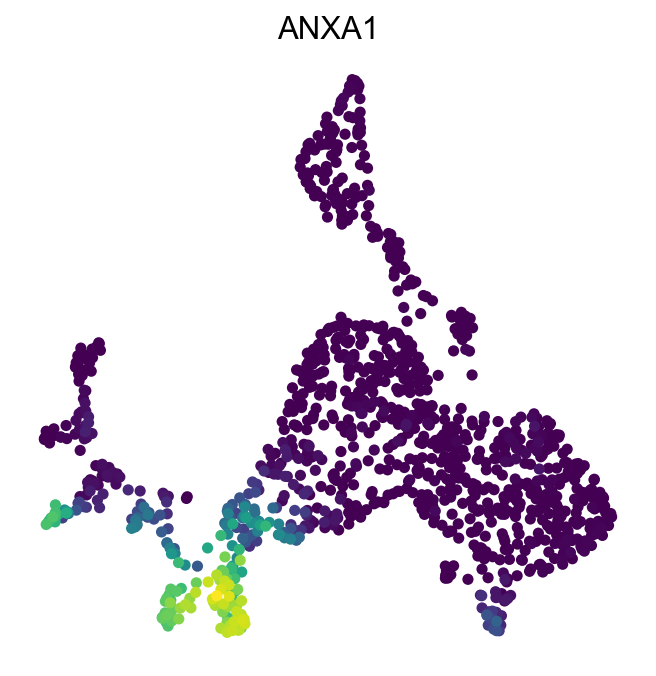

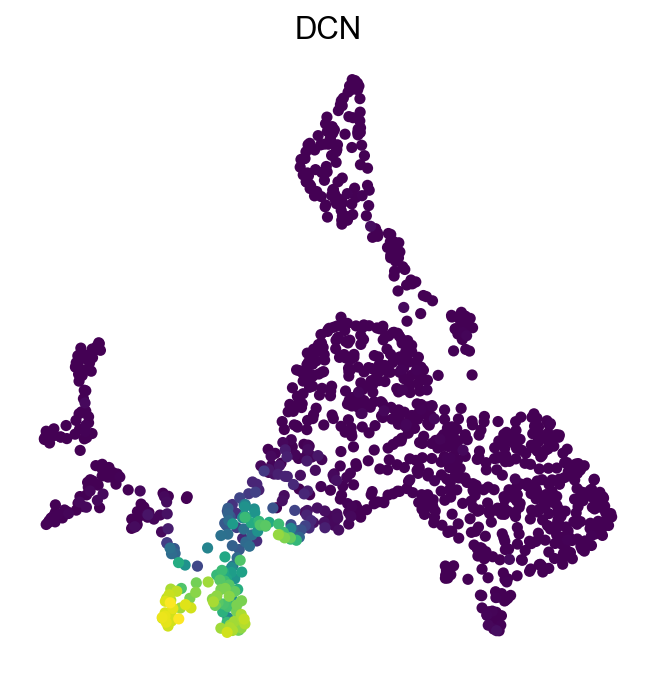

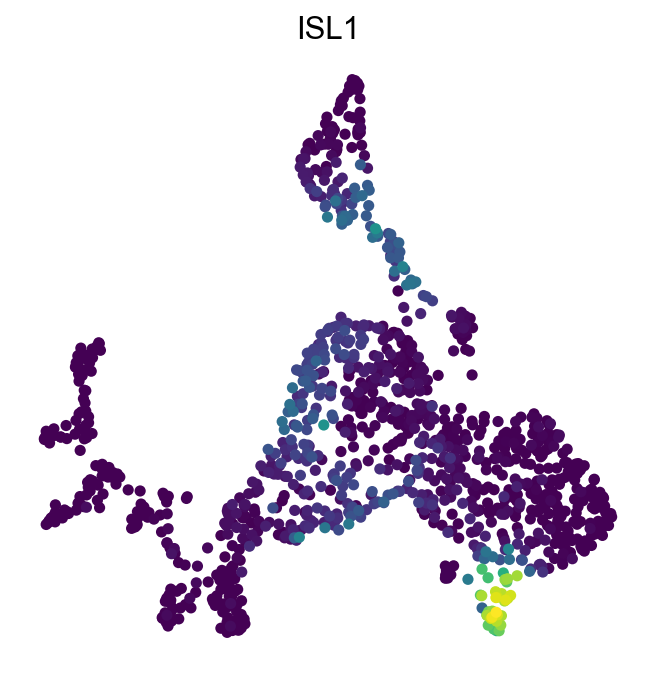

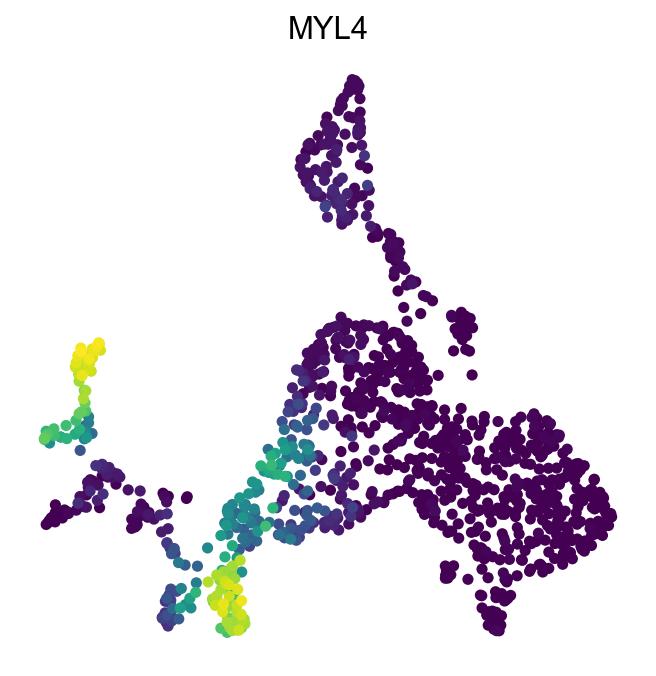

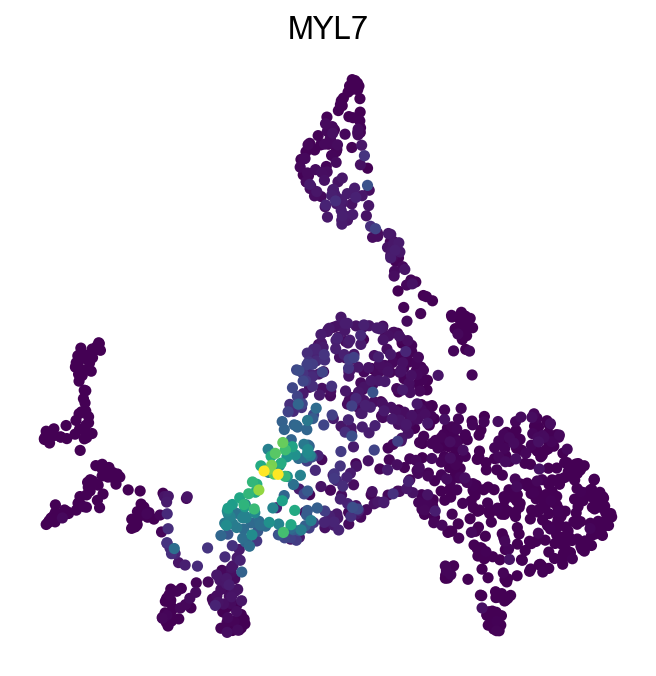

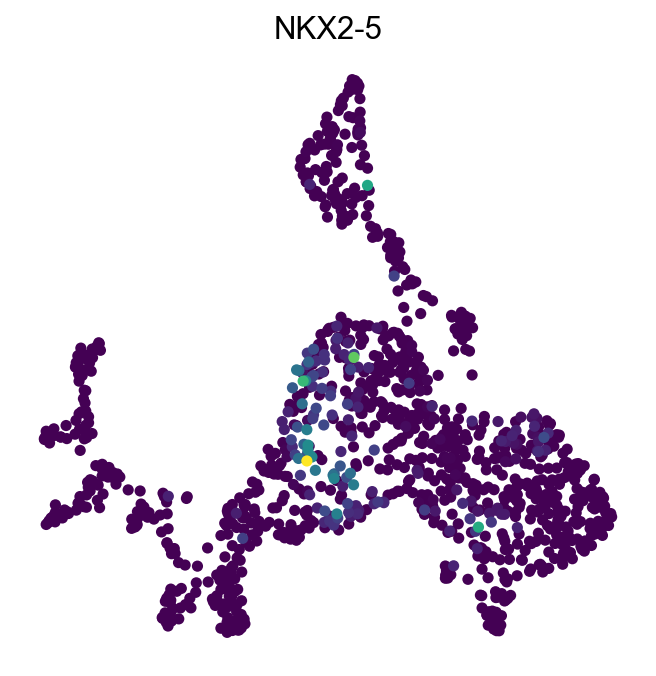

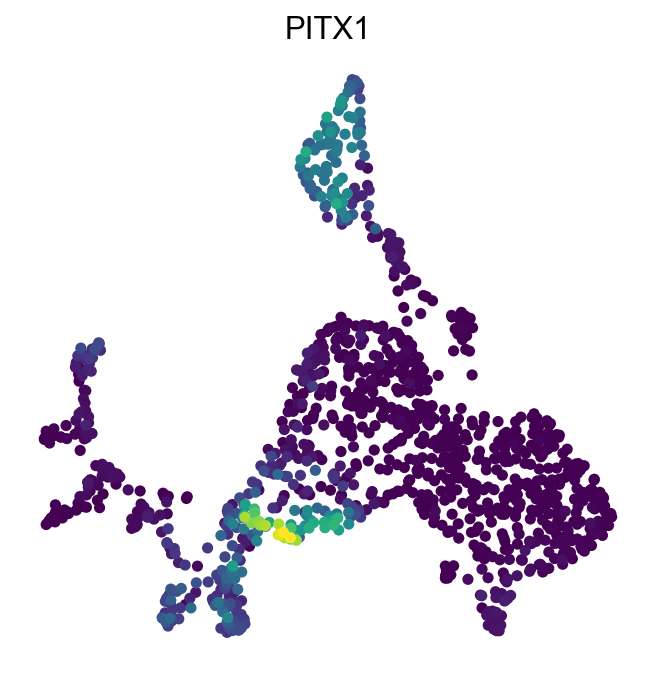

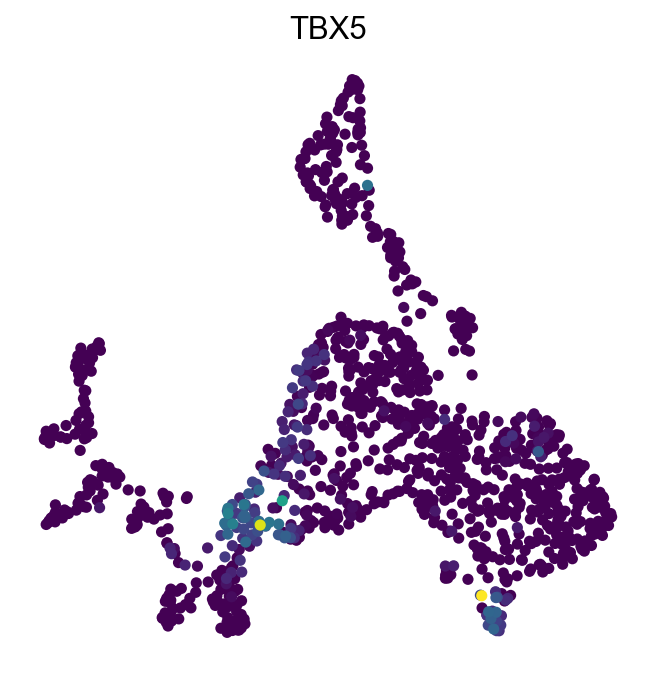

In [48]:
sc.set_figure_params(figsize=[5,5])
cols = [g for g in ref.raw.var_names if g.split()[0] in ['ANXA1','DCN','ISL1','MYL4','MYL7','NKX2-5','PITX1','TBX4','TBX5']]
cols = np.sort(cols)
for col in cols:
    sc.pl.embedding(
        adata_tyser_hvg_magic_1,
        basis=mybasis,
        color=col, #,"cluster_id"
        color_map = "viridis",
        frameon=False,
        colorbar_loc=None,
        ncols=9,
        #save= method + '_' + str(i) + "_rs" + str(rs) + '_tyser_magic_'+col+'.png',
    )

C:\Users\chbohan\AppData\Local\Temp\ipykernel_39264\630777265.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_summary = obs_tab.groupby([clustertype,'predictions'])[['dataset']].count() # batch is just a random column without nan
C:\Users\chbohan\AppData\Local\Temp\ipykernel_39264\630777265.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  leiden_cell_count = obs_summary.groupby(clustertype).transform(lambda x: x.sum())
C:\Users\chbohan\AppData\Local\Temp\ipykernel_39264\630777265.py:8: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future vers

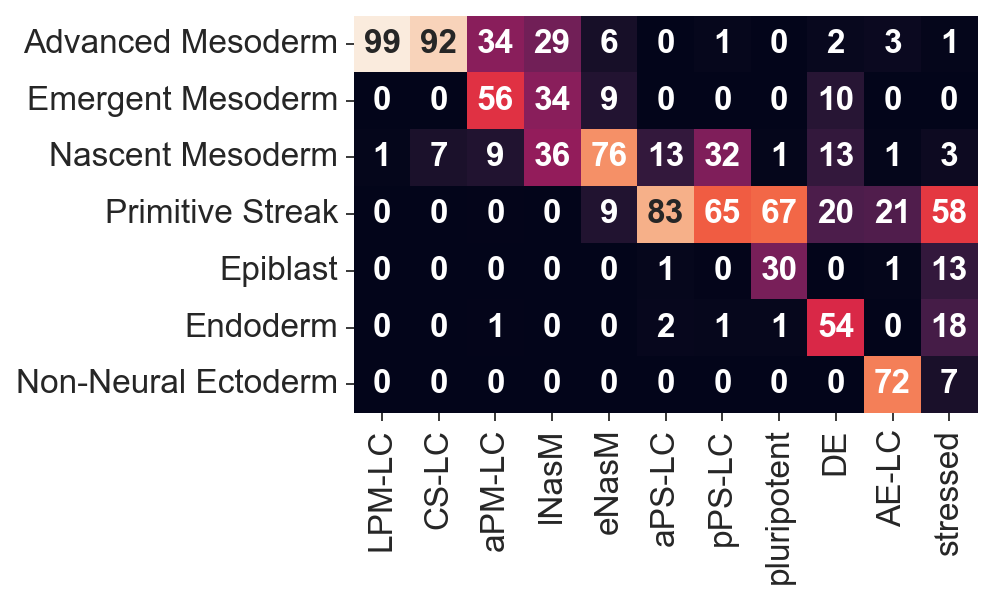

In [57]:
clustertype = 'leiden_sub';
    
obs_tab = adata_full[adata_full.obs['dataset'] == 'Query'].obs.copy()
obs_summary = obs_tab.groupby([clustertype,'predictions'])[['dataset']].count() # batch is just a random column without nan
            
leiden_cell_count = obs_summary.groupby(clustertype).transform(lambda x: x.sum())
percentmap = obs_summary / leiden_cell_count * 100
percentmap = percentmap.pivot_table(index='predictions', columns=clustertype);
percentmap.columns = [j for (i,j) in percentmap.columns];
            #percentmap = percentmap.loc[np.max(percentmap, axis=1) > 2,:];
rownames = ['Advanced Mesoderm','Emergent Mesoderm','Nascent Mesoderm','Primitive Streak','Epiblast','Endoderm','Non-Neural Ectoderm'];
colnames = ['LPM-LC','CS-LC','aPM-LC','lNasM','eNasM','aPS-LC','pPS-LC','pluripotent','DE','AE-LC','stressed'];
percentmap = percentmap.loc[rownames,colnames];
percentmap = percentmap.fillna(0);
            
import seaborn as sns
sns.set_style('ticks');
fs = 15;
plt.figure(figsize=(5, 5))
h = sns.heatmap(percentmap, annot=True, cbar=False, annot_kws={"size": fs}, fmt='.0f',linewidths=0, square=True)
            #h.set_xticklabels(colnames, rotation=45) #column index has format ("cell_type", sample name), get sample name only
h.set_xlabel('')
h.set_ylabel('')
for text in h.texts:
    text.set_fontweight('bold')
for label in h.xaxis.get_ticklabels():
            #    label.set_fontweight('bold')
    label.set_fontsize(fs)
for label in h.yaxis.get_ticklabels():
            #    label.set_fontweight('bold')
    label.set_fontsize(fs)
#plt.savefig('leiden_sub_predictions_scanvi.pdf', format = 'pdf', bbox_inches='tight')

## Monkey plots

In [18]:
adata_full_map2human = sc.read_h5ad('./adata_full_241003.h5ad')
adata_full_map2monkey = sc.read_h5ad('./adata_integrate_to_monkey_10_3_2024.h5ad')

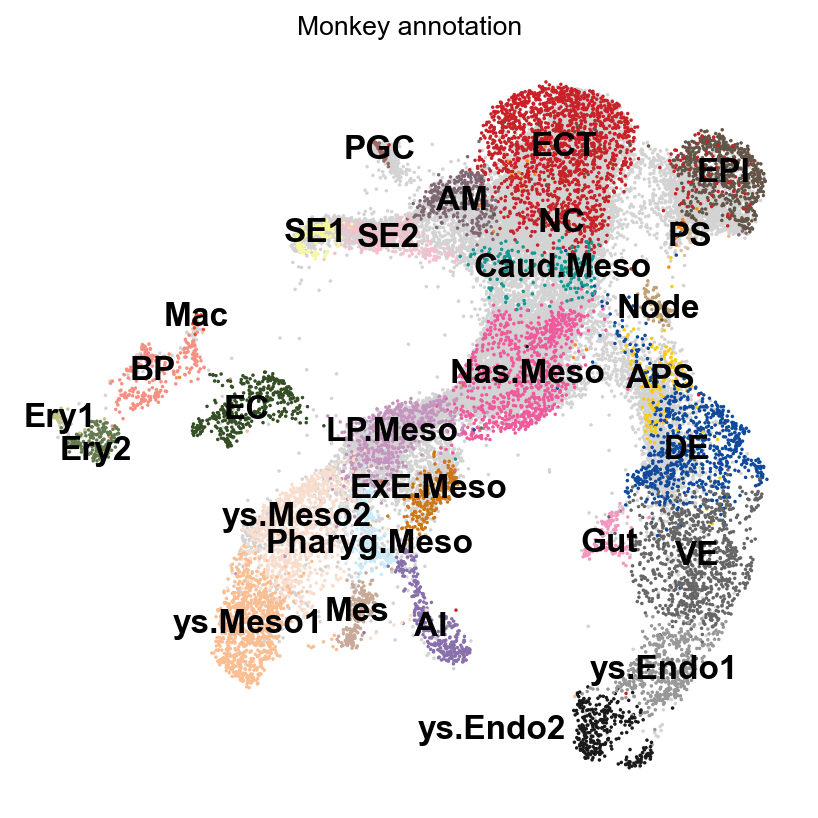

In [19]:
# Figure 2K
styles = {
    'font.family': 'arial',
    'font.weight': 'normal',
    'legend.fontsize': 10,
    'legend.markerscale': 0.8,
    'font.size': 15 # This set size of axis label
}
plt.rcParams.update(styles)
fig, ax = plt.subplots(layout = "constrained", figsize = (5, 5))
sc.pl.embedding(
    adata_full_map2monkey, 
    color = ['Monkey annotation'], 
    basis='X_all2monkey',
    #na_color=[0.5, 0.5, 0.5],
    na_in_legend=False,
    size = 10, 
    frameon = False,
    # palette = color_pallete_monkey,
    legend_loc = 'on data',
    ax = ax,
    show = False
    #save='all2monkey.png'
)
for te in ax.texts:
    if te.get_text() == 'ys.Meso2':
        te.set_y(2)
    elif te.get_text() == 'ys.Endo2':
        te.set_x(6.5)
    elif te.get_text() == 'Pharyg.Meso':
        te.set_y(1)
    elif te.get_text() == 'ExE.Meso':
        te.set_y(3)
    elif te.get_text() == 'Ery2':
        te.set_y(4.4)
    te.set_c([0, 0, 0, 1])
plt.show()

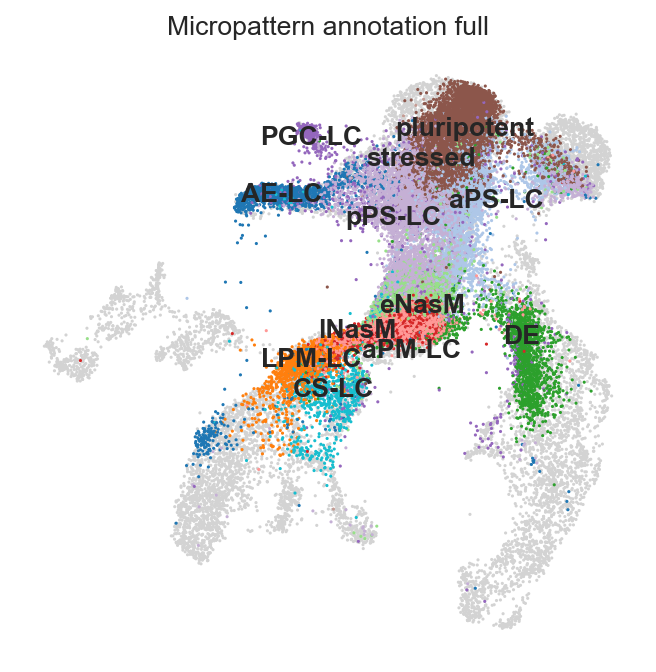

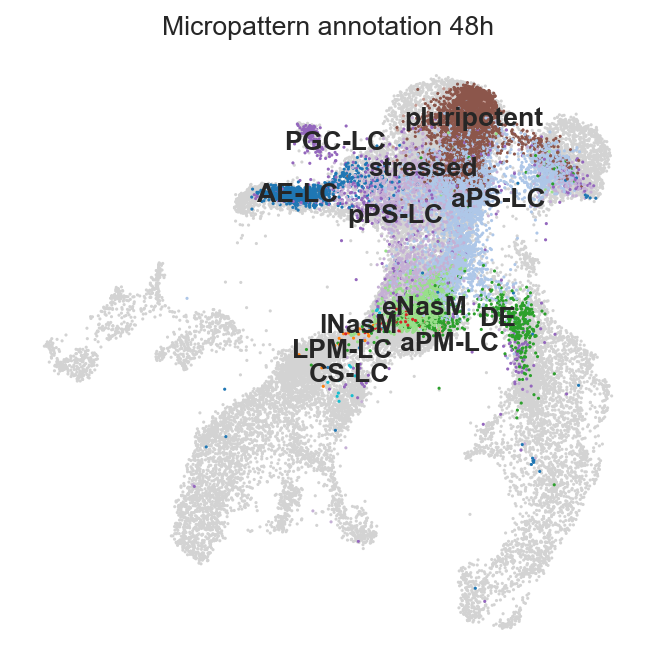

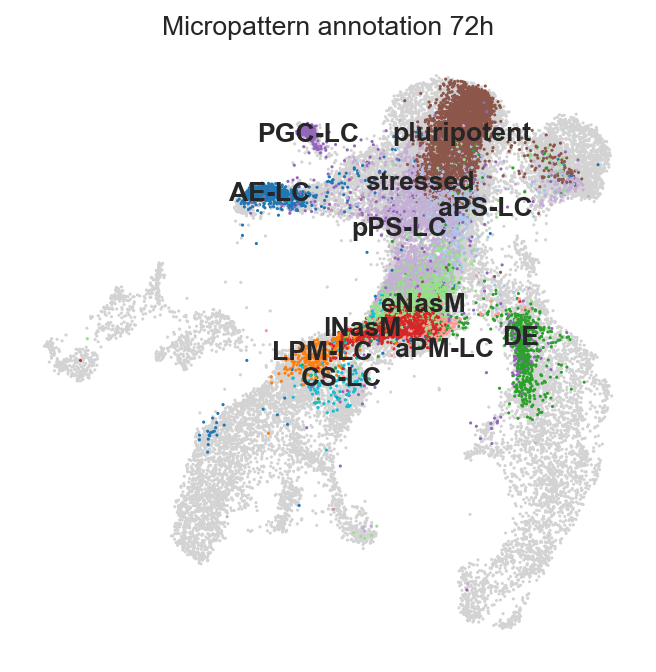

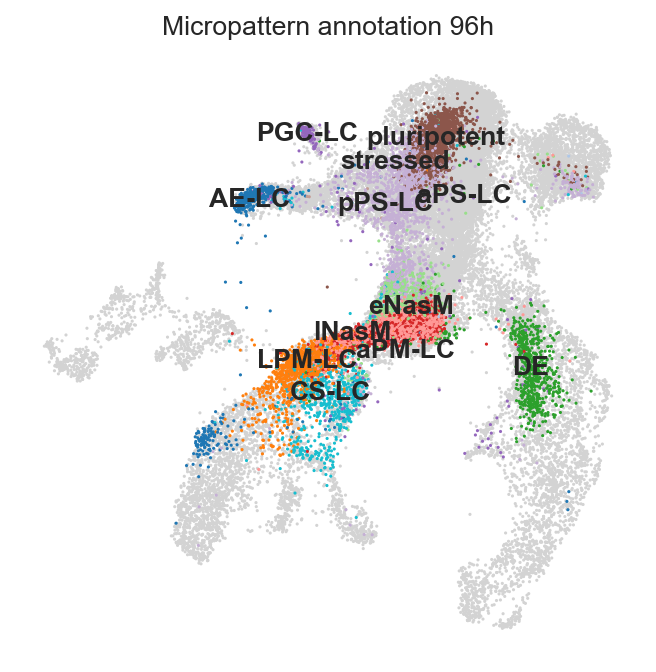

In [89]:
# Figure 2I
adata_full_map2monkey.obs['leiden_sub_y_48h'] = np.nan
adata_full_map2monkey.obs['leiden_sub_y_72h'] = np.nan
adata_full_map2monkey.obs['leiden_sub_y_96h'] = np.nan
adata_full_map2monkey.obs.loc[adata_full_map2monkey.obs['sample'].str.contains('48h'), 'leiden_sub_y_48h'] = adata_full_map2monkey.obs.loc[adata_full_map2monkey.obs['sample'].str.contains('48h'), 'leiden_sub_y']
adata_full_map2monkey.obs.loc[adata_full_map2monkey.obs['sample'].str.contains('72h'), 'leiden_sub_y_72h'] = adata_full_map2monkey.obs.loc[adata_full_map2monkey.obs['sample'].str.contains('72h'), 'leiden_sub_y']
adata_full_map2monkey.obs.loc[adata_full_map2monkey.obs['sample'].str.contains('96h'), 'leiden_sub_y_96h'] = adata_full_map2monkey.obs.loc[adata_full_map2monkey.obs['sample'].str.contains('96h'), 'leiden_sub_y']

# create universal cmap
cmap_temp = dict(zip(adata_full_map2monkey.obs['leiden_sub_y'].cat.categories, adata_full_map2monkey.uns['leiden_sub_y_colors']))

# Set figure parameters
sc.set_figure_params(figsize=(5, 5), fontsize=12, dpi_save=300, format='png', frameon=False)

# Create the embedding plot
ax = sc.pl.embedding(
    adata_full_map2monkey,
    color='leiden_sub_y', 
    basis='X_all2monkey',
    frameon=False,
    title='Micropattern annotation full',
    legend_loc='on data',
    na_in_legend=False,
    size=8,
    palette=cmap_temp,
    show=False,  # Do not show the plot immediately
)


for text in ax.texts:
    if text.get_text() == 'aPM-LC':
        text.set_position((text.get_position()[0] + 0.5, text.get_position()[1] - 1))
    elif text.get_text() == 'lNasM':
        text.set_position((text.get_position()[0] - 2, text.get_position()[1] - 0.25))
    elif text.get_text() == 'pPS-LC':
        text.set_position((text.get_position()[0] - 1, text.get_position()[1] - 0.5))
    elif text.get_text() == 'aPS-LC':
        text.set_position((text.get_position()[0] + 1.5, text.get_position()[1] - 0.5))



# Create the embedding plot
ax = sc.pl.embedding(
    adata_full_map2monkey,
    color='leiden_sub_y_48h', 
    basis='X_all2monkey',
    frameon=False,
    title='Micropattern annotation 48h',
    legend_loc='on data',
    na_in_legend=False,
    size=8,
    palette=cmap_temp,
    show=False,  # Do not show the plot immediately
)


for text in ax.texts:
    if text.get_text() == 'aPM-LC':
        text.set_position((text.get_position()[0] + 0.5, text.get_position()[1] - 1))
    elif text.get_text() == 'lNasM':
        text.set_position((text.get_position()[0] - 2, text.get_position()[1] - 0.25))
    elif text.get_text() == 'pPS-LC':
        text.set_position((text.get_position()[0] - 1, text.get_position()[1] - 0.5))
    elif text.get_text() == 'aPS-LC':
        text.set_position((text.get_position()[0] + 1.5, text.get_position()[1] - 0.5))
    elif text.get_text() == 'LPM-LC':
        text.set_position((text.get_position()[0] - 0.5, text.get_position()[1] - 0.65))
    elif text.get_text() == 'eNasMe':
        text.set_position((text.get_position()[0], text.get_position()[1] + 0.25))
    elif text.get_text() == 'PGC-LC':
        text.set_position((text.get_position()[0] - 1, text.get_position()[1] + 1.3))
    elif text.get_text() == 'stressed':
        text.set_position((text.get_position()[0], text.get_position()[1] - 2))


# Create the embedding plot
ax = sc.pl.embedding(
    adata_full_map2monkey,
    color='leiden_sub_y_72h', 
    basis='X_all2monkey',
    frameon=False,
    title='Micropattern annotation 72h',
    legend_loc='on data',
    size=8,
    na_in_legend=False,
    palette=cmap_temp,
    show=False,  # Do not show the plot immediately
)


for text in ax.texts:
    if text.get_text() == 'aPM-LC':
        text.set_position((text.get_position()[0] + 0.5, text.get_position()[1] - 1))
    elif text.get_text() == 'lNasM':
        text.set_position((text.get_position()[0] - 2, text.get_position()[1] - 0.25))
    elif text.get_text() == 'pPS-LC':
        text.set_position((text.get_position()[0] - 1, text.get_position()[1] - 0.5))
    elif text.get_text() == 'aPS-LC':
        text.set_position((text.get_position()[0] + 1.5, text.get_position()[1] - 0.5))



# Create the embedding plot
ax = sc.pl.embedding(
    adata_full_map2monkey,
    color='leiden_sub_y_96h', 
    basis='X_all2monkey',
    frameon=False,
    title='Micropattern annotation 96h',
    legend_loc='on data',
    na_in_legend=False,
    size=8,
    palette=cmap_temp,
    show=False,  # Do not show the plot immediately
)


for text in ax.texts:
    if text.get_text() == 'aPM-LC':
        text.set_position((text.get_position()[0] + 0.5, text.get_position()[1] - 1))
    elif text.get_text() == 'lNasM':
        text.set_position((text.get_position()[0] - 2, text.get_position()[1] - 0.25))
    elif text.get_text() == 'pPS-LC':
        text.set_position((text.get_position()[0] - 1, text.get_position()[1] - 0.5))
    elif text.get_text() == 'aPS-LC':
        text.set_position((text.get_position()[0] + 1.5, text.get_position()[1] - 0.3))
    elif text.get_text() == 'stressed':
        text.set_position((text.get_position()[0], text.get_position()[1] + 0.5))
        
del cmap_temp

In [36]:
obs_tab = adata_full_map2monkey.obs.loc[:, ['sample', 'knn prediction micropattern', 'leiden_sub_y']]
obs_tab = obs_tab.dropna()
obs_tab_48h = obs_tab[obs_tab['sample'].str.contains('48h')]
obs_tab_72h = obs_tab[obs_tab['sample'].str.contains('72h')]
obs_tab_96h = obs_tab[obs_tab['sample'].str.contains('96h')]

required_indices = ['AI', 'Caud.Meso', 'ExE.Meso', 'LP.Meso', 'Nas.Meso', 'Pharyg.Meso', 'ys.Meso1', 'ys.Meso2']

obs_summary = obs_tab.groupby(['leiden_sub_y', 'knn prediction micropattern'])[['sample']].count()
sample_cell_count = obs_summary.groupby('leiden_sub_y').transform(lambda x: x.sum())
obs_summary['sample'] = obs_summary['sample'] / sample_cell_count['sample'] * 100
heatmap = obs_summary.pivot_table(index = 'knn prediction micropattern', columns = 'leiden_sub_y')
heatmap_full = heatmap.loc[:, list(zip(['sample'] * 12, ['pluripotent','AE-LC','PGC-LC', 'aPS-LC', 'pPS-LC','eNasM','lNasM','aPM-LC', 'LPM-LC', 'CS-LC', 'DE','stressed']))].copy()
heatmap = heatmap.loc[pd.Index(np.setdiff1d(heatmap.index, ['BP', 'Ery1', 'Ery2', 'Mac', 'NC', 'ys.Endo1', 'ys.Endo2', 'Gut', 'AM', 'APS', 'DE', 'EC', 'ECT', 'EPI', 'PGC', 'PS', 'SE1', 'SE2', 'VE', 'Node', 'Mes'])), list(zip(['sample'] * 12, ['eNasM','lNasM','aPM-LC', 'LPM-LC', 'CS-LC']))].copy()
heatmap = heatmap.loc[['AI', 'Caud.Meso', 'ExE.Meso', 'LP.Meso', 'Nas.Meso', 'Pharyg.Meso', 'ys.Meso1', 'ys.Meso2'], :]

heatmap_48h = obs_tab_48h.groupby(['leiden_sub_y', 'knn prediction micropattern'])[['sample']].count()
sample_cell_count_48h = heatmap_48h.groupby('leiden_sub_y').transform(lambda x: x.sum())
heatmap_48h['sample'] = heatmap_48h['sample'] / sample_cell_count_48h['sample'] * 100
heatmap_48h = heatmap_48h.pivot_table(index='knn prediction micropattern', columns='leiden_sub_y')
# Ensure all required indices are present in heatmap_48h
for idx in required_indices:
    if idx not in heatmap_48h.index:
        heatmap_48h.loc[idx] = 0
heatmap_48h = heatmap_48h.loc[required_indices, :]
heatmap_full_48h = heatmap_48h.loc[:, list(zip(['sample'] * 12, ['pluripotent', 'AE-LC', 'PGC-LC', 'aPS-LC', 'pPS-LC', 'eNasM', 'lNasM', 'aPM-LC', 'LPM-LC', 'CS-LC', 'DE', 'stressed']))].copy()
heatmap_48h = heatmap_48h.loc[pd.Index(np.setdiff1d(heatmap_48h.index, ['BP', 'Ery1', 'Ery2', 'Mac', 'NC', 'ys.Endo1', 'ys.Endo2', 'Gut', 'AM', 'APS', 'DE', 'EC', 'ECT', 'EPI', 'PGC', 'PS', 'SE1', 'SE2', 'VE', 'Node', 'Mes'])), list(zip(['sample'] * 12, ['eNasM','lNasM','aPM-LC', 'LPM-LC', 'CS-LC']))].copy()
heatmap_48h = heatmap_48h.loc[['AI', 'Caud.Meso', 'ExE.Meso', 'LP.Meso', 'Nas.Meso', 'Pharyg.Meso', 'ys.Meso1', 'ys.Meso2'], :]


heatmap_72h = obs_tab_72h.groupby(['leiden_sub_y', 'knn prediction micropattern'])[['sample']].count()
sample_cell_count_72h = heatmap_72h.groupby('leiden_sub_y').transform(lambda x: x.sum())
heatmap_72h['sample'] = heatmap_72h['sample'] / sample_cell_count_72h['sample'] * 100
heatmap_72h = heatmap_72h.pivot_table(index='knn prediction micropattern', columns='leiden_sub_y')
# Ensure all required indices are present in heatmap_72h
for idx in required_indices:
    if idx not in heatmap_72h.index:
        heatmap_72h.loc[idx] = 0
heatmap_72h = heatmap_72h.loc[required_indices, :]
heatmap_full_72h = heatmap_72h.loc[:, list(zip(['sample'] * 12, ['pluripotent', 'AE-LC', 'PGC-LC', 'aPS-LC', 'pPS-LC', 'eNasM', 'lNasM', 'aPM-LC', 'LPM-LC', 'CS-LC', 'DE', 'stressed']))].copy()
heatmap_72h = heatmap_72h.loc[pd.Index(np.setdiff1d(heatmap_72h.index, ['BP', 'Ery1', 'Ery2', 'Mac', 'NC', 'ys.Endo1', 'ys.Endo2', 'Gut', 'AM', 'APS', 'DE', 'EC', 'ECT', 'EPI', 'PGC', 'PS', 'SE1', 'SE2', 'VE', 'Node', 'Mes'])), list(zip(['sample'] * 12, ['eNasM','lNasM','aPM-LC', 'LPM-LC', 'CS-LC']))].copy()
heatmap_72h = heatmap_72h.loc[['AI', 'Caud.Meso', 'ExE.Meso', 'LP.Meso', 'Nas.Meso', 'Pharyg.Meso', 'ys.Meso1', 'ys.Meso2'], :]

heatmap_96h = obs_tab_96h.groupby(['leiden_sub_y', 'knn prediction micropattern'])[['sample']].count()
sample_cell_count_96h = heatmap_96h.groupby('leiden_sub_y').transform(lambda x: x.sum())
heatmap_96h['sample'] = heatmap_96h['sample'] / sample_cell_count_96h['sample'] * 100
heatmap_96h = heatmap_96h.pivot_table(index='knn prediction micropattern', columns='leiden_sub_y')
# Ensure all required indices are present in heatmap_96h
for idx in required_indices:
    if idx not in heatmap_96h.index:
        heatmap_96h.loc[idx] = 0
heatmap_96h = heatmap_96h.loc[required_indices, :]
heatmap_full_96h = heatmap_96h.loc[:, list(zip(['sample'] * 12, ['pluripotent', 'AE-LC', 'PGC-LC', 'aPS-LC', 'pPS-LC', 'eNasM', 'lNasM', 'aPM-LC', 'LPM-LC', 'CS-LC', 'DE', 'stressed']))].copy()
heatmap_96h = heatmap_96h.loc[pd.Index(np.setdiff1d(heatmap_96h.index, ['BP', 'Ery1', 'Ery2', 'Mac', 'NC', 'ys.Endo1', 'ys.Endo2', 'Gut', 'AM', 'APS', 'DE', 'EC', 'ECT', 'EPI', 'PGC', 'PS', 'SE1', 'SE2', 'VE', 'Node', 'Mes'])), list(zip(['sample'] * 12, ['eNasM','lNasM','aPM-LC', 'LPM-LC', 'CS-LC']))].copy()
heatmap_96h = heatmap_96h.loc[['AI', 'Caud.Meso', 'ExE.Meso', 'LP.Meso', 'Nas.Meso', 'Pharyg.Meso', 'ys.Meso1', 'ys.Meso2'], :]

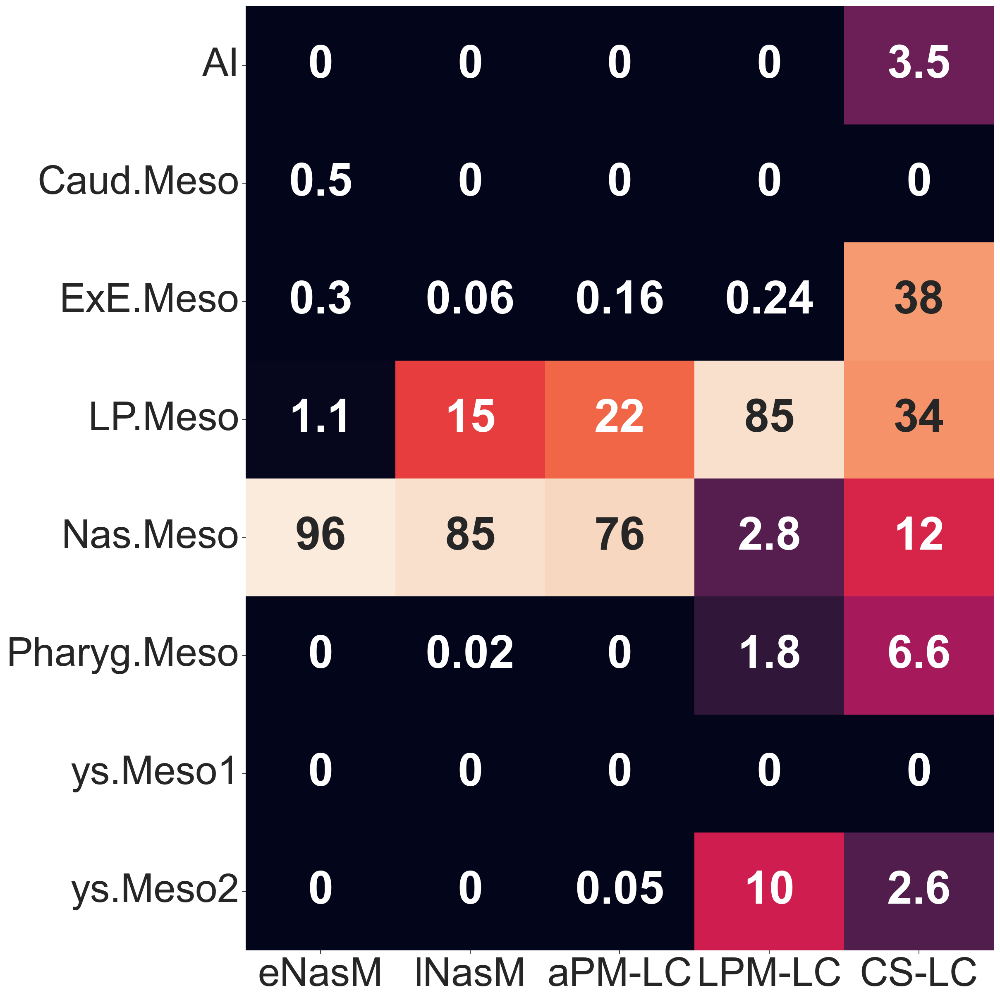

In [40]:
# Figure 2m
import seaborn as sns
styles = {
    'font.family': 'arial',
    'font.weight': 'normal',
    'legend.fontsize': 30,
    'legend.markerscale': 0.8,
    'font.size': 50 # This set size of axis label
}
from matplotlib.colors import LogNorm, Normalize
import os
plt.rcParams.update(styles)
sns.set_style("ticks")
fig, ax = plt.subplots(layout = "constrained", figsize = (15, 15))
sns.heatmap(np.round(heatmap, 2), annot=True, cbar=False, norm=LogNorm(vmin = 1, clip = True), ax = ax)
ax.set_xticklabels([j for (i, j) in heatmap.columns], rotation=0, fontsize = 43)
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize = 43)
plt.yticks(rotation=0)
ax.set_xlabel('')
ax.set_ylabel('')
for text in ax.texts:
    text.set_fontweight('bold')

C:\Users\zhiyu\AppData\Roaming\Python\Python312\site-packages\anndata\_core\anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


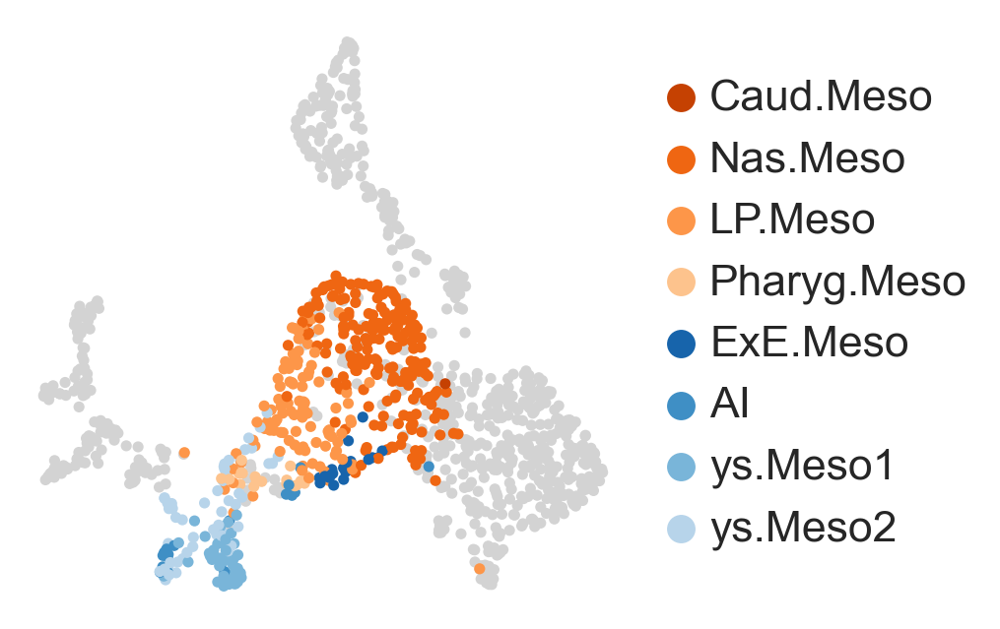

In [90]:
# Figure 2n
adata_full_map2human.obs['human_monkey_knn'] = np.nan
adata_full_map2human.obs.loc[adata_full_map2human.obs['time'].str.contains('CS7'), 'human_monkey_knn'] = adata_full_map2monkey.obs.loc[adata_full_map2monkey.obs['sample'].str.contains('human'), 'knn prediction human'].values
styles = {
    'font.family': 'arial',
    'font.weight': 'normal',
    'legend.fontsize': 10,
    'legend.markerscale': 2,
    'font.size': 30 # This set size of axis label
}
plt.rcParams.update(styles)

import matplotlib
colormap1 = matplotlib.colormaps.get_cmap('Oranges')
colormap2 = matplotlib.colormaps.get_cmap('Blues')
embryonic_clusters = ['Pharyg.Meso', 'LP.Meso', 'Nas.Meso', 'Caud.Meso']
extra_embryonic_clusters = ['ys.Meso2', 'ys.Meso1', 'AI', 'ExE.Meso']
colors1 = colormap1(np.linspace(0.3, 0.8, len(embryonic_clusters)))
colors2 = colormap2(np.linspace(0.3, 0.8, len(extra_embryonic_clusters)))
colors = np.concatenate((colors1, colors2), 0)
cmap_temp = dict(zip(embryonic_clusters + extra_embryonic_clusters, colors))
adata_full_map2human.obs['filtered_human_monkey_knn'] = pd.Categorical(adata_full_map2human.obs['human_monkey_knn'].apply(lambda x: x if x in embryonic_clusters + extra_embryonic_clusters else np.nan))
del colormap1, colormap2, colors1, colors2, colors

# Make filtered_human_monkey_knn ordered
ordered_clusters = ['Caud.Meso', 'Nas.Meso', 'LP.Meso', 'Pharyg.Meso', 'ExE.Meso', 'AI', 'ys.Meso1', 'ys.Meso2']
adata_full_map2human.obs['filtered_human_monkey_knn'] = pd.Categorical(
    adata_full_map2human.obs['filtered_human_monkey_knn'],
    categories = ordered_clusters,
    ordered = True
)
sc.pl.embedding(
    adata_full_map2human[adata_full_map2human.obs['time'] == 'CS7'],
    basis = 'X_scVI_UMAP',
    color = 'filtered_human_monkey_knn',
    palette = cmap_temp,
    na_in_legend = False,
    title = '',
    legend_fontsize = 20,
)
del cmap_temp

## Pseudotime trajectory analysis

### Package details

In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns
import scarches as sca
import scvelo as scv
import numba, scvi, umap, scipy, sklearn, mellon, scprep, anndata, magic
from scipy.sparse import issparse
from matplotlib import patheffects

# package version
# Note: to reproduce the results in the manuscript, please use the exact versions of the packages as shown below.
print('scanpy version: ' + sc.__version__)
print('pandas version: ' + pd.__version__)
print('numpy version: ' + np.__version__)
print('scipy version: ' + scipy.__version__)
print('numba version: ' + numba.__version__)
print('scvi version: ' + scvi.__version__)
print('umap version: ' + umap.__version__)
print('scikit-learn version: ' + sklearn.__version__)
print('mellon version: ' + mellon.__version__)
print('scprep version: ' + scprep.__version__)
print('anndata version: ' + anndata.__version__)
print('magic version: ' + magic.__version__)

# scanpy version: 1.10.1
# pandas version: 1.5.3
# numpy version: 1.26.4
# scipy version: 1.13.0
# numba version: 0.59.1
# scvi version: 1.1.5
# umap version: 0.5.6
# scikit-learn version: 1.4.2
# mellon version: 1.4.3
# scprep version: 1.2.3
# anndata version: 0.10.7
# magic version: 3.0.0

sc.set_figure_params(figsize = (5, 5), dpi_save = 300)
sns.set_style("white")

 captum (see https://github.com/pytorch/captum).


scanpy version: 1.10.1
pandas version: 1.5.3
numpy version: 1.26.4
scipy version: 1.13.0
numba version: 0.59.1
scvi version: 1.1.5
umap version: 0.5.6
scikit-learn version: 1.4.2
mellon version: 1.4.3
scprep version: 1.2.3
anndata version: 0.10.7
magic version: 3.0.0


In [10]:
adata = sc.read_h5ad('./adata_monkey_CS9_11_integrated.h5ad')

In [11]:
adata

AnnData object with n_obs × n_vars = 45007 × 1274
    obs: 'stage', 'sample_labels', 'theiler_stage', 'cell_cluster', 'cell_type', 'color', '_scvi_batch', '_scvi_labels'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'cell_type_colors', 'log1p'
    obsm: 'X_scanvi', 'X_scvi', 'X_umap_original', 'X_umap_trans'
    layers: 'counts'

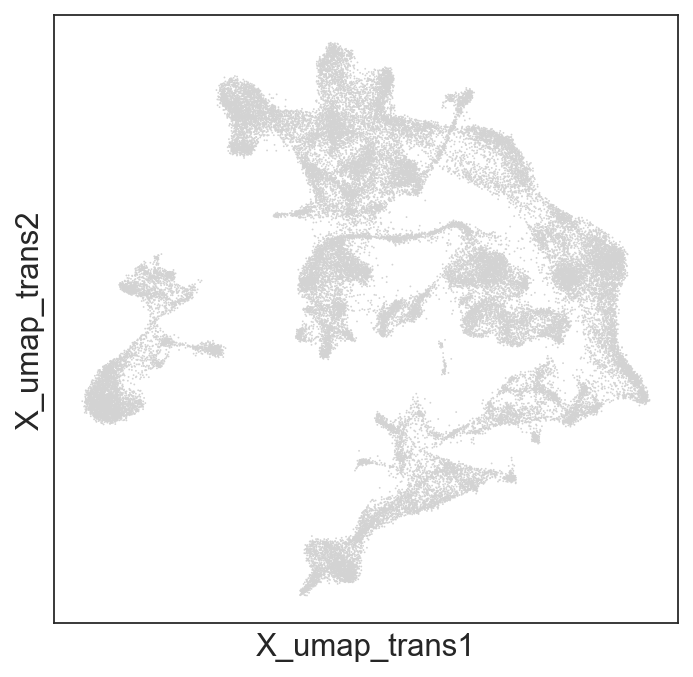

In [12]:
sc.pl.embedding(
    adata,
    basis='X_umap_trans'
)

### Data import

In [4]:
adata_micropattern_annotated = sc.read_h5ad('./adata_timeseries_all_cc_hvg1000_leiden10_23_v3.h5ad')
adata_micropattern_raw = sc.read_h5ad('./adata_timeseries_all_v3.h5ad')
adata_full = sc.read_h5ad('./adata_integrate_to_monkey.h5ad')
adata_full.obs.index = pd.Index(adata_full.obs.index.str.replace('-48h', '_48h').str.replace('-72h', '_72h').str.replace('-96h', '_96h'))

In [5]:
sc.pp.normalize_total(adata_micropattern_raw, target_sum = 1e4)
sc.pp.log1p(adata_micropattern_raw)

### 2(b)

In [36]:
sc.pp.neighbors(
    adata_micropattern_annotated, 
    use_rep = 'X_scVI_cc', 
    method = 'gauss', 
    n_neighbors = 20, 
    key_added = 'gauss_nei'
)
sc.tl.diffmap(
    adata_micropattern_annotated, 
    neighbors_key = 'gauss_nei'
)

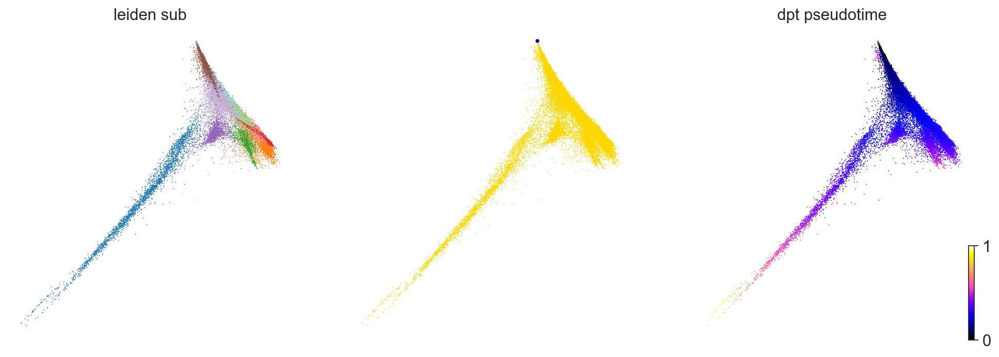

In [47]:
adata_micropattern_annotated.uns['iroot'] = adata_micropattern_annotated.obsm['X_diffmap'][:, 2].argmax()
sc.tl.dpt(adata_micropattern_annotated, neighbors_key = 'gauss_nei')
scv.pl.scatter(
    adata_micropattern_annotated,
    basis='X_diffmap',
    components=['1, 2'],
    cmap='gnuplot2',
    # color='leiden_sub'
    color=['leiden_sub', adata_micropattern_annotated.uns['iroot'], 'dpt_pseudotime'],
)

In [41]:
ls_dict = {
    'pm': 0.5,
    'lpm': 0.32,
    'exem': 0.6
}
sig_dict = {
    'pm': 1.8,
    'lpm': 0.6,
    'exem': 1
}

trajectory = {
    'pm': [],
    'lpm': [],
    'exem': []
}

for key, element in trajectory.items():
    mask = adata_micropattern_annotated.obs[key]
    coords = adata_micropattern_annotated.obsm['X_umap'][mask, :]
    pt = np.array(adata_micropattern_annotated.obs['dpt_pseudotime'][mask])
    pt_pred = np.arange(np.quantile(pt, q_down), np.quantile(pt, q_up), 0.001)
    df = pd.DataFrame(coords, columns = ['x', 'y'])
    df['t'] = pt
    gauss_model = mellon.model.FunctionEstimator(n_landmarks = 300, ls = ls_dict[key], sigma = sig_dict[key])
    trajectory[key] = gauss_model.fit_predict(pt, coords, pt_pred)

[2024-10-28 09:48:45,060] [INFO    ] Using sparse Gaussian Process since n_landmarks (300) < n_samples (25,025) and rank = 1.0.
[2024-10-28 09:48:45,061] [INFO    ] Using covariance function Matern52(ls=0.5).
[2024-10-28 09:48:45,062] [INFO    ] Computing 300 landmarks with k-means clustering.
[2024-10-28 09:48:46,886] [INFO    ] Using sparse Gaussian Process since n_landmarks (300) < n_samples (21,349) and rank = 1.0.
[2024-10-28 09:48:46,887] [INFO    ] Using covariance function Matern52(ls=0.32).
[2024-10-28 09:48:46,887] [INFO    ] Computing 300 landmarks with k-means clustering.
[2024-10-28 09:48:48,537] [INFO    ] Using sparse Gaussian Process since n_landmarks (300) < n_samples (20,530) and rank = 1.0.
[2024-10-28 09:48:48,537] [INFO    ] Using covariance function Matern52(ls=0.6).
[2024-10-28 09:48:48,538] [INFO    ] Computing 300 landmarks with k-means clustering.


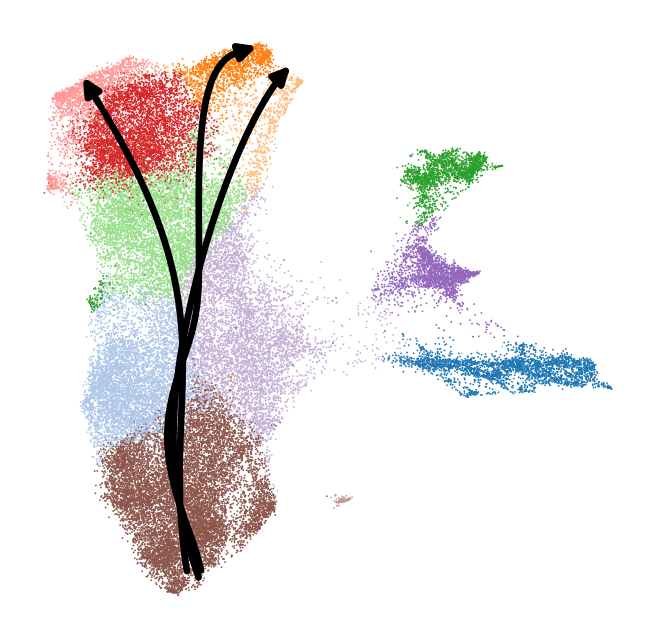

In [46]:
fig, ax = plt.subplots(figsize=(5, 5))
sc.pl.embedding(
    adata_micropattern_annotated,
    basis = 'X_umap',
    color = ['leiden_sub'],
    ax = ax,
    show = False,
    legend_loc=None,
    frameon=False,
    title='',
)
pm_trajectory = trajectory['pm']
lpm_trajectory = trajectory['lpm']
exem_trajectory = trajectory['exem']

ln_pm, = ax.plot(pm_trajectory[:, 0], pm_trajectory[:, 1], color = 'black')
ax.annotate(
    '',
    xy = (pm_trajectory[-1, 0] + 20*(pm_trajectory[-1, 0] - pm_trajectory[-2, 0]), pm_trajectory[-1, 1] + 20*(pm_trajectory[-1, 1] - pm_trajectory[-2, 1])),
    xytext = (pm_trajectory[-1, 0], pm_trajectory[-1, 1]),
    arrowprops = dict(arrowstyle = "-|>", color = 'black', path_effects=[patheffects.withStroke(linewidth=3, foreground='black')], mutation_scale=15)
)
ln_lpm, = ax.plot(lpm_trajectory[:-2, 0], lpm_trajectory[:-2, 1], color = 'black')
ax.annotate(
    '',
    xy = (lpm_trajectory[-1, 0] + 30 * (lpm_trajectory[-1, 0] - lpm_trajectory[-2, 0]), lpm_trajectory[-1, 1] + 30 * (lpm_trajectory[-1, 1] - lpm_trajectory[-2, 1])),
    xytext = (lpm_trajectory[-1, 0], lpm_trajectory[-1, 1]),
    arrowprops = dict(arrowstyle = "-|>", color = 'black', path_effects=[patheffects.withStroke(linewidth=3, foreground='black')], mutation_scale=15)
)
ln_exem, = ax.plot(exem_trajectory[:, 0], exem_trajectory[:, 1], color = "black")
ax.annotate(
    '',
    xy = (exem_trajectory[-1, 0] + 5 * (exem_trajectory[-1, 0] - exem_trajectory[-2, 0]), exem_trajectory[-1, 1] + 5 * (exem_trajectory[-1, 1] - exem_trajectory[-2, 1])),
    xytext = (exem_trajectory[-1, 0], exem_trajectory[-1, 1]),
    arrowprops = dict(arrowstyle = "-|>", color = "black", path_effects=[patheffects.withStroke(linewidth=3, foreground='black')], mutation_scale=15)
)

ln_lpm.set_path_effects([patheffects.withStroke(linewidth=3, foreground='black')])
ln_pm.set_path_effects([patheffects.withStroke(linewidth=3, foreground='black')])
ln_exem.set_path_effects([patheffects.withStroke(linewidth=3, foreground='black')])

In [58]:
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns
import scarches as sca
import scvelo as scv
import numba, scvi, umap, scipy, sklearn, mellon, scprep, anndata, magic

# package version
# Note: to reproduce the results in the manuscript, please use the exact versions of the packages as shown below.
print('scanpy version: ' + sc.__version__)
print('pandas version: ' + pd.__version__)
print('numpy version: ' + np.__version__)
print('scipy version: ' + scipy.__version__)
print('numba version: ' + numba.__version__)
print('scvi version: ' + scvi.__version__)
print('umap version: ' + umap.__version__)
print('scikit-learn version: ' + sklearn.__version__)
print('mellon version: ' + mellon.__version__)
print('scprep version: ' + scprep.__version__)
print('anndata version: ' + anndata.__version__)
print('magic version: ' + magic.__version__)

# scanpy version: 1.10.1
# pandas version: 1.5.3
# numpy version: 1.26.4
# scipy version: 1.13.0
# numba version: 0.59.1
# scvi version: 1.1.5
# umap version: 0.5.6
# scikit-learn version: 1.4.2
# mellon version: 1.4.3
# scprep version: 1.2.3
# anndata version: 0.10.7
# magic version: 3.0.0

sc.set_figure_params(figsize = (5, 5), dpi_save = 300)
sns.set_style("white")

scanpy version: 1.10.1
pandas version: 1.5.3
numpy version: 1.26.4
scipy version: 1.13.0
numba version: 0.59.1
scvi version: 1.1.5
umap version: 0.5.6
scikit-learn version: 1.4.2
mellon version: 1.4.3
scprep version: 1.2.3
anndata version: 0.10.7
magic version: 3.0.0


### 2(d)

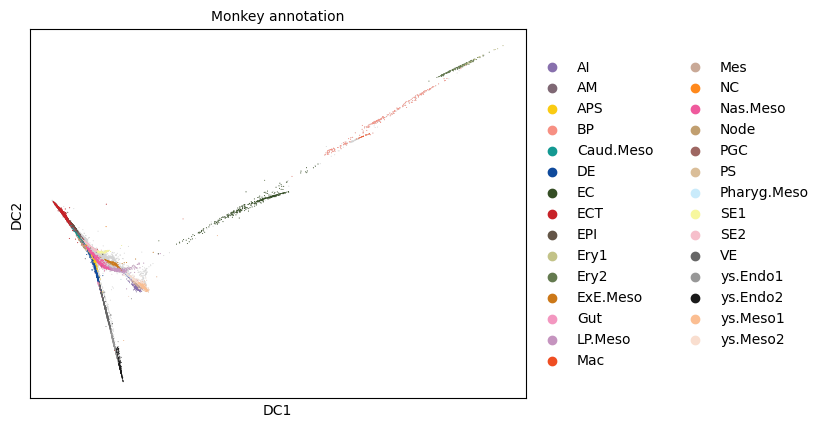

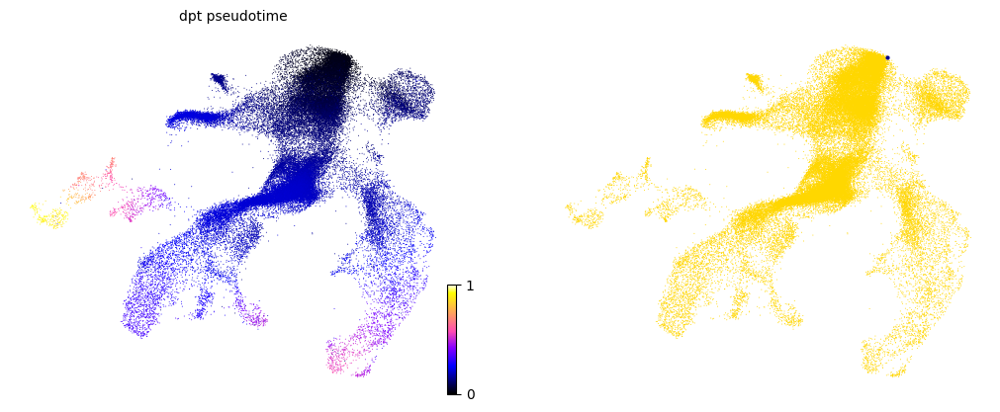

In [ ]:
# Compute joint pseudotime
sc.pp.neighbors(adata_full, use_rep='X_SCANVI', n_neighbors=50)
sc.tl.diffmap(adata_full)
scv.pl.scatter(
    adata_full,
    basis='X_diffmap', 
    color='Monkey annotation',
    components=['1, 2'],
    legend_loc='right',
    frameon=True
)
iroot = adata_full.obsm['X_diffmap'][:, 1].argmin()
adata_full.uns['iroot'] = iroot
sc.tl.dpt(adata_full)
scv.pl.scatter(
    adata_full,
    basis='X_all2monkey',
    color=['dpt_pseudotime', iroot],
    cmap='gnuplot2',
    frameon=False
)

In [ ]:
# Visualize lineage branching
adata_micropattern_meso = adata_micropattern_raw[adata_micropattern_raw.obs['leiden'].str.contains('pluri|PS|Nas|Adv')]
branches = pd.read_csv('./meso_branches_meso_scvi_idse_k_100_34_dcs_8_30_24.csv', index_col = 0)
adata_micropattern_meso.obs['branch_level_1'] = pd.Categorical(branches.iloc[:, 0])
adata_micropattern_meso.obs['branch_level_1'] = adata_micropattern_meso.obs['branch_level_1'].cat.rename_categories(
    [f'b{int(i)}' for i in adata_micropattern_meso.obs['branch_level_1'].cat.categories]
)
adata_micropattern_meso.obs['branch_level_2'] = pd.Categorical(branches.iloc[:, 1])
adata_micropattern_meso.obs['branch_level_2'] = adata_micropattern_meso.obs['branch_level_2'].cat.rename_categories(
    [f'b{int(i)}' for i in adata_micropattern_meso.obs['branch_level_2'].cat.categories]
)
adata_micropattern_meso.obs['branch_level_3'] = pd.Categorical(branches.iloc[:, 2])
adata_micropattern_meso.obs['branch_level_3'] = adata_micropattern_meso.obs['branch_level_3'].cat.rename_categories(
    [f'b{int(i)}' for i in adata_micropattern_meso.obs['branch_level_3'].cat.categories]
)
adata_micropattern_meso.obs['branch_level_4'] = pd.Categorical(branches.iloc[:, 3])
adata_micropattern_meso.obs['branch_level_4'] = adata_micropattern_meso.obs['branch_level_4'].cat.rename_categories(
    [f'b{int(i)}' for i in adata_micropattern_meso.obs['branch_level_4'].cat.categories]
)
adata_micropattern_meso.obs['branch_joint'] = adata_micropattern_meso.obs['branch_level_1'].cat.add_categories(['b4','b6','b100','b395']).cat.remove_categories(['b1','b2'])
adata_micropattern_meso.obs.loc[adata_micropattern_meso.obs['branch_level_2'] == 'b4', 'branch_joint'] = 'b4'
adata_micropattern_meso.obs.loc[adata_micropattern_meso.obs['branch_level_2'] == 'b6', 'branch_joint'] = 'b6'
adata_micropattern_meso.obs.loc[adata_micropattern_meso.obs['branch_level_2'] == 'b100', 'branch_joint'] = 'b100'
adata_micropattern_meso.obs.loc[adata_micropattern_meso.obs['branch_level_3'] == 'b395', 'branch_joint'] = 'b395'
adata_micropattern_raw.obs['branch_joint'] = np.nan
adata_micropattern_raw.obs.loc[adata_micropattern_raw.obs['leiden'].str.contains('pluri|PS|Nas|Adv'), 'branch_joint'] = adata_micropattern_meso.obs['branch_joint']
del adata_micropattern_meso
adata_micropattern_annotated.obs = adata_micropattern_annotated.obs.merge(adata_micropattern_raw.obs[['branch_joint']], left_index = True, right_index = True, how = 'left')
adata_micropattern_annotated.obs['pm'] = adata_micropattern_annotated.obs['branch_joint'].str.contains('b100$|b395$|b3$', na = False)
adata_micropattern_annotated.obs['lpm'] = adata_micropattern_annotated.obs['branch_joint'].str.contains('b100$|b395$|b6$', na = False)
adata_micropattern_annotated.obs['exem'] = adata_micropattern_annotated.obs['branch_joint'].str.contains('b100$|b395$|b4$', na = False)

In [ ]:
adata_micropattern_raw.obs = adata_micropattern_raw.obs.merge(adata_full.obs[['dpt_pseudotime']], left_index = True, right_index = True, how = 'left')

#### Compute pseudotime gene trends

In [ ]:
# Compute pseudotime gene trends for micropattern
def rolling_mean(t, y, w, s, min_n = 50):
    max_t = np.max(t)
    min_t = np.min(t)
    times = []
    means = []
    sds = []
    ts = np.arange(min_t, max_t + s, s)
    for i in range(len(ts)):
        up_bound = ts[i] + w / 2
        low_bound = ts[i] - w / 2
        y_sub = y[np.logical_and(t >= low_bound, t < up_bound)]
        if len(y_sub) < min_n:
            continue
        times.append(ts[i])
        means.append(np.mean(y_sub))
        sds.append(np.std(y_sub))
    return np.array(times), np.array(means), np.array(sds)

def compute_gene_trends(adata, genes, branches):
    trends = {}
    for lineage, branch_labels in branches.items():
        trends[lineage] = {}
        for gene in genes:
            if any(adata.var_names.str.contains(gene)):
                gene_name = adata.var_names[adata.var_names.str.contains(gene)][0]
                expr = adata[:, gene_name].X
                if issparse(expr):
                    expr = expr.toarray()
                else:
                    expr = np.array(expr)
                branch_mask = adata.obs['branch_joint'].isin(branch_labels)
                dpt = adata.obs['dpt_pseudotime'][branch_mask]
                lower_bound = np.percentile(dpt, 2)
                upper_bound = np.percentile(dpt, 99)
                dpt = np.clip(dpt, lower_bound, upper_bound)
                times, means, sds = rolling_mean(dpt, expr[branch_mask], 0.03, 0.001)
                trends[lineage][gene] = {'times': times, 'means': means, 'sds': sds}
    return trends

def plot_gene_trends(trends, ax, lin='PM', max_t=0.21, ymax = 2.5):
    for lineage, genes in trends.items():
        if lineage == lin:  # Only plot for specified lineage
            for gene, data in genes.items():
                sns.lineplot(x=data['times'], y=data['means'], label=f' {gene}', ax=ax, linewidth=5)  # Thicker curves
    ax.set_xlabel('pseudotime', fontsize=50)  # Larger font size for x-axis label, increased padding
    ax.set_ylabel('expression', fontsize=50)  # Larger font size for y-axis label, increased padding
    legend = ax.legend(fontsize=40, frameon=True, fancybox=False, labelspacing=0.1, loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)  # Larger font size for legend, remove background, place to the right, one column
    legend.get_frame().set_edgecolor('black')  # Add square frame to legend
    legend.get_frame().set_linewidth(4)  # Set frame line width
    
    # Make legend key thicker
    for line in legend.get_lines():
        line.set_linewidth(6)  # Set legend key line width
    
    # Customize the plot appearance
    ax.spines['bottom'].set_linewidth(4)
    ax.spines['left'].set_linewidth(4)
    ax.tick_params(axis='both', which='both', direction='in', length=8, width=4, labelsize=50, pad=10)  # Larger font size for ticks, increased padding
    ax.xaxis.set_ticks_position('both')
    ax.yaxis.set_ticks_position('both')
    ax.grid(False)  # Remove grid lines
    ax.spines['top'].set_visible(False)  # Add top frame
    ax.spines['right'].set_visible(False)  # Add right frame
    ax.yaxis.set_ticks_position('left')  # Remove ticks on the right frame
    ax.xaxis.set_ticks_position('bottom')  # Remove ticks on the bottom frame
    
    # Set the same x-axis range for all plots
    ax.set_xlim(0.05, max_t)
    # Relabel x-axis with only 0 and 1
    ax.set_xticks([0.05, max_t])
    ax.set_xticklabels(['0', '1'])
    
    # Set y-axis limit from 0 to the nearest integer larger than the max y value
    max_y = max([max(data['means']) for genes in trends.values() for data in genes.values()])
    ax.set_ylim(0, ymax)
        
    # Only display integer ticks on y-axis
    ax.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
    ax.xaxis.label.set_fontweight('bold')  # Make x-axis label bold
    ax.yaxis.label.set_fontweight('bold')  # Make y-axis label bold
    ax.set_xticklabels(ax.get_xticklabels(), fontweight='bold')  # Make x tick labels bold
    ax.set_yticklabels(ax.get_yticklabels(), fontweight='bold')  # Make y tick labels bold
    
micropattern_branch  = {
    'PM': ['b100', 'b395','b3'],
    'LPM': ['b100', 'b395','b6'],
    'EXEM': ['b100', 'b395','b4']
}
gene_list_1 = ['EVX1', 'MSGN1', 'RSPO3', 'RIPPLY2', 'TBX6', 'FOXC2', 'MESP1', 'MESP2', 'SOX2', 'TBXT']
gene_list_2 = ['FOXF1', 'HAND1', 'NKX2.5', 'MYL4', 'MYL7', 'SOX2', 'TBXT']
gene_list_3 = ['FOXF1', 'HAND1', 'PITX1', 'TBX4', 'MLLT3', 'SOX2', 'TBXT']

trends_1 = compute_gene_trends(adata_micropattern_raw, gene_list_1, micropattern_branch)
trends_2 = compute_gene_trends(adata_micropattern_raw, gene_list_2, micropattern_branch)
trends_3 = compute_gene_trends(adata_micropattern_raw, gene_list_3, micropattern_branch)

#### Gene trends

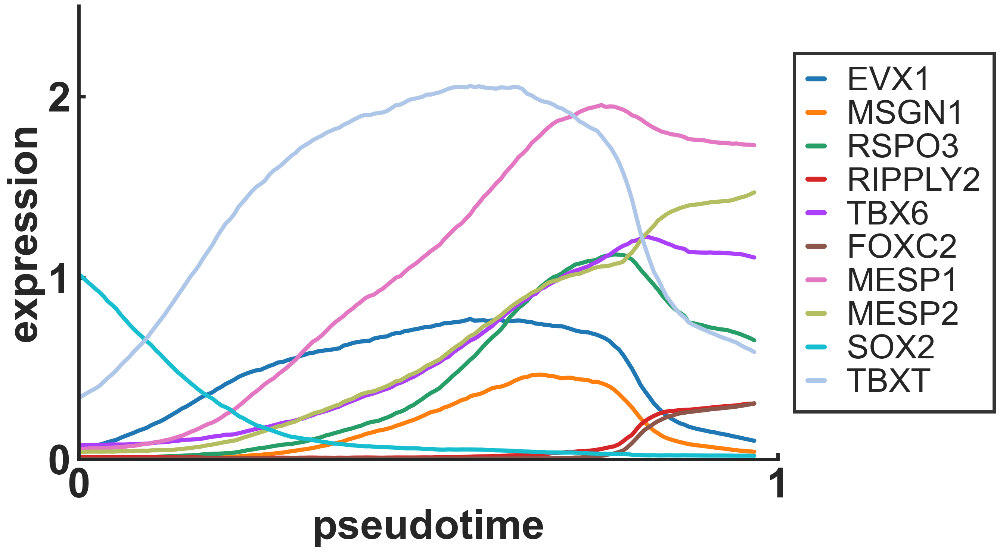

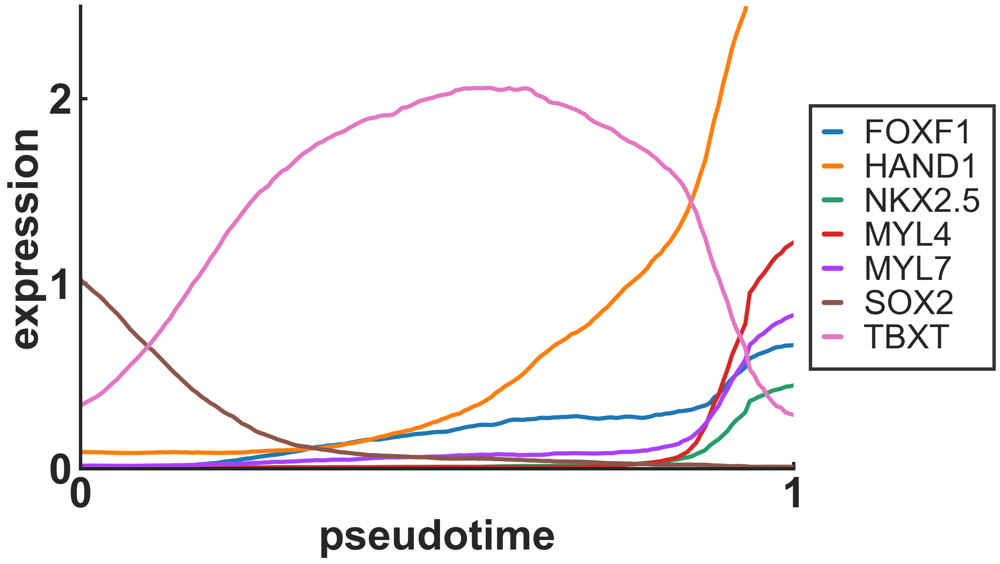

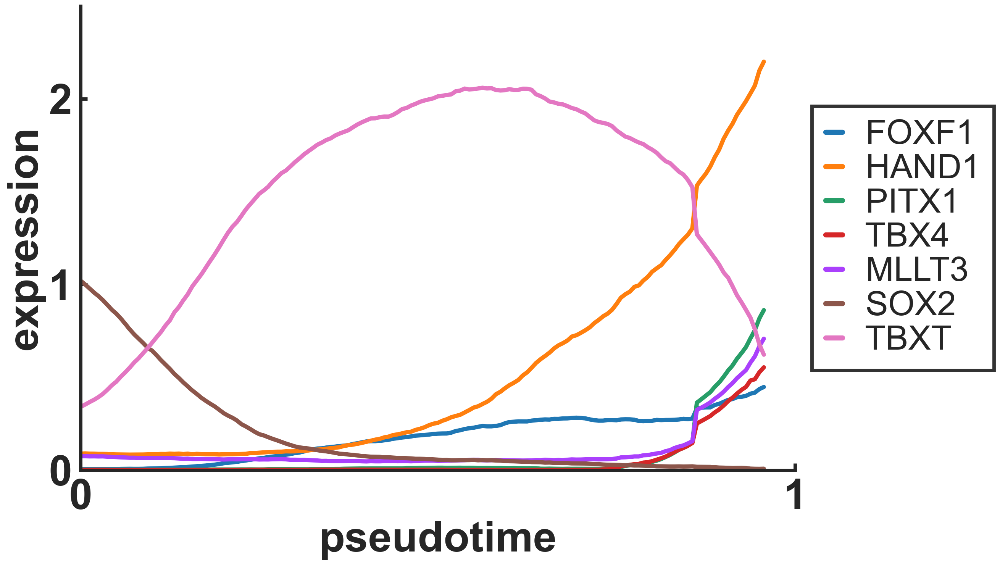

In [ ]:
fig, ax = plt.subplots(figsize=(15, 10))
plot_gene_trends(trends_1, ax, lin='PM', ymax=2.5)
plt.savefig('fig2d_1.pdf', bbox_inches='tight')
fig, ax = plt.subplots(figsize=(15, 10))
plot_gene_trends(trends_2, ax, lin='LPM', ymax=2.5)
plt.savefig('fig2d_2.pdf', bbox_inches='tight')
fig, ax = plt.subplots(figsize=(15, 10))
plot_gene_trends(trends_3, ax, lin='EXEM', ymax=2.5)
plt.savefig('fig2d_3.pdf', bbox_inches='tight')

## Supplementary Figure 2

### Micropattern

In [3]:
# Integrated and processed D2-D4 micropattern adata can be downloaded from GEO with the accession number ?
adata_micropattern_old = sc.read_h5ad('./adata_timeseries_all_cc_hvg1000_leiden10_23_v3.h5ad')
adata_micropattern_old.obs['stage'] = adata_micropattern_old.obs['sample_labels'].replace({
    '48h-1': '48h',
    '48h-2': '48h',
    '72h-1': '72h',
    '72h-2': '72h',
    '96h-1': '96h',
    '96h-2': '96h'
})
for st in ['48h', '72h', '96h']:
    adata_micropattern_old.obs[st] = adata_micropattern_old.obs['leiden_sub']
    adata_micropattern_old.obs.loc[adata_micropattern_old.obs['stage'] != st, st] = np.nan

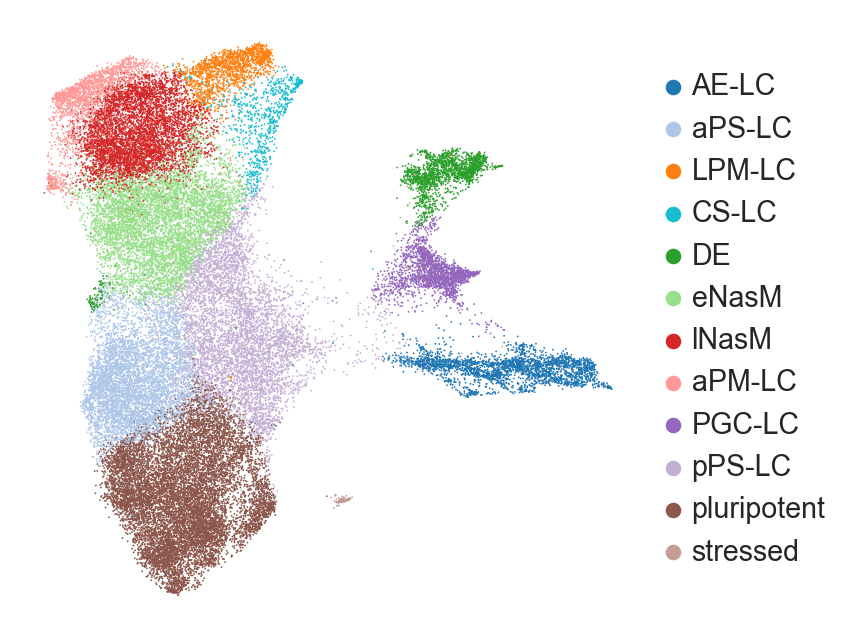

In [5]:
sc.pl.umap(
    adata_micropattern_old,
    color = 'leiden_sub',
    palette = micropattern_cmap,
    frameon = False,
    title = ''
)

In [6]:
# diffusion map
sc.pp.neighbors(adata_micropattern_old, n_neighbors=100, use_rep='X_scVI_cc', method='gauss')
sc.tl.diffmap(adata_micropattern_old)

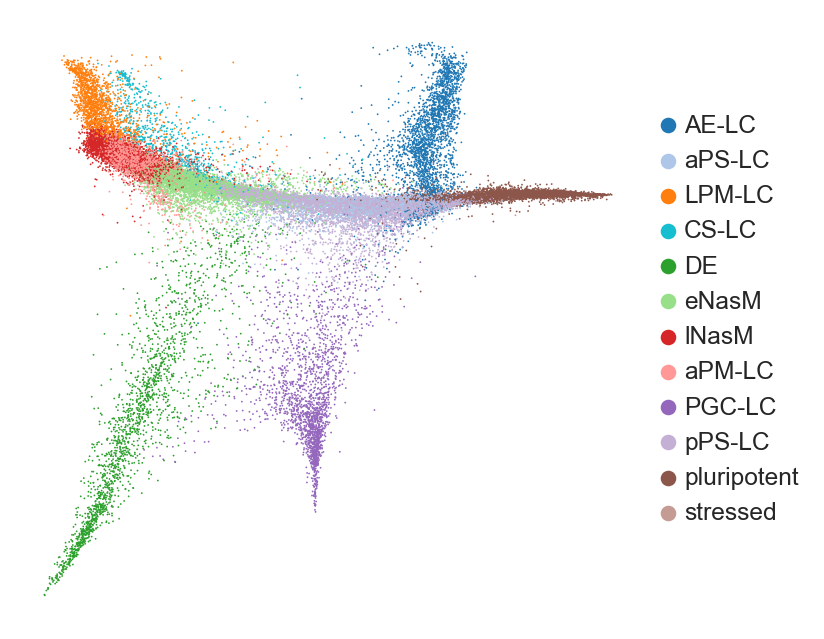

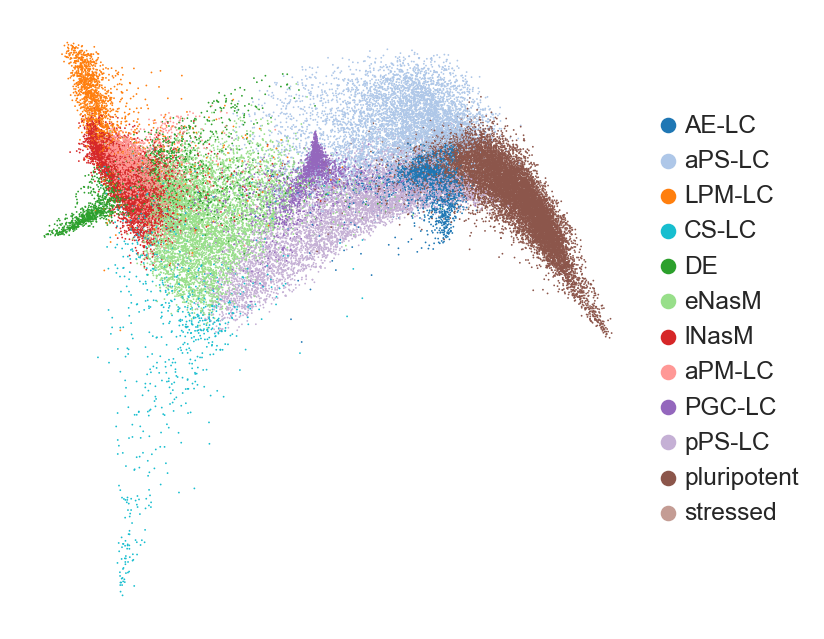

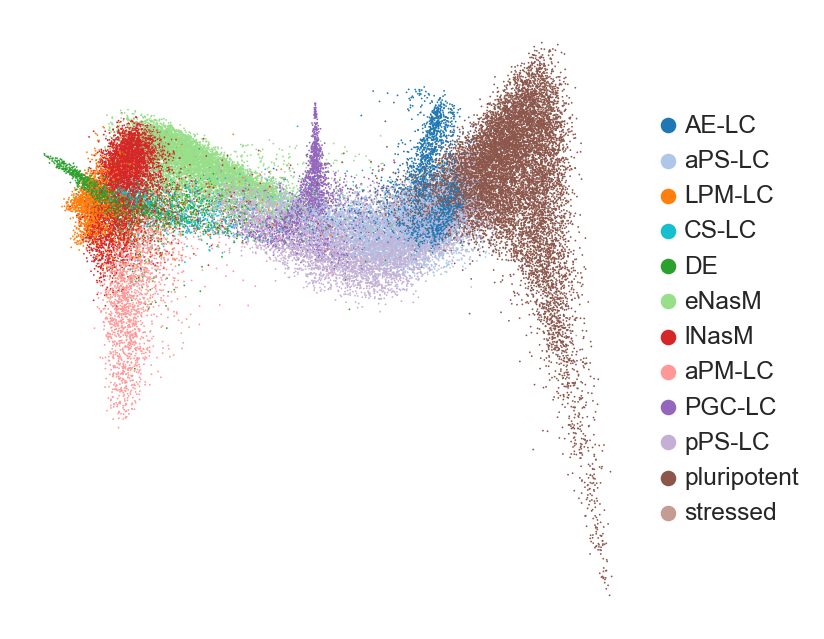

In [18]:
sc.set_figure_params(figsize=(5, 5), format='pdf', vector_friendly=False)
sns.set_theme(style='white')
fnames = ['figS2c_1.pdf', 'figS2c_2.pdf', 'figS2c_3.pdf']
for i, comp in enumerate(["1, 3", "1, 8", "1, 13"]):
    scv.pl.scatter(
        adata_micropattern_old, 
        basis = 'X_diffmap', 
        components = comp, 
        color = 'leiden_sub',
        palette = micropattern_cmap,
        legend_loc = 'right',
        title = '',
        show=False
    )
    plt.savefig(fnames[i], bbox_inches='tight')

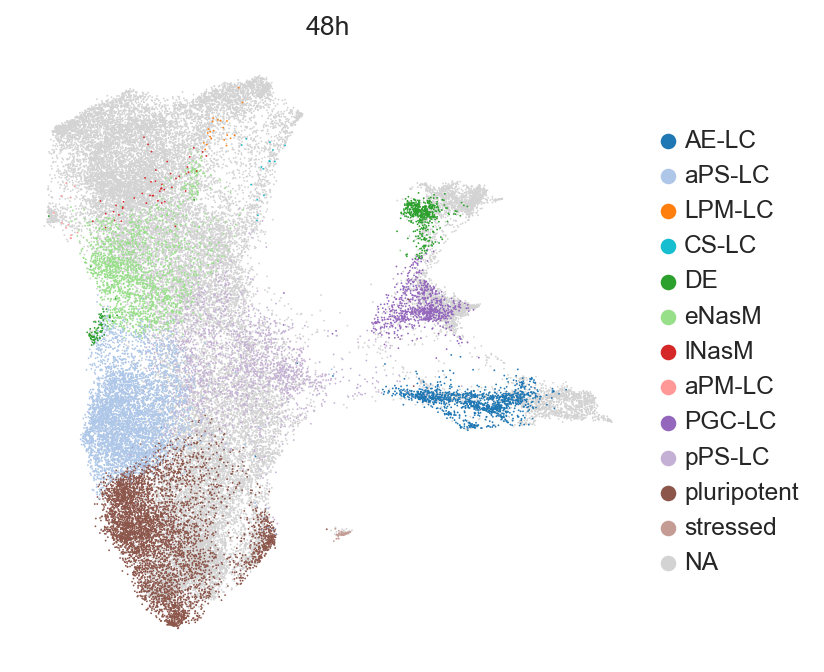

In [22]:
ax = sc.pl.umap(
    adata_micropattern_old,
    color = ['48h'],
    palette = micropattern_cmap,
    frameon = False,
    show=False
)
xlims = ax.get_xlim()
ylims=  ax.get_ylim()

In [25]:
adata_micropattern_old.obs.columns

Index(['sample_labels', 'HMMR (ENSG00000072571)', 'GADD45A (ENSG00000116717)',
       'BUB1 (ENSG00000169679)', 'TFAP2A (ENSG00000137203)',
       'DLGAP5 (ENSG00000126787)', 'SFPQ (ENSG00000116560)',
       'CENPA (ENSG00000115163)', 'ARL6IP1 (ENSG00000170540)',
       'RHOBTB3 (ENSG00000164292)', 'TUBB4B (ENSG00000188229)',
       'HIST1H2AC (ENSG00000180573)', 'CFLAR (ENSG00000003402)',
       'NEK2 (ENSG00000117650)', 'UBE2C (ENSG00000175063)',
       'CALM2 (ENSG00000143933)', 'HMGB2 (ENSG00000164104)',
       'KLF6 (ENSG00000067082)', 'CALD1 (ENSG00000122786)',
       'CDK1 (ENSG00000170312)', 'GAS1 (ENSG00000180447)',
       'RBM8A (ENSG00000265241)', 'HIST1H4C (ENSG00000197061)',
       'MKI67 (ENSG00000148773)', 'KIF23 (ENSG00000137807)',
       'AURKA (ENSG00000087586)', 'KPNA2 (ENSG00000182481)',
       'GCLM (ENSG00000023909)', 'HJURP (ENSG00000123485)',
       'CENPE (ENSG00000138778)', 'TUBA1A (ENSG00000167552)',
       'TOP2A (ENSG00000131747)', 'PLK1 (ENSG00000166851)',

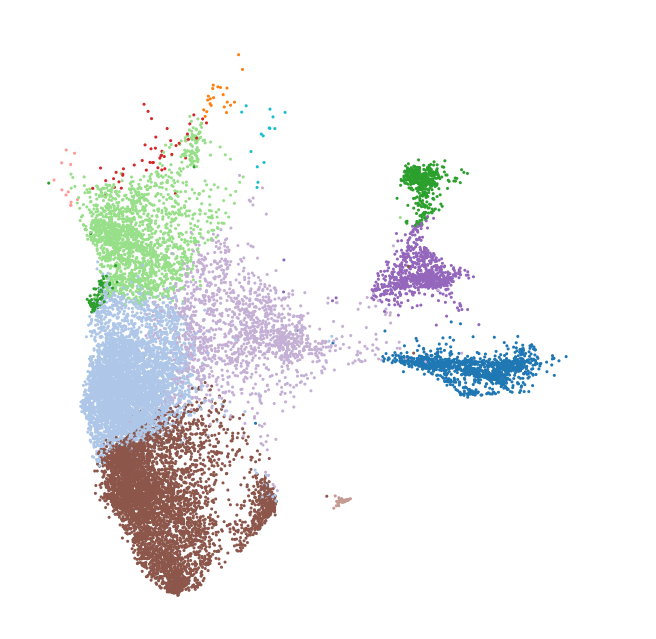

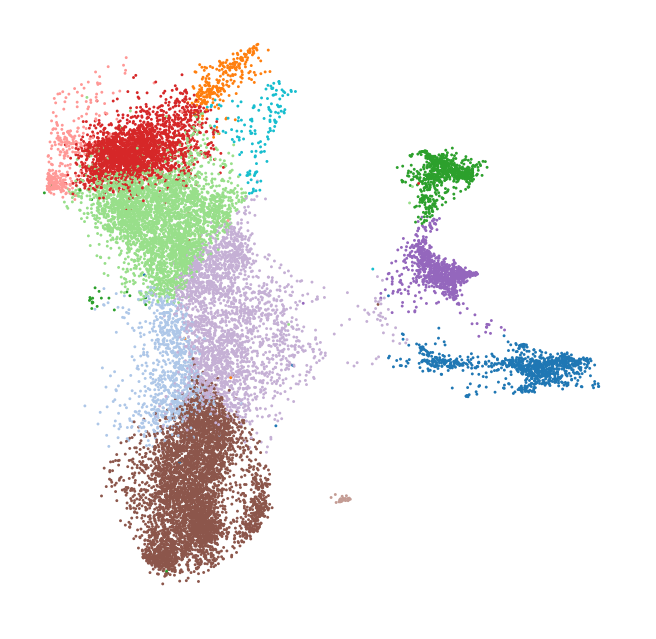

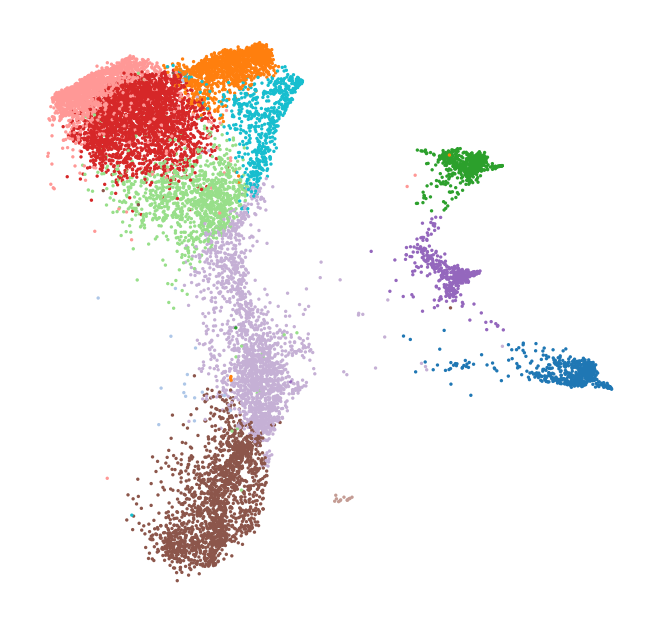

In [30]:
for i, stage in enumerate(['48h', '72h', '96h']):
    ax = sc.pl.umap(
        adata_micropattern_old[adata_micropattern_old.obs['stage'] == stage],
        color = 'leiden_sub',
        palette = micropattern_cmap,
        legend_loc = None,
        frameon = False,
        show=False,
        title=''
    )
    ax.set_xlim(xlims)
    ax.set_ylim(ylims)
    plt.savefig('figS2d_'+ str(i+1) +'.pdf', bbox_inches='tight')

### Monkey

In [2]:
adata_on_monkey = sc.read_h5ad('./adata_integrate_to_monkey.h5ad')
adata_on_monkey = adata_on_monkey.raw.to_adata()
adata_on_monkey_monkey = adata_on_monkey[adata_on_monkey.obs['sample'].str.contains('CS')].copy()
adata_on_monkey_micropattern = adata_on_monkey[~adata_on_monkey.obs['sample'].str.contains('CS|human')].copy()
del adata_on_monkey

# compute magic expression for monkey data
expr_df = adata_on_monkey_monkey.to_df()
for ct in adata_on_monkey_monkey.obs['sample'].cat.categories:
    expr_df_sp = expr_df[adata_on_monkey_monkey.obs['sample'] == ct].copy()
    magic_op = magic.MAGIC(random_state = 1, knn = 5, t = 1)
    expr_df_sub = magic_op.fit_transform(expr_df_sp)
    expr_df_sub = magic_op.transform()
    expr_df.loc[adata_on_monkey_monkey.obs['sample'] == ct] = expr_df_sub
adata_on_monkey_monkey.layers['magic'] = np.array(expr_df)

# compute magic expression for micropattern data
expr_df = adata_on_monkey_micropattern.to_df()
for ct in adata_on_monkey_micropattern.obs['sample'].cat.categories:
    expr_df_sp = expr_df[adata_on_monkey_micropattern.obs['sample'] == ct].copy()
    magic_op = magic.MAGIC(random_state = 1, knn = 5, t = 1)
    expr_df_sub = magic_op.fit_transform(expr_df_sp)
    expr_df_sub = magic_op.transform()
    expr_df.loc[adata_on_monkey_micropattern.obs['sample'] == ct] = expr_df_sub
adata_on_monkey_micropattern.layers['magic'] = np.array(expr_df)

Calculating MAGIC...
  Running MAGIC on 3380 cells and 32056 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 7.00 seconds.
    Calculating KNN search...
    Calculated KNN search in 0.92 seconds.
    Calculating affinities...
    Calculated affinities in 1.01 seconds.
  Calculated graph and diffusion operator in 9.22 seconds.
  Running MAGIC with `solver='exact'` on 32056-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...
  Calculated imputation in 3.23 seconds.
Calculated MAGIC in 12.80 seconds.
Calculating MAGIC...
  Running MAGIC on 7764 cells and 32056 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 15.03 seconds.
    Calculating KNN search...
    Calculated KNN search in 4.96 seconds.
    Calculating affinities...
    Calculated affinities in 4.42 seconds.
  Calculated graph a

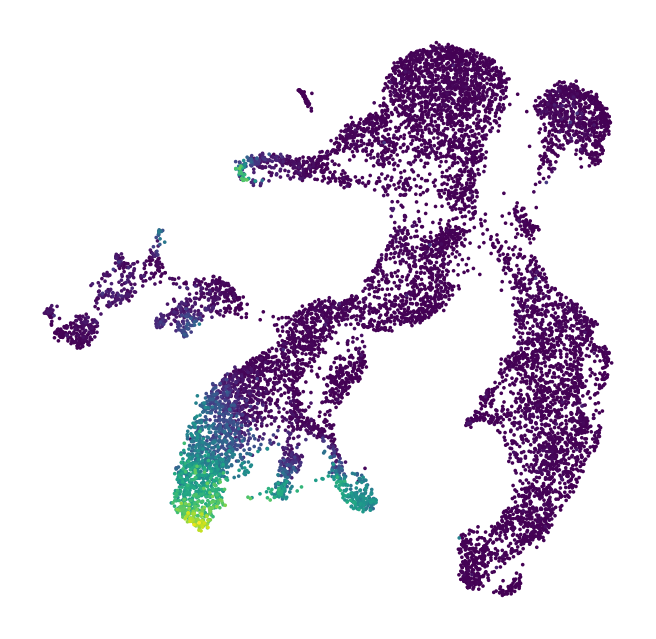

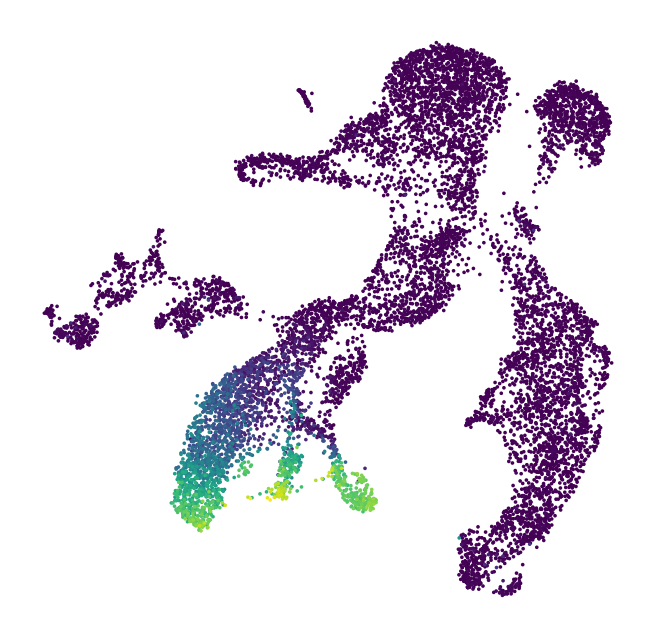

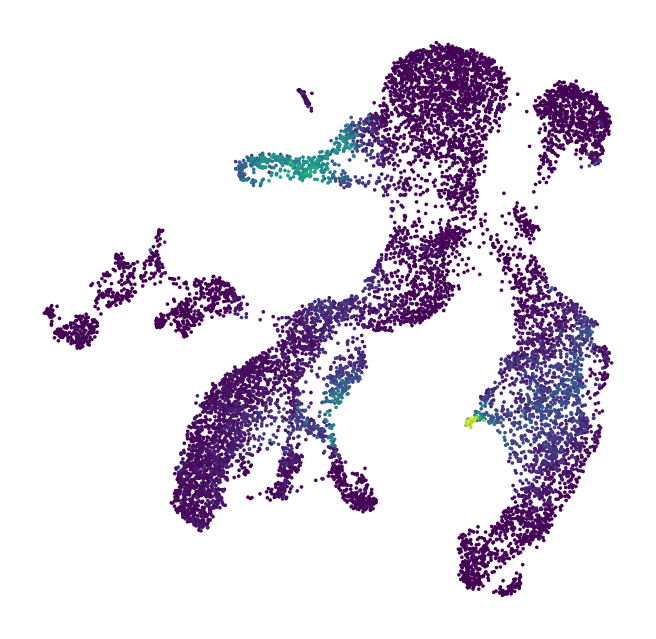

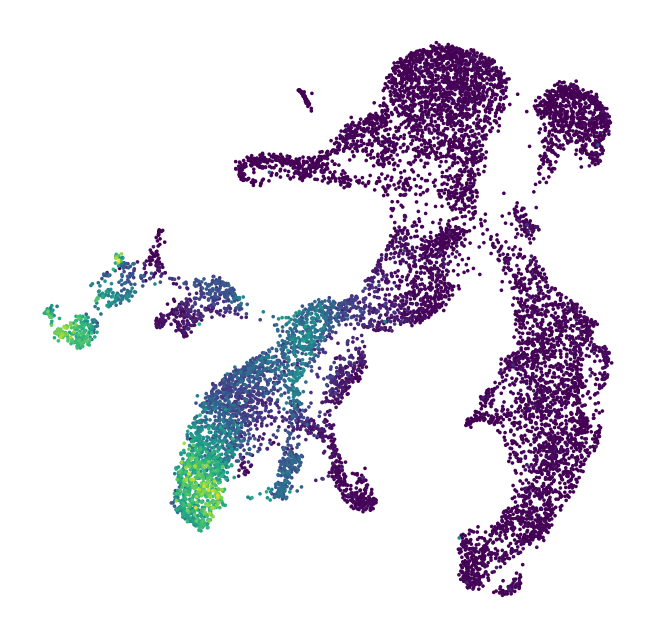

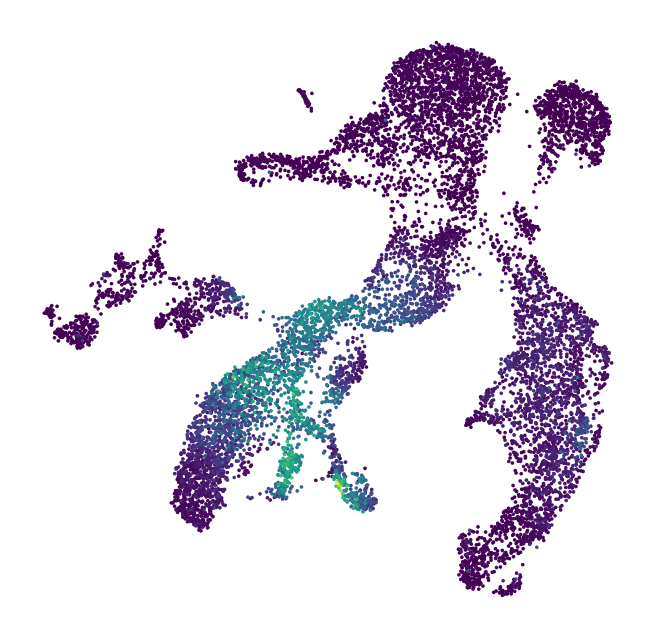

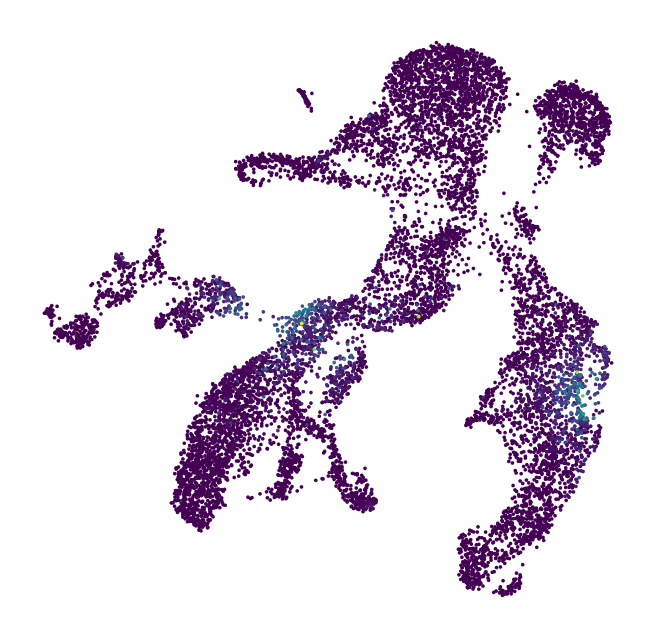

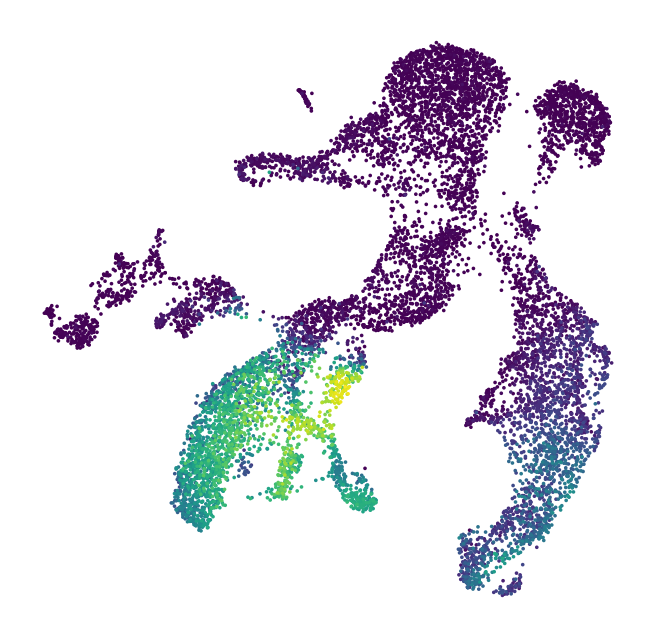

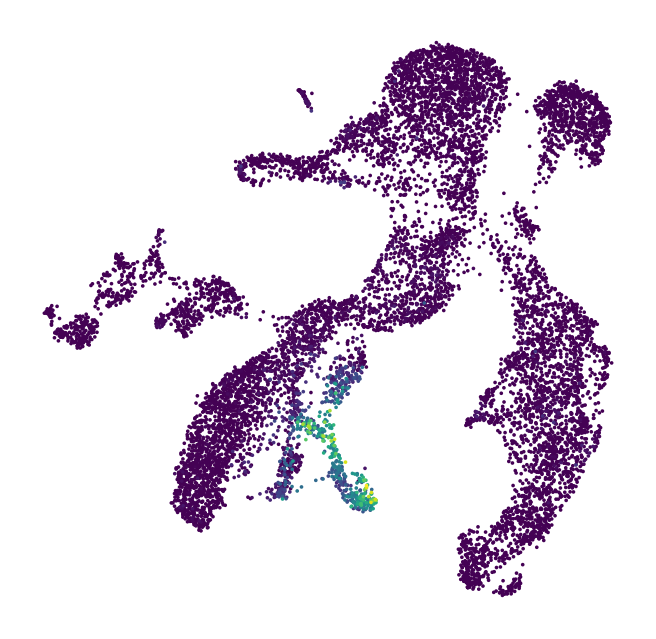

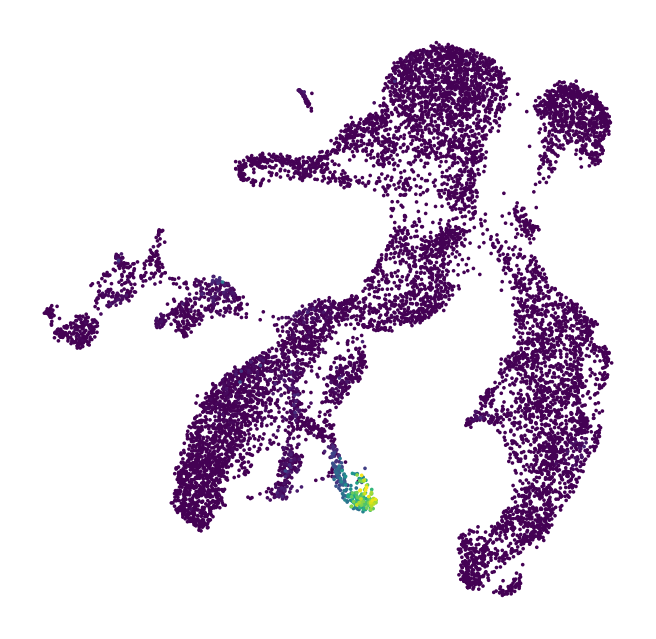

In [7]:
genes_of_interest = ['ANXA1', 'DCN', 'ISL1', 'MYL4', 'MYL7', 'NKX2-5', 'PITX1', 'TBX4', 'TBX5']
sc.set_figure_params(figsize=(5, 5), format='pdf', vector_friendly=False)
for g in genes_of_interest:
    ax = sc.pl.embedding( adata_on_monkey_monkey,
        basis = 'X_all2monkey',
        color = g,
        # ncols = 5,
        layer = 'magic',
        frameon = False,
        cmap = 'viridis',
        colorbar_loc=None,
        title='',
        show=False
    )
    plt.savefig('figS2h_'+g+'.pdf', bbox_inches='tight')

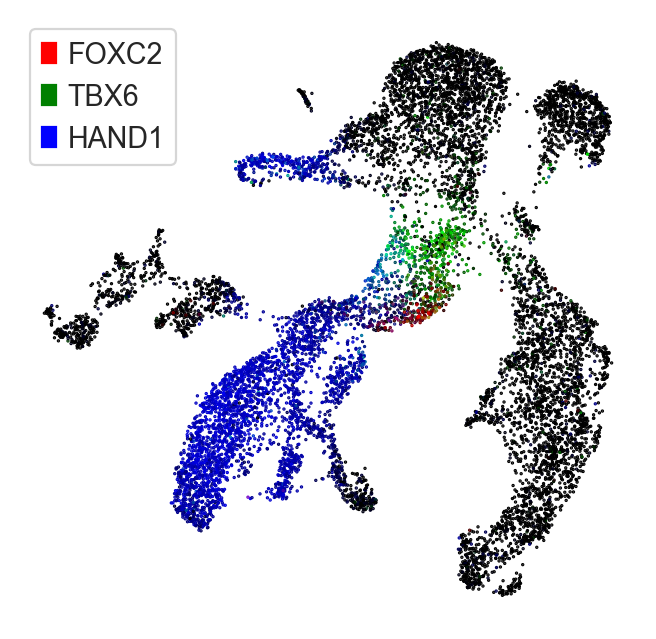

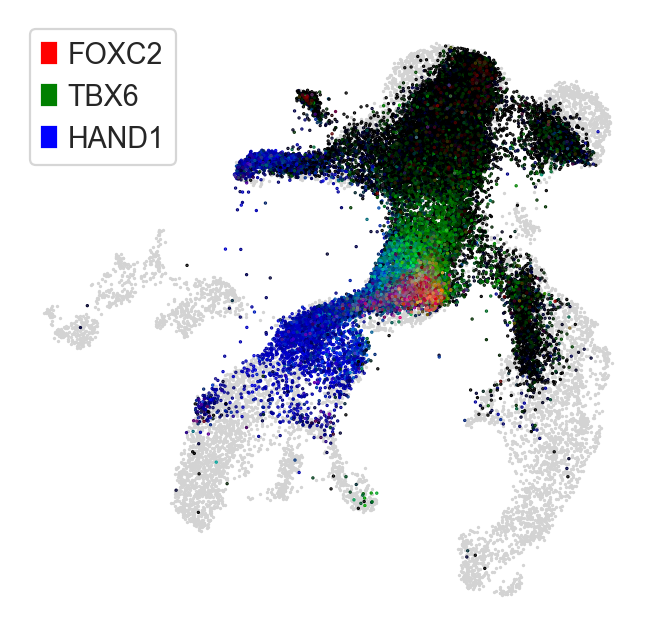

In [10]:
genes_disp = ['FOXC2', 'TBX6', 'HAND1']
legend_handles = [
    patches.Patch(color='red', label='FOXC2'),
    patches.Patch(color='green', label='TBX6'),
    patches.Patch(color='blue', label='HAND1')
]
x = np.array(adata_on_monkey_monkey[:, genes_disp].X.toarray())
permute = x[:, 0].argsort()
y = x / np.max(x, axis=0)
monkey_coords = adata_on_monkey_monkey.obsm['X_all2monkey']
fig, ax = plt.subplots(figsize = (5, 5))
ax.scatter(monkey_coords[permute, 0], monkey_coords[permute, 1], c = y[permute, :], s = 0.25)
ax.legend(handles=legend_handles, loc='upper left')
ax.axis('off')
plt.savefig('figS2j.pdf', bbox_inches='tight')
# ax.set_title('CS8 monkey log1p RGB only')

x = np.array(adata_on_monkey_micropattern[:, genes_disp].X.toarray())
permute = x[:, 0].argsort()
y = x / np.max(x, axis=0)
micropattern_coords = adata_on_monkey_micropattern.obsm['X_all2monkey']
fig, ax = plt.subplots(figsize = (5, 5))
scprep.plot.scatter2d(monkey_coords, c = [0.827, 0.827, 0.827], ticks=False, label_prefix='umap', ax=ax, s=0.25)
ax.scatter(micropattern_coords[permute, 0], micropattern_coords[permute, 1], c = y[permute, :], s = 0.25)
ax.legend(handles=legend_handles, loc='upper left')
ax.axis('off')
# ax.set_title('micropattern D2-D4 log1p RGB overlay monkey CS8')
plt.savefig('figS2k.pdf', bbox_inches='tight')

## Supplementary Figure 8

### Micropattern diffusion map

In [13]:
sc.pp.neighbors(adata_micropattern_full, use_rep = 'X_scvi', method = 'gauss', n_neighbors = 50)
sc.tl.diffmap(adata_micropattern_full)

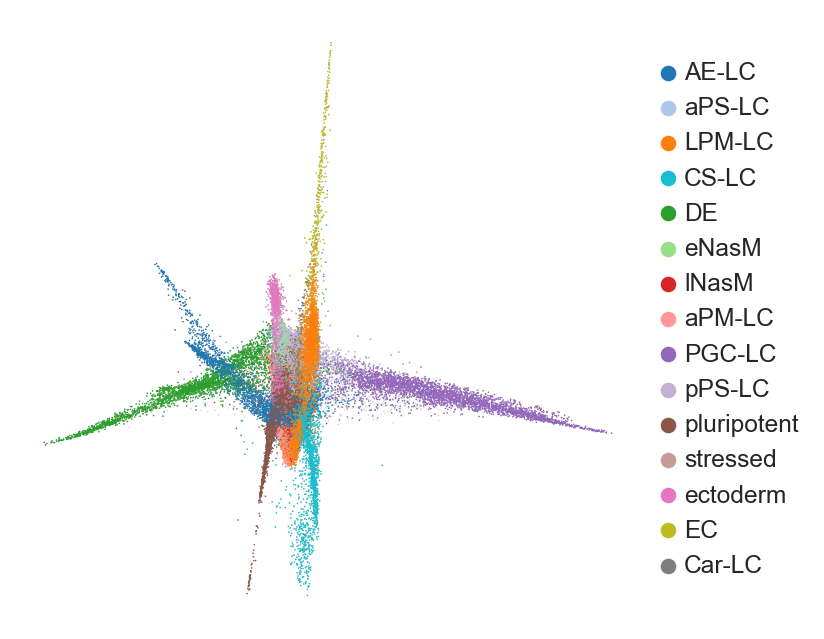

In [29]:
sc.set_figure_params(figsize=(5, 5), format='pdf', vector_friendly=False)
sns.set_theme(style='white')
ax = scv.pl.scatter(
    adata_micropattern_full, 
    basis = 'X_diffmap',
    components = "5, 9", 
    color = 'leiden_sub_sub2',
    palette = micropattern_cmap,
    legend_loc = 'right',
    show=False,
    title=''
)
# Retrieve legend handles and labels
handles, labels = ax.get_legend_handles_labels()
# Remove the old legend
ax.get_legend().remove()
# Add a new legend with 1 column
ax.legend(
    handles, labels, loc="center left", bbox_to_anchor=(1, 0.5), ncol=1, frameon=False
)
plt.savefig('figS8f.pdf', bbox_inches='tight')

### Monkey data integration

In [5]:
# The monkey raw and processed data loaded here can be downloaded from GEO with the accession number GSE193007
monkey_raw = scprep.io.load_10X(
    './GSE193007_MFE-filtered_feature_bc_matrix/filtered_feature_bc_matrix/', 
    gene_labels = 'both', 
    sparse = True
)
monkey_processed = scprep.io.load_mtx(
    './GSE193007_MFE56636-processed/MFE56636MTX/matrix.mtx',
    cell_axis = 'column', 
    sparse = True,
    gene_names = './GSE193007_MFE56636-processed/MFE56636MTX/features.tsv',
    cell_names = './GSE193007_MFE56636-processed/MFE56636MTX/barcodes.tsv'    
)
anndata.AnnData(monkey_processed)
adata_monkey_processed = anndata.AnnData(monkey_processed)
adata_monkey_processed.obs.index = pd.Index([i.split('_')[1] for i in adata_monkey_processed.obs.index])

# handle duplicate genes
genes, counts = np.unique([g.split()[0] for g in monkey_raw.columns], return_counts = True) 
monkey_raw = monkey_raw[monkey_raw.columns.drop(list(monkey_raw.filter(regex = 'TRNA')))]
monkey_raw.columns = pd.Index([g.split()[0] for g in monkey_raw.columns])
adata_monkey_raw = anndata.AnnData(monkey_raw)
del monkey_raw, monkey_processed, genes, counts

# keep the same set of cells as the processed data
adata_monkey_raw = adata_monkey_raw[adata_monkey_processed.obs.index, :].copy()
adata_monkey_raw = adata_monkey_raw[:, list(set(adata_monkey_raw.var_names) & set(adata_monkey_processed.var_names))].copy()
adata_monkey_raw.obs = adata_monkey_processed.obs
meta = pd.read_csv('./GSE193007_MFE56636-processed/MFE56636-meta.csv', index_col = 0) 
meta.index = pd.Index([i.split('_')[1] for i in meta.index])  
monkey_cmap = dict(zip(meta['cell_type'], meta['color']))
adata_monkey_raw.obs = meta
del meta, adata_monkey_processed
adata_monkey_raw.obs.rename(columns = {'sample': 'sample_labels'}, inplace = True)
adata_monkey_raw.obs['sample_labels'] = pd.Categorical(adata_monkey_raw.obs['sample_labels'])

# # normalize data
# adata_monkey_raw.layers['counts'] = adata_monkey_raw.X.copy()
# sc.pp.normalize_total(adata_monkey_raw, target_sum = 1e4)
# sc.pp.log1p(adata_monkey_raw)
# adata_monkey_raw.raw = adata_monkey_raw

# # compute magic expression
# adata_monkey_raw_raw = adata_monkey_raw.raw.to_adata()
# expr_df = adata_monkey_raw_raw.to_df()
# for ct in adata_monkey_raw.obs['sample_labels'].cat.categories:
#     expr_df_sp = expr_df[adata_monkey_raw.obs['sample_labels'] == ct].copy()
#     magic_op = magic.MAGIC(random_state = 1, knn = 5, t = 1)
#     expr_df_sub = magic_op.fit_transform(expr_df_sp)
#     expr_df_sub = magic_op.transform()
#     expr_df.loc[adata_monkey_raw.obs['sample_labels'] == ct] = expr_df_sub
# adata_monkey_raw_raw.layers['magic'] = np.array(expr_df)

In [6]:
# normalize data
adata_monkey_raw.layers['counts'] = adata_monkey_raw.X.copy()
sc.pp.normalize_total(adata_monkey_raw, target_sum = 1e4)
sc.pp.log1p(adata_monkey_raw)
adata_monkey_raw.raw = adata_monkey_raw

# compute magic expression
adata_monkey_raw_raw = adata_monkey_raw.raw.to_adata()
expr_df = adata_monkey_raw_raw.to_df()
for ct in adata_monkey_raw.obs['sample_labels'].cat.categories:
    expr_df_sp = expr_df[adata_monkey_raw.obs['sample_labels'] == ct].copy()
    magic_op = magic.MAGIC(random_state = 1, knn = 5, t = 1)
    expr_df_sub = magic_op.fit_transform(expr_df_sp)
    expr_df_sub = magic_op.transform()
    expr_df.loc[adata_monkey_raw.obs['sample_labels'] == ct] = expr_df_sub
adata_monkey_raw_raw.layers['magic'] = np.array(expr_df)

Calculating MAGIC...
  Running MAGIC on 15044 cells and 21592 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 15.84 seconds.
    Calculating KNN search...
    Calculated KNN search in 21.20 seconds.
    Calculating affinities...
    Calculated affinities in 21.01 seconds.
  Calculated graph and diffusion operator in 58.97 seconds.
  Running MAGIC with `solver='exact'` on 21592-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...
  Calculated imputation in 53.53 seconds.
Calculated MAGIC in 113.63 seconds.
Calculating MAGIC...
  Running MAGIC on 12138 cells and 21592 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 20.32 seconds.
    Calculating KNN search...
    Calculated KNN search in 18.45 seconds.
    Calculating affinities...
    Calculated affinities in 18.22 seconds.
  Calculat

In [20]:
adata_monkey_raw.obsm["X_scanvi_all2monkey"] = model_scanvi.get_latent_representation(adata_monkey_raw)
trans = umap.UMAP(
    n_neighbors = 50, 
    min_dist = 0.5, 
    spread = 1.0, 
    n_components = 2, 
    negative_sample_rate = 5, 
    random_state = 5
).fit(adata_monkey_raw.obsm["X_scanvi_all2monkey"])
adata_monkey_raw.obsm['X_umap_all2monkey_scanvi'] = trans.transform(adata_monkey_raw.obsm['X_scanvi_all2monkey'])
adata_monkey_raw_raw.obsm['X_umap_all2monkey_scanvi'] = adata_monkey_raw.obsm['X_umap_all2monkey_scanvi']

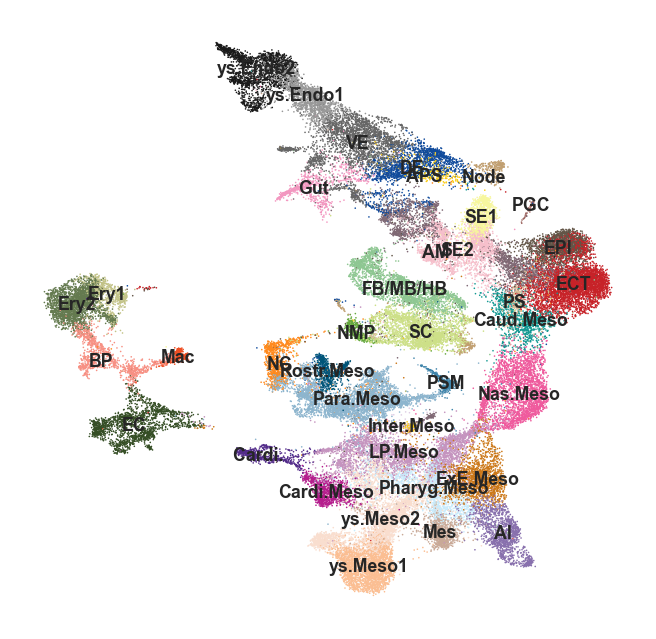

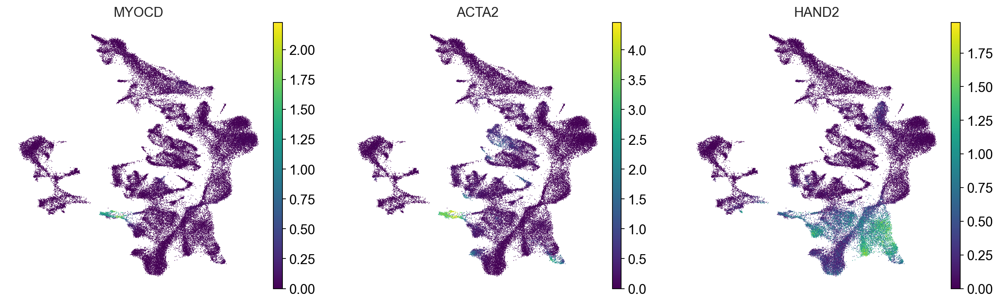

In [21]:
sc.set_figure_params(format='pdf', vector_friendly=False, figsize=(5,5))
sc.pl.embedding(
    adata_monkey_raw,
    basis = 'X_umap_all2monkey_scanvi',
    frameon = False,
    color = 'cell_type',
    palette = monkey_cmap,
    title = '',
    legend_loc = 'on data',
    legend_fontsize = 8,
    save='figS8h_1.pdf'
)
sc.pl.embedding(
    adata_monkey_raw_raw,
    basis = 'X_umap_all2monkey_scanvi',
    frameon = False,
    color = ['MYOCD', 'ACTA2', 'HAND2'],
    layer = 'magic',
    legend_loc = 'on data',
    legend_fontsize = 8,
    cmap = 'viridis',
     save='figS8h_2-4.pdf'
)